In [ ]:
# Leer el archivo Excel
import pandas as pd
datos_pf2 = pd.read_excel('datos_pf2.xlsx')

# Modelos

## Lstm

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import pandas as pd

# Crear lags de la variable objetivo 'Velocidad'

datos_pf2 = pd.read_excel('datos_pf2.xlsx')

num_lags_y = 24  # Número de lags de Y que quieres incluir
for lag in range(1, num_lags_y + 1):
    datos_pf2[f'Y_lag_{lag}'] = datos_pf2['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
datos_pf2 = datos_pf2.tail(10000)

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = datos_pf2.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = datos_pf2['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para LSTM en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo LSTM
model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(1, X_train.shape[1])))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Definir el callback EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entrenar el modelo con EarlyStopping
history = model.fit(X_train_reshaped, Y_train, epochs=50, batch_size=10, validation_data=(X_test_reshaped, Y_test), callbacks=[early_stopping], verbose=1)

# Hacer predicciones
Y_pred_scaled = model.predict(X_test_reshaped)

# Desescalar las predicciones y las etiquetas reales
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular el MAE
mae = mean_absolute_error(Y_test_descaled, Y_pred)
print(f'Error absoluto medio (MAE): {mae}')


Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


800/800 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.0156 - val_loss: 0.0073
Epoch 2/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0080 - val_loss: 0.0075
Epoch 3/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0081 - val_loss: 0.0072
Epoch 4/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0076 - val_loss: 0.0071
Epoch 5/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0077 - val_loss: 0.0071
Epoch 6/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0080 - val_loss: 0.0074
Epoch 7/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0079 - val_loss: 0.0073
Epoch 8/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0078 - val_loss: 0.0071
Epoch 9/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0077 - val_loss: 0.0070
Epoch 10/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0074 - val_loss: 0.0076
Epoch 11/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0076 - val_loss: 0.0070
Epoch 12/50
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import Huber
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import pandas as pd

# Supongamos que tienes tu DataFrame `data_lagged_clean` con las características (X) y la variable objetivo 'Velocidad'
datos_pf2 = pd.read_excel('datos_pf2.xlsx')

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

best_mae = float('inf')
best_params = {}

# Definir los valores para num_lags_y y otros hiperparámetros
num_lags_y_list = list(range(12, 49, 12))  # Múltiplos de 12 desde 12 hasta 48
lstm_units_list = [50, 100]  # Número de unidades en la capa LSTM
optimizers_list = ['adam', 'rmsprop']  # Lista de optimizadores

# Iterar sobre los valores de los hiperparámetros
for num_lags_y in num_lags_y_list:
    for lstm_units in lstm_units_list:
        for optimizer in optimizers_list:
            # Crear lags de la variable objetivo 'Velocidad'
            data_lagged = datos_pf2.copy()
            for lag in range(1, num_lags_y + 1):
                data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

            # Eliminar las filas con valores NaN después de crear los lags de Y
            data_lagged = data_lagged.tail(10000)

            # Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
            X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
            Y = data_lagged['Velocidad'].values  # Variable objetivo

            # Escalar los datos
            X_scaled = scaler_X.fit_transform(X)
            Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

            # Dividir los datos en conjuntos de entrenamiento y prueba
            split_index = int(0.8 * len(X_scaled))
            X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
            Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

            # Preparar los datos para LSTM en formato 3D: (n_samples, timesteps=1, n_features)
            X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            # Definir el modelo LSTM
            model = Sequential()
            model.add(LSTM(lstm_units, activation='relu', input_shape=(1, X_train.shape[1])))
            model.add(Dense(1))
            model.compile(optimizer=optimizer, loss=Huber())

            # Definir el callback EarlyStopping
            early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

            # Entrenar el modelo con EarlyStopping
            history = model.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                                validation_data=(X_test_reshaped, Y_test),
                                callbacks=[early_stopping], verbose=0)

            # Hacer predicciones y calcular el MAE
            Y_pred_scaled = model.predict(X_test_reshaped)
            Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
            Y_test_descaled = scaler_Y.inverse_transform(Y_test)

            mae = mean_absolute_error(Y_test_descaled, Y_pred)

            # Guardar los mejores hiperparámetros si se encuentra un mejor MAE
            if mae < best_mae:
                best_mae = mae
                best_params = {
                    'num_lags_y': num_lags_y,
                    'lstm_units': lstm_units,
                    'optimizer': optimizer,
                    'loss_function': 'Huber',
                    'mae': mae
                }

# Imprimir los mejores hiperparámetros y el MAE
print("Mejores hiperparámetros encontrados:")
print(best_params)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Mejores hiperparámetros encontrados:
{'num_lags_y': 36, 'lstm_units': 100, 'optimizer': 'adam', 'loss_function': 'Huber', 'mae': 0.5650939422905444}


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.0073 - val_loss: 0.0037
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0041 - val_loss: 0.0039
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0037
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0036
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0037 - val_loss: 0.0035
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0035
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0036
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0035
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0037 - val_loss: 0.0035
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━

Modelo guardado como 'modelo_lstm_mejorado.h5'
63/63 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step
Error absoluto medio (MAE): 0.566451474404335


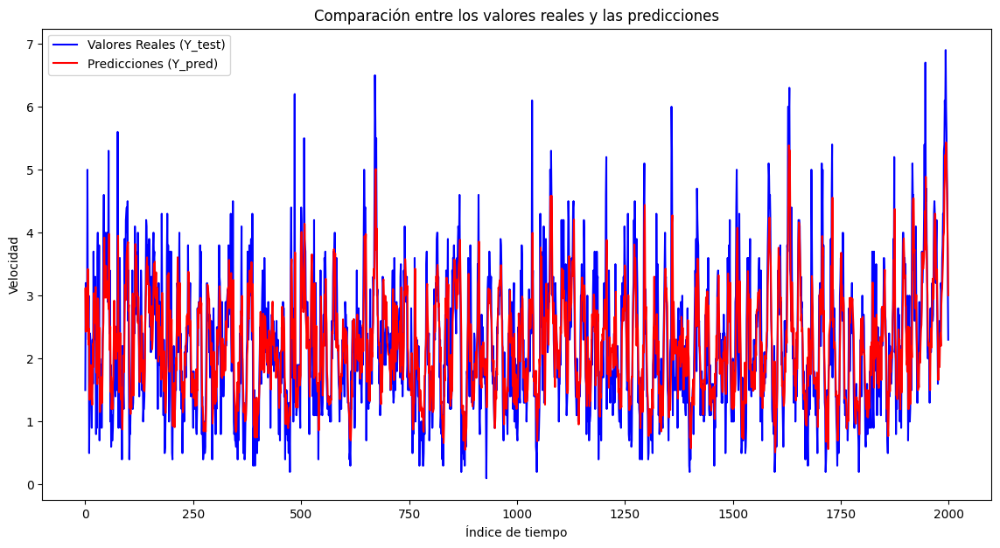

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import Huber
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

# Crear lags de la variable objetivo 'Velocidad' con los mejores parámetros
num_lags_y = 36  # Mejor número de lags
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000)

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para LSTM en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo LSTM con los mejores hiperparámetros
model_lstm = Sequential()
model_lstm.add(LSTM(100, activation='relu', input_shape=(1, X_train.shape[1])))  # lstm_units=100
model_lstm.add(Dense(1))
model_lstm.compile(optimizer='adam', loss=Huber())  # optimizer='adam', loss_function='Huber'

# Definir el callback EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entrenar el modelo con EarlyStopping
history = model_lstm.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                    validation_data=(X_test_reshaped, Y_test),
                    callbacks=[early_stopping], verbose=1)

# Guardar el modelo en formato h5
model_lstm.save('modelo_lstm_mejorado.h5')
print("Modelo guardado como 'modelo_lstm_mejorado.h5'")

# Hacer predicciones y desescalar
Y_pred_scaled = model_lstm.predict(X_test_reshaped)
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular el MAE
mae_lstm = mean_absolute_error(Y_test_descaled, Y_pred)
print(f'Error absoluto medio (MAE): {mae_lstm}')

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')
plt.title('Comparación entre los valores reales y las predicciones')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 0.0071 - val_loss: 0.0037
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0040 - val_loss: 0.0035
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0041 - val_loss: 0.0036
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0036
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0037
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0035
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0037 - val_loss: 0.0035
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0037
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0035
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0038
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━

Modelo guardado como 'modelo_lstm_mejorado.h5'
63/63 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step
Error absoluto medio (MAE): 0.5688716813206672
Error cuadrático medio (RMSE): 0.7499849258560963
Error cuadrático medio normalizado (NRMSE): 0.11029190086119062


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


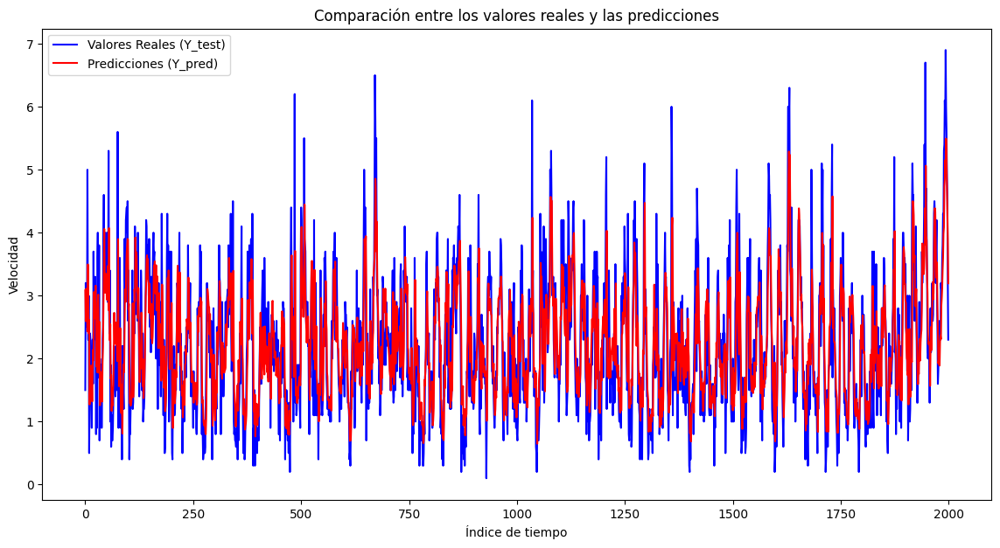

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import Huber
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

# Crear lags de la variable objetivo 'Velocidad' con los mejores parámetros
num_lags_y = 36  # Mejor número de lags
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000).dropna()

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para LSTM en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo LSTM con los mejores hiperparámetros
model_lstm = Sequential()
model_lstm.add(LSTM(100, activation='relu', input_shape=(1, X_train.shape[1])))  # lstm_units=100
model_lstm.add(Dense(1))
model_lstm.compile(optimizer='adam', loss=Huber())  # optimizer='adam', loss_function='Huber'

# Definir el callback EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entrenar el modelo con EarlyStopping
history = model_lstm.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                         validation_data=(X_test_reshaped, Y_test),
                         callbacks=[early_stopping], verbose=1)

# Guardar el modelo en formato h5
model_lstm.save('modelo_lstm_mejorado.h5')
print("Modelo guardado como 'modelo_lstm_mejorado.h5'")

# Hacer predicciones y desescalar
Y_pred_scaled = model_lstm.predict(X_test_reshaped)
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular el MAE
mae_lstm = mean_absolute_error(Y_test_descaled, Y_pred)

# Calcular el RMSE
rmse_lstm = mean_squared_error(Y_test_descaled, Y_pred, squared=False)

# Calcular el NRMSE
nrmse_lstm = rmse_lstm / (Y_test_descaled.max() - Y_test_descaled.min())

# Imprimir resultados
print(f'Error absoluto medio (MAE): {mae_lstm}')
print(f'Error cuadrático medio (RMSE): {rmse_lstm}')
print(f'Error cuadrático medio normalizado (NRMSE): {nrmse_lstm}')

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')
plt.title('Comparación entre los valores reales y las predicciones')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


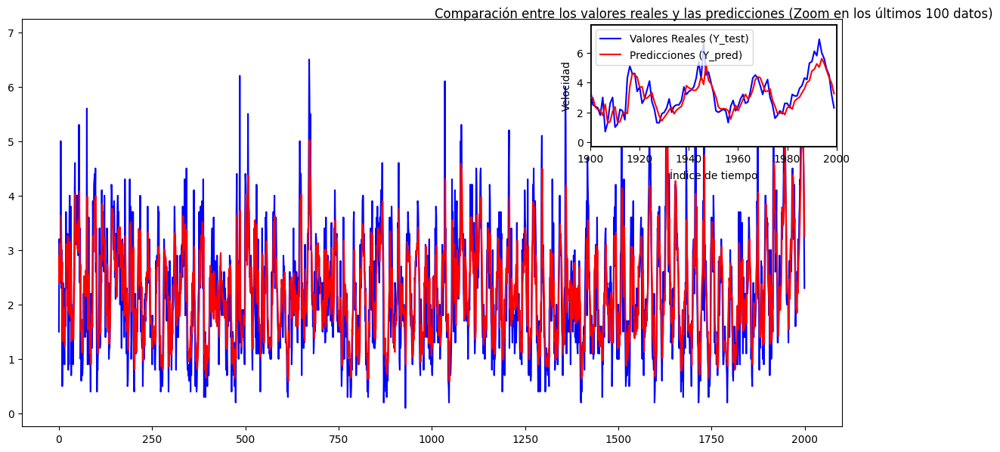

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')

# Crear el área de zoom para los últimos 100 puntos
axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")  # Crear un zoom en la esquina superior derecha
axins.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
axins.plot(Y_pred, label='Predicciones (Y_pred)', color='red')

# Limitar la visualización al zoom (últimos 100 datos)
axins.set_xlim(len(Y_test_descaled) - 100, len(Y_test_descaled))  # Últimos 100 datos
axins.set_ylim(min(Y_test_descaled[-100:].min(), Y_pred[-100:].min()) - 1,
               max(Y_test_descaled[-100:].max(), Y_pred[-100:].max()) + 1)

# Agregar un marco que conecta el zoom con la gráfica principal
mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

# Ajustes para la gráfica principal
plt.title('Comparación entre los valores reales y las predicciones (Zoom en los últimos 100 datos)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()

plt.show()


## RNN

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


800/800 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.0281 - val_loss: 0.0080
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0088 - val_loss: 0.0072
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0080 - val_loss: 0.0104
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0082 - val_loss: 0.0084
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0082 - val_loss: 0.0084
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0077 - val_loss: 0.0070
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0078 - val_loss: 0.0078
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0078 - val_loss: 0.0099
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0077 - val_loss: 0.0072
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0077 - val_loss: 0.0070
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0077 - val_loss: 0.0070
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step

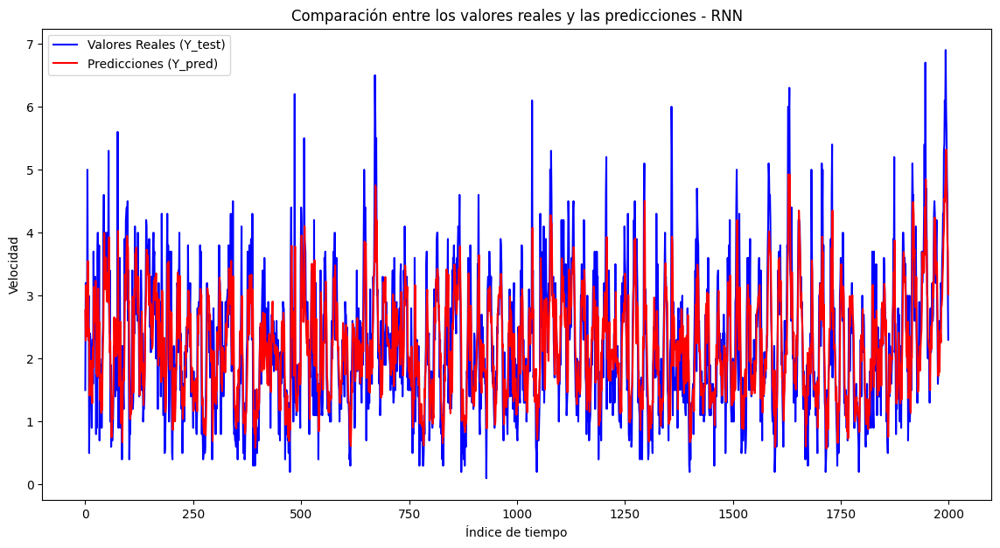

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, Dense
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Supongamos que tienes tu DataFrame `data_lagged_clean` con las características (X) y la variable objetivo 'Velocidad'

# Crear lags de la variable objetivo 'Velocidad'
num_lags_y = 36  # Por ejemplo, 36 lags para este caso
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000)

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para RNN en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo RNN simple
model = Sequential()
model.add(SimpleRNN(50, activation='relu', input_shape=(1, X_train.shape[1])))  # 50 unidades en la capa RNN
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Definir el callback EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entrenar el modelo con EarlyStopping
history = model.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                    validation_data=(X_test_reshaped, Y_test),
                    callbacks=[early_stopping], verbose=1)

# Hacer predicciones y desescalar
Y_pred_scaled = model.predict(X_test_reshaped)
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular el MAE
mae = mean_absolute_error(Y_test_descaled, Y_pred)
print(f'Error absoluto medio (MAE): {mae}')

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')
plt.title('Comparación entre los valores reales y las predicciones - RNN')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import Huber
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import pandas as pd

# Supongamos que tienes tu DataFrame `data_lagged_clean` con las características (X) y la variable objetivo 'Velocidad'

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

best_mae = float('inf')
best_params = {}

# Definir los valores para num_lags_y y otros hiperparámetros
num_lags_y_list = list(range(12, 49, 12))  # Múltiplos de 12 desde 12 hasta 48
rnn_units_list = [50, 100]  # Número de unidades en la capa RNN
optimizers_list = ['adam', 'rmsprop']  # Lista de optimizadores

# Iterar sobre los valores de los hiperparámetros
for num_lags_y in num_lags_y_list:
    for rnn_units in rnn_units_list:
        for optimizer in optimizers_list:
            # Crear lags de la variable objetivo 'Velocidad'
            data_lagged = datos_pf2.copy()
            for lag in range(1, num_lags_y + 1):
                data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

            # Eliminar las filas con valores NaN después de crear los lags de Y
            data_lagged = data_lagged.tail(10000)

            # Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
            X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
            Y = data_lagged['Velocidad'].values  # Variable objetivo

            # Escalar los datos
            X_scaled = scaler_X.fit_transform(X)
            Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

            # Dividir los datos en conjuntos de entrenamiento y prueba
            split_index = int(0.8 * len(X_scaled))
            X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
            Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

            # Preparar los datos para RNN en formato 3D: (n_samples, timesteps=1, n_features)
            X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            # Definir el modelo RNN simple
            model = Sequential()
            model.add(SimpleRNN(rnn_units, activation='relu', input_shape=(1, X_train.shape[1])))
            model.add(Dense(1))
            model.compile(optimizer=optimizer, loss=Huber())

            # Definir el callback EarlyStopping
            early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

            # Entrenar el modelo con EarlyStopping
            history = model.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                                validation_data=(X_test_reshaped, Y_test),
                                callbacks=[early_stopping], verbose=0)

            # Hacer predicciones y calcular el MAE
            Y_pred_scaled = model.predict(X_test_reshaped)
            Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
            Y_test_descaled = scaler_Y.inverse_transform(Y_test)

            mae = mean_absolute_error(Y_test_descaled, Y_pred)

            # Guardar los mejores hiperparámetros si se encuentra un mejor MAE
            if mae < best_mae:
                best_mae = mae
                best_params = {
                    'num_lags_y': num_lags_y,
                    'rnn_units': rnn_units,
                    'optimizer': optimizer,
                    'loss_function': 'Huber',
                    'mae': mae
                }

# Imprimir los mejores hiperparámetros y el MAE
print("Mejores hiperparámetros encontrados:")
print(best_params)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
Mejores hiperparámetros encontrados:
{'num_lags_y': 36, 'rnn_units': 50, 'optimizer': 'adam', 'loss_function': 'Huber', 'mae': 0.5664174007534981}


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


800/800 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.0068 - val_loss: 0.0068
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0043 - val_loss: 0.0044
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0041 - val_loss: 0.0036
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0035
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0040 - val_loss: 0.0036
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0040
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0040 - val_loss: 0.0035
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0040 - val_loss: 0.0038
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0035
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0035
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0041
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step

Modelo guardado como 'modelo_rnn_mejorado.h5'
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
Error absoluto medio (MAE): 0.5730527499973774


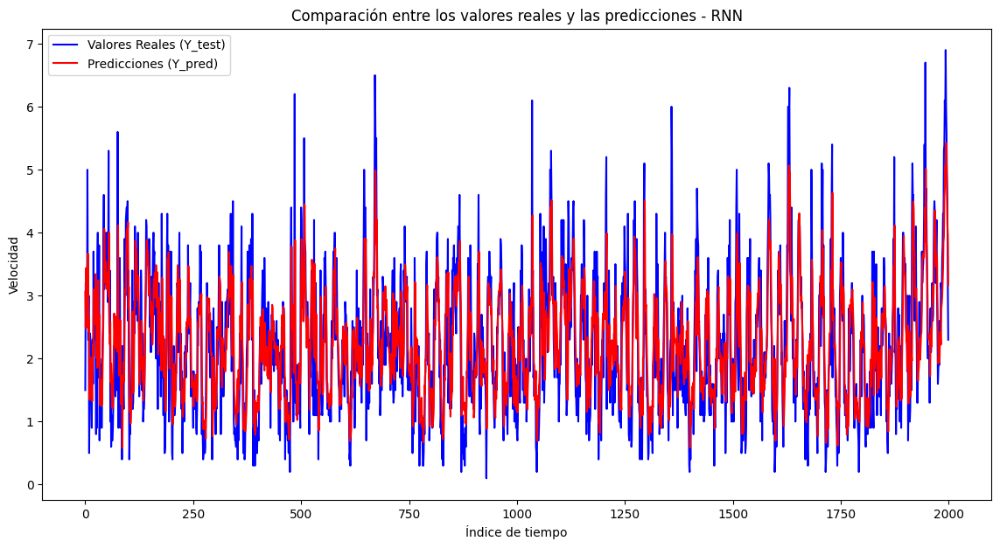

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import Huber
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Crear lags de la variable objetivo 'Velocidad' con los mejores parámetros
num_lags_y = 36  # Mejor número de lags encontrado
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000)

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para RNN en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo RNN con los mejores hiperparámetros
model_rnn = Sequential()
model_rnn.add(SimpleRNN(50, activation='relu', input_shape=(1, X_train.shape[1])))  # rnn_units=50
model_rnn.add(Dense(1))
model_rnn.compile(optimizer='adam', loss=Huber())  # optimizer='adam', loss_function='Huber'

# Definir el callback EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entrenar el modelo con EarlyStopping
history = model_rnn.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                    validation_data=(X_test_reshaped, Y_test),
                    callbacks=[early_stopping], verbose=1)

# Guardar el modelo en formato h5
model_rnn.save('modelo_rnn_mejorado.h5')
print("Modelo guardado como 'modelo_rnn_mejorado.h5'")

# Hacer predicciones y desescalar
Y_pred_scaled = model_rnn.predict(X_test_reshaped)
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular el MAE
mae_rnn = mean_absolute_error(Y_test_descaled, Y_pred)
print(f'Error absoluto medio (MAE): {mae_rnn}')

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')
plt.title('Comparación entre los valores reales y las predicciones - RNN')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


800/800 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.0112 - val_loss: 0.0038
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0040 - val_loss: 0.0044
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0040 - val_loss: 0.0040
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0040 - val_loss: 0.0036
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0036
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0035
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step

Modelo guardado como 'modelo_rnn_mejorado.h5'
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
Error absoluto medio (MAE): 0.5734530934482812
Error cuadrático medio (RMSE): 0.7572332900483326
Error cuadrático medio normalizado (NRMSE): 0.1113578367718136


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


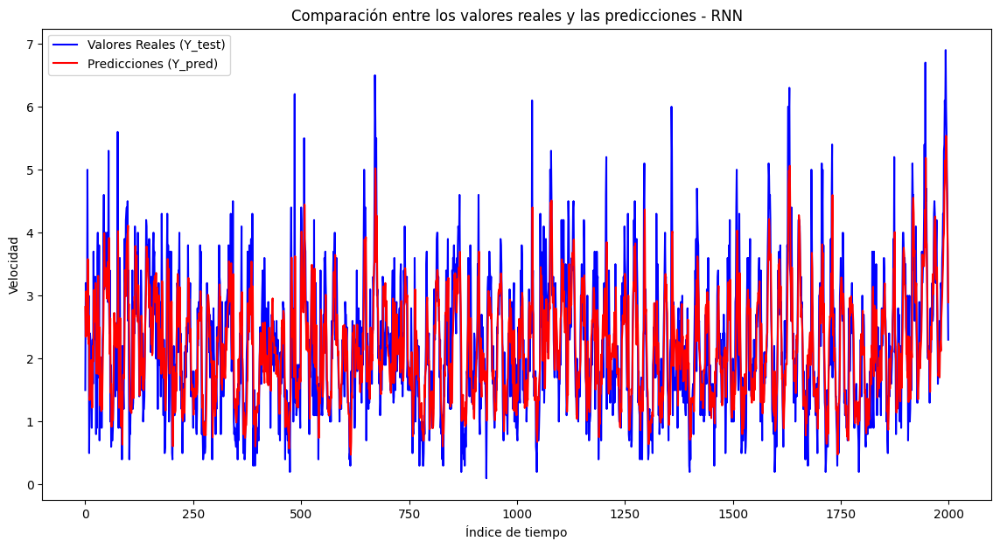

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import Huber
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt

# Crear lags de la variable objetivo 'Velocidad' con los mejores parámetros
num_lags_y = 36  # Mejor número de lags encontrado
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000).dropna()

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para RNN en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo RNN con los mejores hiperparámetros
model_rnn = Sequential()
model_rnn.add(SimpleRNN(50, activation='relu', input_shape=(1, X_train.shape[1])))  # rnn_units=50
model_rnn.add(Dense(1))
model_rnn.compile(optimizer='adam', loss=Huber())  # optimizer='adam', loss_function='Huber'

# Definir el callback EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entrenar el modelo con EarlyStopping
history = model_rnn.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                        validation_data=(X_test_reshaped, Y_test),
                        callbacks=[early_stopping], verbose=1)

# Guardar el modelo en formato h5
model_rnn.save('modelo_rnn_mejorado.h5')
print("Modelo guardado como 'modelo_rnn_mejorado.h5'")

# Hacer predicciones y desescalar
Y_pred_scaled = model_rnn.predict(X_test_reshaped)
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular el MAE
mae_rnn = mean_absolute_error(Y_test_descaled, Y_pred)

# Calcular el RMSE
rmse_rnn = mean_squared_error(Y_test_descaled, Y_pred, squared=False)

# Calcular el NRMSE
nrmse_rnn = rmse_rnn / (Y_test_descaled.max() - Y_test_descaled.min())

# Imprimir resultados
print(f'Error absoluto medio (MAE): {mae_rnn}')
print(f'Error cuadrático medio (RMSE): {rmse_rnn}')
print(f'Error cuadrático medio normalizado (NRMSE): {nrmse_rnn}')

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')
plt.title('Comparación entre los valores reales y las predicciones - RNN')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


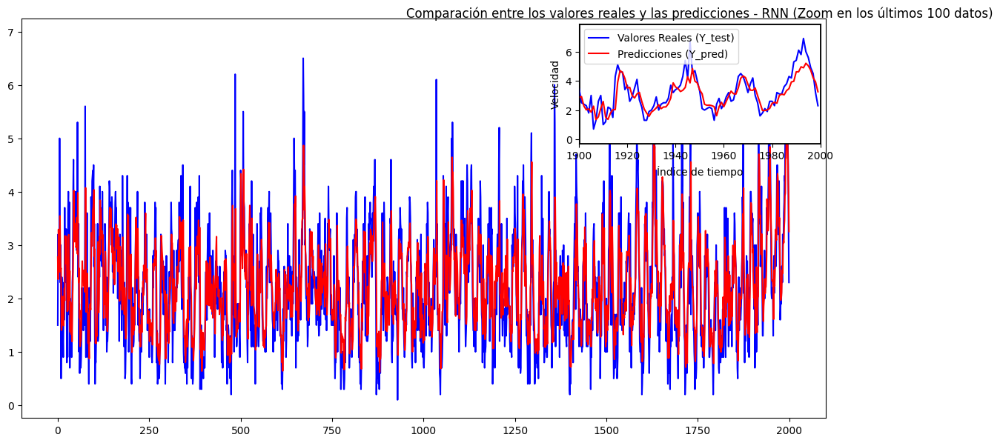

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')

# Crear el área de zoom para los últimos 100 puntos
axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")  # Crear un zoom en la esquina superior derecha
axins.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
axins.plot(Y_pred, label='Predicciones (Y_pred)', color='red')

# Limitar la visualización al zoom (últimos 100 datos)
axins.set_xlim(len(Y_test_descaled) - 100, len(Y_test_descaled))  # Últimos 100 datos
axins.set_ylim(min(Y_test_descaled[-100:].min(), Y_pred[-100:].min()) - 1,
               max(Y_test_descaled[-100:].max(), Y_pred[-100:].max()) + 1)

# Agregar un marco que conecta el zoom con la gráfica principal
mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

# Ajustes para la gráfica principal
plt.title('Comparación entre los valores reales y las predicciones - RNN (Zoom en los últimos 100 datos)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()

plt.show()


## GRU

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Supongamos que tienes tu DataFrame `data_lagged_clean` con las características (X) y la variable objetivo 'Velocidad'

# Crear lags de la variable objetivo 'Velocidad'
num_lags_y = 36  # Por ejemplo, 36 lags para este caso
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000)

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para GRU en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo GRU base
model = Sequential()
model.add(GRU(50, activation='relu', input_shape=(1, X_train.shape[1])))  # 50 unidades en la capa GRU
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Definir el callback EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entrenar el modelo con EarlyStopping
history = model.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                    validation_data=(X_test_reshaped, Y_test),
                    callbacks=[early_stopping], verbose=1)

# Hacer predicciones y desescalar
Y_pred_scaled = model.predict(X_test_reshaped)
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular el MAE
mae = mean_absolute_error(Y_test_descaled, Y_pred)
print(f'Error absoluto medio (MAE): {mae}')

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


800/800 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.0145 - val_loss: 0.0075
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0082 - val_loss: 0.0076
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0077 - val_loss: 0.0070
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0081 - val_loss: 0.0070
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0078 - val_loss: 0.0071
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0080 - val_loss: 0.0072
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0074 - val_loss: 0.0070
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0076 - val_loss: 0.0071
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0075 - val_loss: 0.0082
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0074 - val_loss: 0.0071
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0075 - val_loss: 0.0071
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import Huber
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import pandas as pd

# Supongamos que tienes tu DataFrame `data_lagged_clean` con las características (X) y la variable objetivo 'Velocidad'

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

best_mae = float('inf')
best_params = {}

# Definir los valores para num_lags_y y otros hiperparámetros
num_lags_y_list = list(range(12, 49, 12))  # Múltiplos de 12 desde 12 hasta 48
gru_units_list = [50, 100]  # Número de unidades en la capa GRU
optimizers_list = ['adam', 'rmsprop']  # Lista de optimizadores

# Iterar sobre los valores de los hiperparámetros
for num_lags_y in num_lags_y_list:
    for gru_units in gru_units_list:
        for optimizer in optimizers_list:
            # Crear lags de la variable objetivo 'Velocidad'
            data_lagged = datos_pf2.copy()
            for lag in range(1, num_lags_y + 1):
                data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

            # Eliminar las filas con valores NaN después de crear los lags de Y
            data_lagged = data_lagged.tail(10000)

            # Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
            X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
            Y = data_lagged['Velocidad'].values  # Variable objetivo

            # Escalar los datos
            X_scaled = scaler_X.fit_transform(X)
            Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

            # Dividir los datos en conjuntos de entrenamiento y prueba
            split_index = int(0.8 * len(X_scaled))
            X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
            Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

            # Preparar los datos para GRU en formato 3D: (n_samples, timesteps=1, n_features)
            X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
            X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

            # Definir el modelo GRU
            model = Sequential()
            model.add(GRU(gru_units, activation='relu', input_shape=(1, X_train.shape[1])))
            model.add(Dense(1))
            model.compile(optimizer=optimizer, loss=Huber())

            # Definir el callback EarlyStopping
            early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

            # Entrenar el modelo con EarlyStopping
            history = model.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                                validation_data=(X_test_reshaped, Y_test),
                                callbacks=[early_stopping], verbose=0)

            # Hacer predicciones y calcular el MAE
            Y_pred_scaled = model.predict(X_test_reshaped)
            Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
            Y_test_descaled = scaler_Y.inverse_transform(Y_test)

            mae = mean_absolute_error(Y_test_descaled, Y_pred)

            # Guardar los mejores hiperparámetros si se encuentra un mejor MAE
            if mae < best_mae:
                best_mae = mae
                best_params = {
                    'num_lags_y': num_lags_y,
                    'gru_units': gru_units,
                    'optimizer': optimizer,
                    'loss_function': 'Huber',
                    'mae': mae
                }

# Imprimir los mejores hiperparámetros y el MAE
print("Mejores hiperparámetros encontrados:")
print(best_params)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
Mejores hiperparámetros encontrados:
{'num_lags_y': 48, 'gru_units': 100, 'optimizer': 'adam', 'loss_function': 'Huber', 'mae': 0.5666646074652671}


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


800/800 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.0058 - val_loss: 0.0038
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0041 - val_loss: 0.0036
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0042 - val_loss: 0.0036
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0036
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0040 - val_loss: 0.0036
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0037
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0040 - val_loss: 0.0036
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0037
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0039 - val_loss: 0.0035
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0036
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0040 - val_loss: 0.0037
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step

Modelo guardado como 'modelo_gru_mejorado.h5'
63/63 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step
Error absoluto medio (MAE): 0.5678765567898749


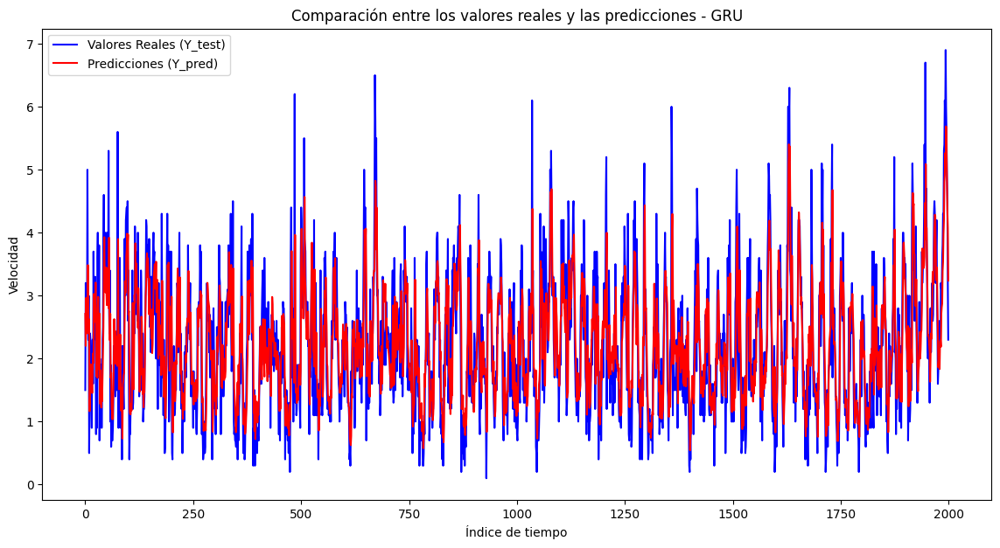

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import Huber
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Crear lags de la variable objetivo 'Velocidad' con los mejores parámetros
num_lags_y = 48  # Mejor número de lags encontrado
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000)

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para GRU en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo GRU con los mejores hiperparámetros
model_gru = Sequential()
model_gru.add(GRU(100, activation='relu', input_shape=(1, X_train.shape[1])))  # gru_units=100
model_gru.add(Dense(1))
model_gru.compile(optimizer='adam', loss=Huber())  # optimizer='adam', loss_function='Huber'

# Definir el callback EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entrenar el modelo con EarlyStopping
history = model_gru.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                    validation_data=(X_test_reshaped, Y_test),
                    callbacks=[early_stopping], verbose=1)

# Guardar el modelo en formato h5
model_gru.save('modelo_gru_mejorado.h5')
print("Modelo guardado como 'modelo_gru_mejorado.h5'")

# Hacer predicciones y desescalar
Y_pred_scaled = model_gru.predict(X_test_reshaped)
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular el MAE
mae_gru = mean_absolute_error(Y_test_descaled, Y_pred)
print(f'Error absoluto medio (MAE): {mae_gru}')

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')
plt.title('Comparación entre los valores reales y las predicciones - GRU')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


800/800 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - loss: 0.0073 - val_loss: 0.0038
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0044 - val_loss: 0.0036
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0039 - val_loss: 0.0035
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0039 - val_loss: 0.0037
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0040 - val_loss: 0.0036
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0038 - val_loss: 0.0036
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0040 - val_loss: 0.0037
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0037 - val_loss: 0.0035
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0038 - val_loss: 0.0035
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0037 - val_loss: 0.0035
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0037 - val_loss: 0.0035
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step

Modelo guardado como 'modelo_gru_mejorado.h5'
63/63 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step
Error absoluto medio (MAE): 0.5716530273616313
Error cuadrático medio (RMSE): 0.7523280987940304
Error cuadrático medio normalizado (NRMSE): 0.11063648511676916


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


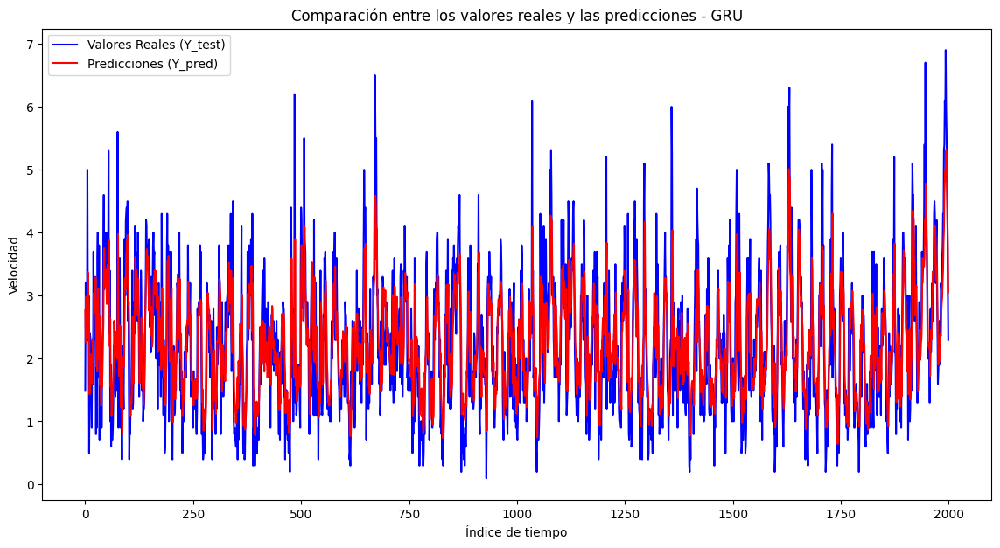

In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import Huber
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt

# Crear lags de la variable objetivo 'Velocidad' con los mejores parámetros
num_lags_y = 48  # Mejor número de lags encontrado
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000).dropna()

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para GRU en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo GRU con los mejores hiperparámetros
model_gru = Sequential()
model_gru.add(GRU(100, activation='relu', input_shape=(1, X_train.shape[1])))  # gru_units=100
model_gru.add(Dense(1))
model_gru.compile(optimizer='adam', loss=Huber())  # optimizer='adam', loss_function='Huber'

# Definir el callback EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entrenar el modelo con EarlyStopping
history = model_gru.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                        validation_data=(X_test_reshaped, Y_test),
                        callbacks=[early_stopping], verbose=1)

# Guardar el modelo en formato h5
model_gru.save('modelo_gru_mejorado.h5')
print("Modelo guardado como 'modelo_gru_mejorado.h5'")

# Hacer predicciones y desescalar
Y_pred_scaled = model_gru.predict(X_test_reshaped)
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular el MAE
mae_gru = mean_absolute_error(Y_test_descaled, Y_pred)

# Calcular el RMSE
rmse_gru = mean_squared_error(Y_test_descaled, Y_pred, squared=False)

# Calcular el NRMSE
nrmse_gru = rmse_gru / (Y_test_descaled.max() - Y_test_descaled.min())

# Imprimir resultados
print(f'Error absoluto medio (MAE): {mae_gru}')
print(f'Error cuadrático medio (RMSE): {rmse_gru}')
print(f'Error cuadrático medio normalizado (NRMSE): {nrmse_gru}')

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')
plt.title('Comparación entre los valores reales y las predicciones - GRU')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


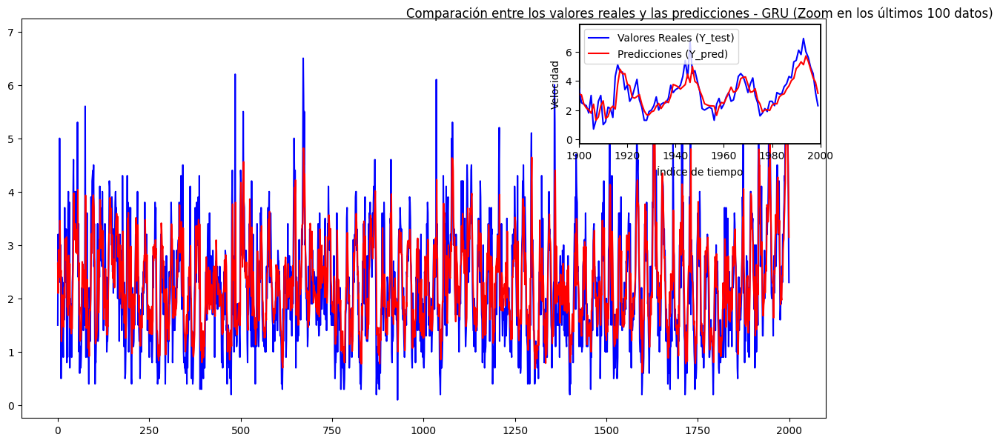

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')

# Crear el área de zoom para los últimos 100 puntos
axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")  # Crear un zoom en la esquina superior derecha
axins.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
axins.plot(Y_pred, label='Predicciones (Y_pred)', color='red')

# Limitar la visualización al zoom (últimos 100 datos)
axins.set_xlim(len(Y_test_descaled) - 100, len(Y_test_descaled))  # Últimos 100 datos
axins.set_ylim(min(Y_test_descaled[-100:].min(), Y_pred[-100:].min()) - 1,
               max(Y_test_descaled[-100:].max(), Y_pred[-100:].max()) + 1)

# Agregar un marco que conecta el zoom con la gráfica principal
mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

# Ajustes para la gráfica principal
plt.title('Comparación entre los valores reales y las predicciones - GRU (Zoom en los últimos 100 datos)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()

plt.show()


## XGBOOST

[0]	validation_0-rmse:0.13386
[1]	validation_0-rmse:0.12692
[2]	validation_0-rmse:0.12099
[3]	validation_0-rmse:0.11595
[4]	validation_0-rmse:0.11169
[5]	validation_0-rmse:0.10810
[6]	validation_0-rmse:0.10505
[7]	validation_0-rmse:0.10250
[8]	validation_0-rmse:0.10033
[9]	validation_0-rmse:0.09855
[10]	validation_0-rmse:0.09693
[11]	validation_0-rmse:0.09568
[12]	validation_0-rmse:0.09467
[13]	validation_0-rmse:0.09379
[14]	validation_0-rmse:0.09303
[15]	validation_0-rmse:0.09239
[16]	validation_0-rmse:0.09191
[17]	validation_0-rmse:0.09144
[18]	validation_0-rmse:0.09109
[19]	validation_0-rmse:0.09080
[20]	validation_0-rmse:0.09054
[21]	validation_0-rmse:0.09028
[22]	validation_0-rmse:0.09011
[23]	validation_0-rmse:0.08998
[24]	validation_0-rmse:0.08992
[25]	validation_0-rmse:0.08980
[26]	validation_0-rmse:0.08966
[27]	validation_0-rmse:0.08953
[28]	validation_0-rmse:0.08944
[29]	validation_0-rmse:0.08942
[30]	validation_0-rmse:0.08937
[31]	validation_0-rmse:0.08937
[32]	validation_0-

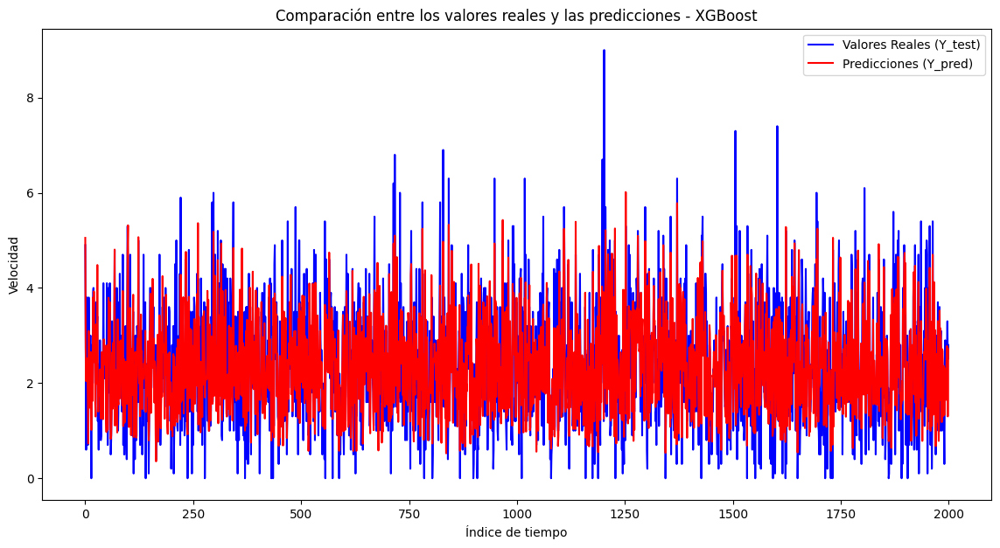

In [ ]:
import numpy as np
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Supongamos que tienes tu DataFrame `data_lagged_clean` con las características (X) y la variable objetivo 'Velocidad'

# Crear lags de la variable objetivo 'Velocidad'
num_lags_y = 36  # Por ejemplo, 36 lags para este caso
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000).dropna()

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1)).flatten()

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, Y_train, Y_test = train_test_split(X_scaled, Y_scaled, test_size=0.2, random_state=42)

# Definir el modelo XGBoost
xgb_model = xgb.XGBRegressor(
    n_estimators=100,  # Número de árboles
    max_depth=5,       # Profundidad máxima de los árboles
    learning_rate=0.1, # Tasa de aprendizaje
    objective='reg:squarederror',
    random_state=42
)

# Entrenar el modelo
xgb_model.fit(X_train, Y_train, eval_set=[(X_test, Y_test)], verbose=True)

# Hacer predicciones
Y_pred_scaled = xgb_model.predict(X_test)

# Desescalar las predicciones y los valores reales
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled.reshape(-1, 1)).flatten()
Y_test_descaled = scaler_Y.inverse_transform(Y_test.reshape(-1, 1)).flatten()

# Calcular el MAE
mae = mean_absolute_error(Y_test_descaled, Y_pred)
print(f'Error absoluto medio (MAE): {mae}')

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')
plt.title('Comparación entre los valores reales y las predicciones - XGBoost')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


In [ ]:
import numpy as np
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import pandas as pd

# Supongamos que tienes tu DataFrame `data_lagged_clean` con las características (X) y la variable objetivo 'Velocidad'

scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

best_mae = float('inf')
best_params = {}

# Definir los valores para num_lags_y y otros hiperparámetros
num_lags_y_list = list(range(12, 49, 12))  # Múltiplos de 12 desde 12 hasta 48
n_estimators_list = [50, 100, 200]  # Número de árboles
max_depth_list = [3, 5, 7]  # Profundidad máxima de los árboles
learning_rate_list = [0.01, 0.1, 0.2]  # Tasa de aprendizaje

# Iterar sobre los valores de los hiperparámetros
for num_lags_y in num_lags_y_list:
    for n_estimators in n_estimators_list:
        for max_depth in max_depth_list:
            for learning_rate in learning_rate_list:
                # Crear lags de la variable objetivo 'Velocidad'
                data_lagged = datos_pf2.copy()
                for lag in range(1, num_lags_y + 1):
                    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

                # Eliminar las filas con valores NaN después de crear los lags de Y
                data_lagged = data_lagged.tail(10000).dropna()

                # Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
                X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
                Y = data_lagged['Velocidad'].values  # Variable objetivo

                # Escalar los datos
                X_scaled = scaler_X.fit_transform(X)
                Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1)).flatten()

                # Dividir los datos en conjuntos de entrenamiento y prueba
                X_train, X_test, Y_train, Y_test = train_test_split(
                    X_scaled, Y_scaled, test_size=0.2, random_state=42
                )

                # Definir el modelo XGBoost
                xgb_model = xgb.XGBRegressor(
                    n_estimators=n_estimators,
                    max_depth=max_depth,
                    learning_rate=learning_rate,
                    objective='reg:squarederror',
                    random_state=42
                )

                # Entrenar el modelo
                xgb_model.fit(X_train, Y_train, verbose=0)

                # Hacer predicciones
                Y_pred_scaled = xgb_model.predict(X_test)

                # Desescalar las predicciones y los valores reales
                Y_pred = scaler_Y.inverse_transform(Y_pred_scaled.reshape(-1, 1)).flatten()
                Y_test_descaled = scaler_Y.inverse_transform(Y_test.reshape(-1, 1)).flatten()

                # Calcular el MAE
                mae = mean_absolute_error(Y_test_descaled, Y_pred)

                # Guardar los mejores hiperparámetros si se encuentra un mejor MAE
                if mae < best_mae:
                    best_mae = mae
                    best_params = {
                        'num_lags_y': num_lags_y,
                        'n_estimators': n_estimators,
                        'max_depth': max_depth,
                        'learning_rate': learning_rate,
                        'mae': mae
                    }

# Imprimir los mejores hiperparámetros y el MAE
print("Mejores hiperparámetros encontrados:")
print(best_params)


Mejores hiperparámetros encontrados:
{'num_lags_y': 48, 'n_estimators': 200, 'max_depth': 3, 'learning_rate': 0.1, 'mae': 0.5980990373551845}


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Resultados del modelo con los mejores hiperparámetros:
MAE: 0.5980990373551845
RMSE: 0.7962520814358194
NRMSE: 0.08847245349286882


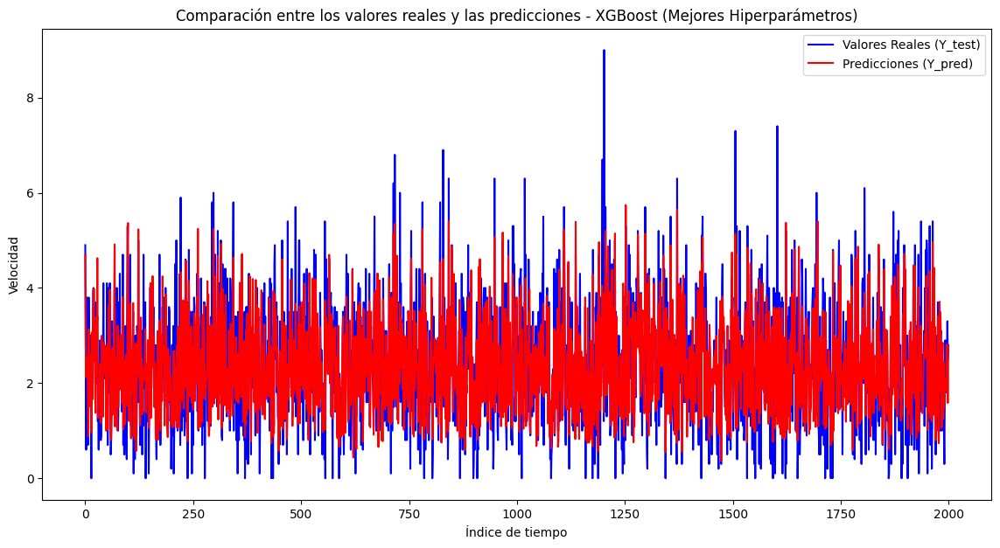

In [ ]:
from sklearn.metrics import mean_squared_error

# Entrenar el modelo con los mejores hiperparámetros
best_num_lags_y = best_params['num_lags_y']
best_n_estimators = best_params['n_estimators']
best_max_depth = best_params['max_depth']
best_learning_rate = best_params['learning_rate']

# Crear lags de la variable objetivo 'Velocidad'
data_lagged = datos_pf2.copy()
for lag in range(1, best_num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000).dropna()

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1)).flatten()

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, Y_train, Y_test = train_test_split(
    X_scaled, Y_scaled, test_size=0.2, random_state=42
)

# Definir el modelo XGBoost con los mejores hiperparámetros
xgb_model = xgb.XGBRegressor(
    n_estimators=best_n_estimators,
    max_depth=best_max_depth,
    learning_rate=best_learning_rate,
    objective='reg:squarederror',
    random_state=42
)

# Entrenar el modelo
xgb_model.fit(X_train, Y_train, verbose=True)

# Hacer predicciones
Y_pred_scaled = xgb_model.predict(X_test)

# Desescalar las predicciones y los valores reales
Y_pred = scaler_Y.inverse_transform(Y_pred_scaled.reshape(-1, 1)).flatten()
Y_test_descaled = scaler_Y.inverse_transform(Y_test.reshape(-1, 1)).flatten()

# Calcular MAE
mae = mean_absolute_error(Y_test_descaled, Y_pred)

# Calcular RMSE y NRMSE
rmse = mean_squared_error(Y_test_descaled, Y_pred, squared=False)
nrmse = rmse / (Y_test_descaled.max() - Y_test_descaled.min())

print("Resultados del modelo con los mejores hiperparámetros:")
print(f"MAE: {mae}")
print(f"RMSE: {rmse}")
print(f"NRMSE: {nrmse}")

# Graficar los resultados
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')
plt.title('Comparación entre los valores reales y las predicciones - XGBoost (Mejores Hiperparámetros)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


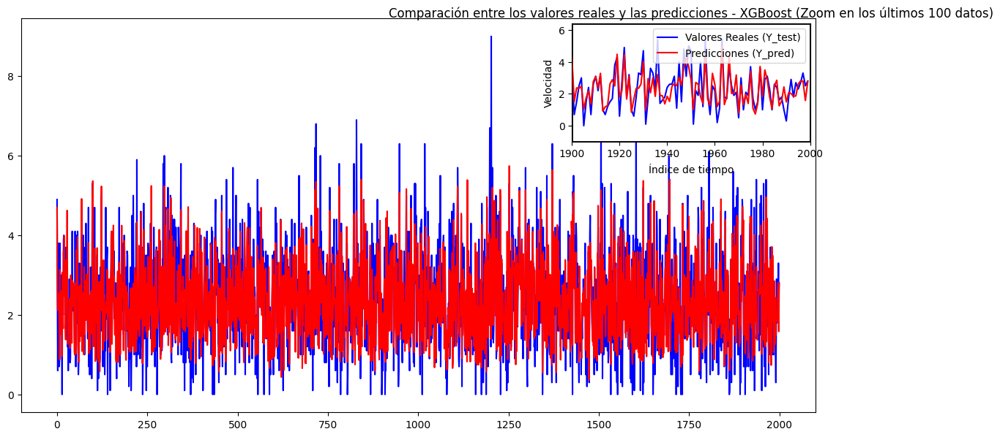

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Graficar Y_test y Y_pred
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(Y_pred, label='Predicciones (Y_pred)', color='red')

# Crear el área de zoom para los últimos 100 puntos
axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")  # Zoom en la esquina superior derecha
axins.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
axins.plot(Y_pred, label='Predicciones (Y_pred)', color='red')

# Limitar la visualización al zoom (últimos 100 datos)
axins.set_xlim(len(Y_test_descaled) - 100, len(Y_test_descaled))  # Últimos 100 datos
axins.set_ylim(min(Y_test_descaled[-100:].min(), Y_pred[-100:].min()) - 1,
               max(Y_test_descaled[-100:].max(), Y_pred[-100:].max()) + 1)

# Agregar un marco que conecta el zoom con la gráfica principal
mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

# Ajustes para la gráfica principal
plt.title('Comparación entre los valores reales y las predicciones - XGBoost (Zoom en los últimos 100 datos)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()

plt.show()


## VENTANAS

Comenzando la prueba con una ventana de 3 pasos...


MAE promedio para la ventana de 3 pasos: 2.8598948412259206


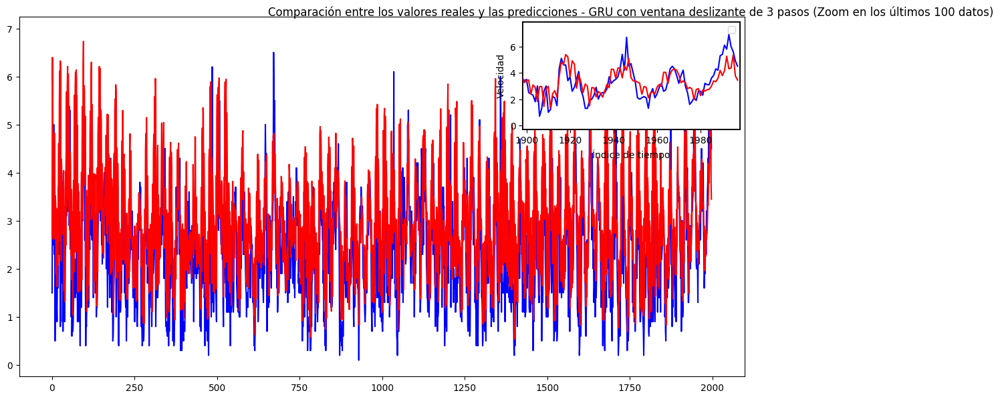

Comenzando la prueba con una ventana de 6 pasos...


MAE promedio para la ventana de 6 pasos: 3.0799348506510107


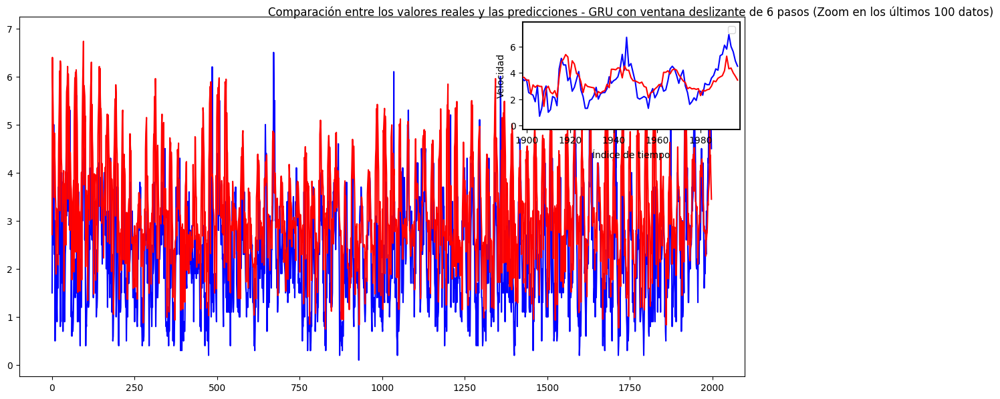

Comenzando la prueba con una ventana de 12 pasos...


MAE promedio para la ventana de 12 pasos: 3.193620609989766


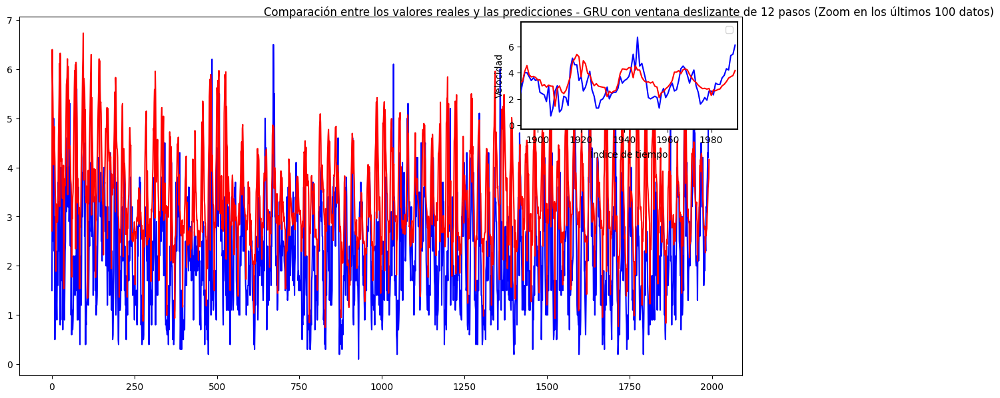

Comenzando la prueba con una ventana de 24 pasos...


MAE promedio para la ventana de 24 pasos: 3.24248194243694


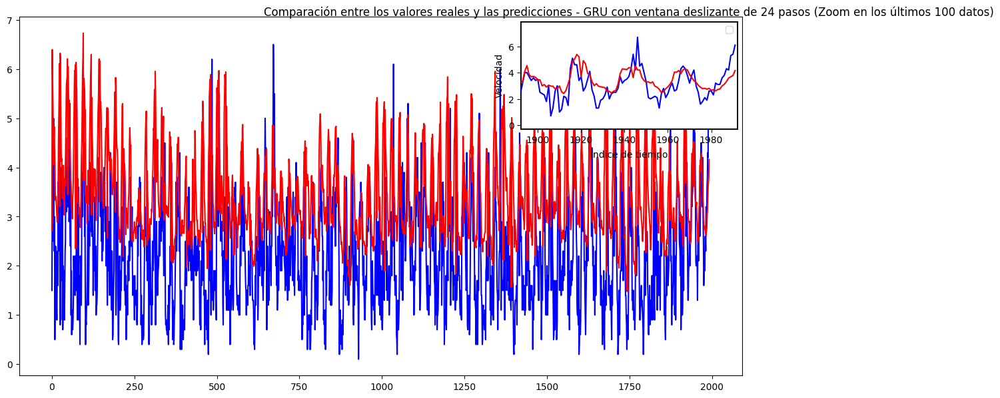

Comenzando la prueba con una ventana de 36 pasos...


MAE promedio para la ventana de 36 pasos: 3.276581993625488


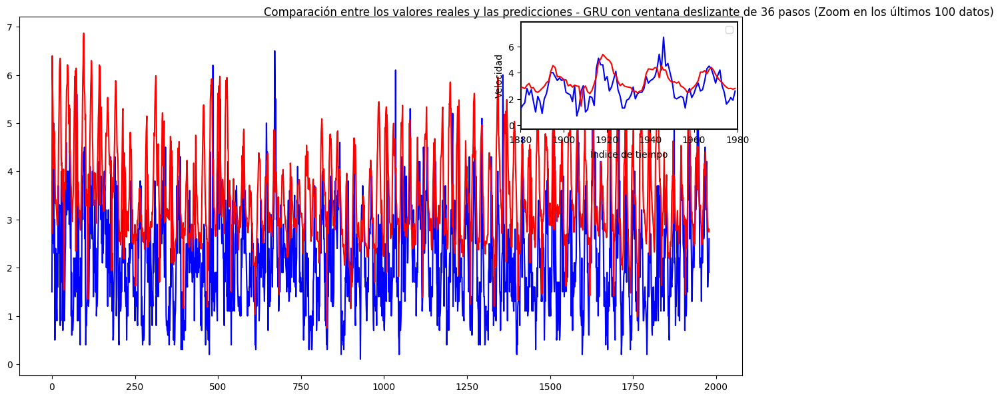

Comenzando la prueba con una ventana de 48 pasos...


MAE promedio para la ventana de 48 pasos: 3.2834250331961474


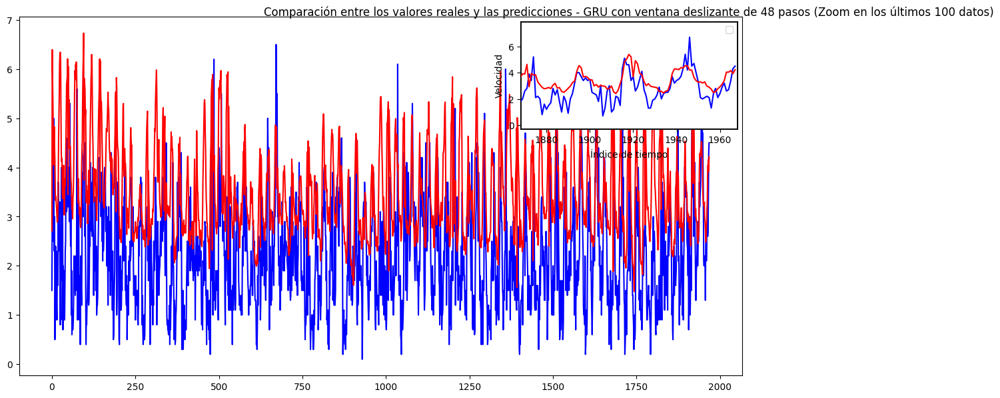


Resultados finales de MAE promedio por tamaño de ventana:
Ventana de 3 pasos: MAE promedio = 2.8598948412259206
Ventana de 6 pasos: MAE promedio = 3.0799348506510107
Ventana de 12 pasos: MAE promedio = 3.193620609989766
Ventana de 24 pasos: MAE promedio = 3.24248194243694
Ventana de 36 pasos: MAE promedio = 3.276581993625488
Ventana de 48 pasos: MAE promedio = 3.2834250331961474


In [ ]:
import numpy as np
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset


# Supongamos que ya tienes cargado el modelo GRU en tu entorno como `model_gru`

# Lista de tamaños de ventana a probar
window_sizes = [3, 6, 12, 24, 36, 48]

# Diccionario para almacenar los MAE promedio por tamaño de ventana
mae_results = {}

# Iterar sobre diferentes tamaños de ventana
for window_size in window_sizes:
    print(f'Comenzando la prueba con una ventana de {window_size} pasos...')

    # Preparar los datos de prueba para la ventana deslizante
    X_test_window = X_test_reshaped.copy()  # Crear una copia de los datos de prueba
    Y_test_window = Y_test.copy()  # Copia de los datos de prueba desescalados

    # Lista para almacenar los MAE de cada ventana
    mae_list = []

    # Lista para almacenar todas las predicciones concatenadas
    all_preds = []

    # Iterar sobre el conjunto de prueba en ventanas de longitud `window_size`
    for start in range(0, len(X_test_window) - window_size, window_size):
        # Ventana actual de `window_size`
        X_window = X_test_window[start:start + window_size]
        Y_actual = Y_test_window[start:start + window_size]

        Y_preds_window = []

        # Realizar predicciones en la ventana de tamaño actual
        for i in range(window_size):
            # Predecir el valor actual
            pred_scaled = model_gru.predict(X_window[i].reshape(1, 1, X_window.shape[2]), verbose=0)
            pred = scaler_Y.inverse_transform(pred_scaled)

            # Almacenar la predicción desescalada
            Y_preds_window.append(pred[0, 0])

            # Actualizar la entrada para la próxima predicción
            if i < window_size - 1:  # Evitar índice fuera de rango
                # Desplazar todos los lags una posición hacia atrás y añadir la predicción en el primer lag
                X_window[i + 1, 0, 1:] = X_window[i + 1, 0, :-1]  # Desplazar los valores de los lags hacia atrás
                X_window[i + 1, 0, 0] = scaler_Y.transform(pred)[0, 0]  # Reemplazar el primer lag con la predicción actual

        # Guardar las predicciones de la ventana
        all_preds.extend(Y_preds_window)

        # Calcular el MAE de la ventana actual
        mae_window = mean_absolute_error(Y_actual, Y_preds_window)
        mae_list.append(mae_window)

    # Calcular el MAE promedio de todas las ventanas para el tamaño actual
    mae_promedio = np.mean(mae_list)
    mae_results[window_size] = mae_promedio
    print(f'MAE promedio para la ventana de {window_size} pasos: {mae_promedio}')

    # Graficar Y_test y Y_pred concatenadas para la ventana actual con zoom en los últimos 100 datos
    plt.figure(figsize=(14, 7))
    plt.plot(Y_test_descaled[:len(all_preds)], label='Valores Reales (Y_test)', color='blue')
    plt.plot(all_preds, label=f'Predicciones (Y_pred) - Ventana {window_size}', color='red')

    # Crear el área de zoom para los últimos 100 puntos
    axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")  # Crear un zoom en la esquina superior derecha
    axins.plot(Y_test_descaled[:len(all_preds)], color='blue')
    axins.plot(all_preds, color='red')

    # Limitar la visualización al zoom (últimos 100 datos)
    axins.set_xlim(len(Y_test_descaled[:len(all_preds)]) - 100, len(Y_test_descaled[:len(all_preds)]))  # Últimos 100 datos
    axins.set_ylim(min(Y_test_descaled[-100:].min(), min(all_preds[-100:])) - 1,
                  max(Y_test_descaled[-100:].max(), max(all_preds[-100:])) + 1)

    # Agregar un marco que conecta el zoom con la gráfica principal
    mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

    # Ajustes para la gráfica principal
    plt.title(f'Comparación entre los valores reales y las predicciones - GRU con ventana deslizante de {window_size} pasos (Zoom en los últimos 100 datos)')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Velocidad')
    plt.legend()

    plt.show()


# Imprimir resultados de todos los tamaños de ventana
print("\nResultados finales de MAE promedio por tamaño de ventana:")
for size, mae in mae_results.items():
    print(f'Ventana de {size} pasos: MAE promedio = {mae}')

Comenzando la prueba con una ventana de 3 pasos...


MAE promedio para la ventana de 3 pasos: 2.7967496860996524


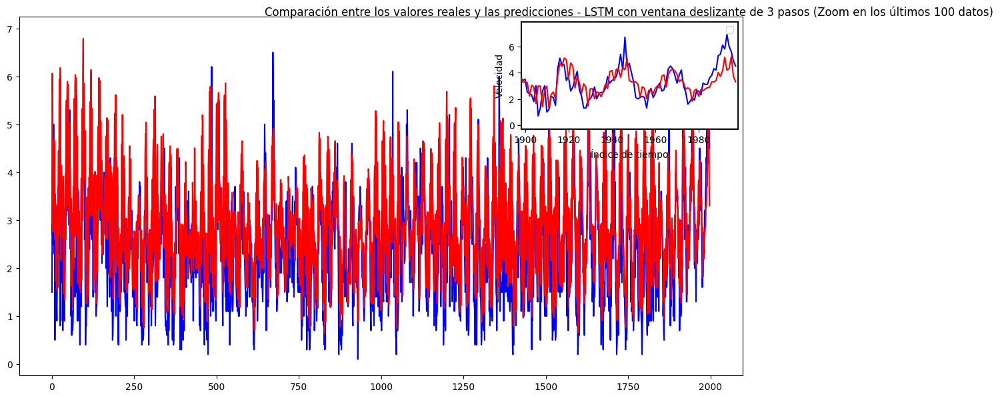

Comenzando la prueba con una ventana de 6 pasos...


MAE promedio para la ventana de 6 pasos: 3.01047233382768


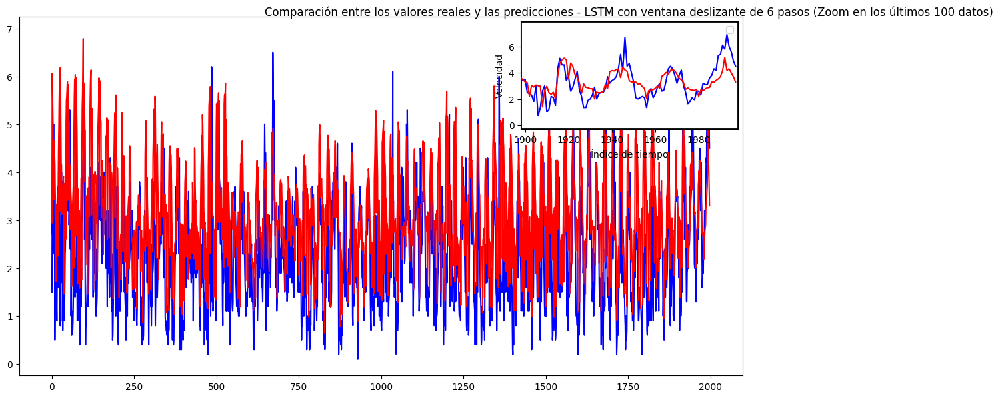

Comenzando la prueba con una ventana de 12 pasos...


MAE promedio para la ventana de 12 pasos: 3.1230330613642496


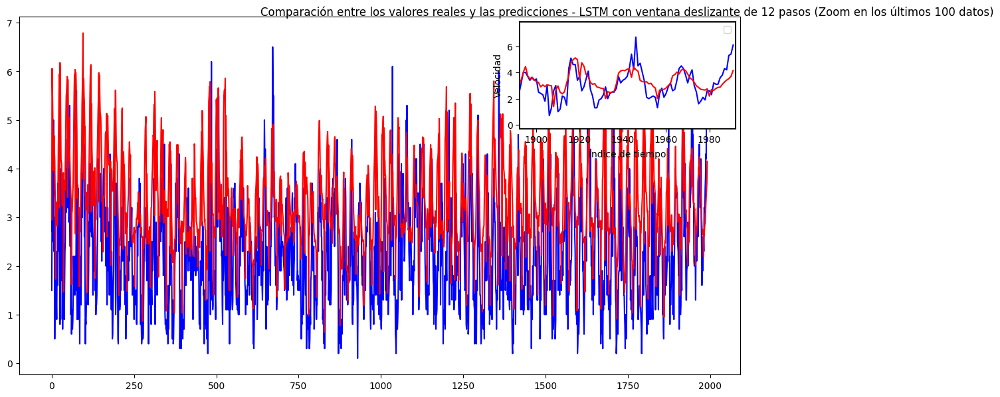

Comenzando la prueba con una ventana de 24 pasos...


MAE promedio para la ventana de 24 pasos: 3.1737360437631286


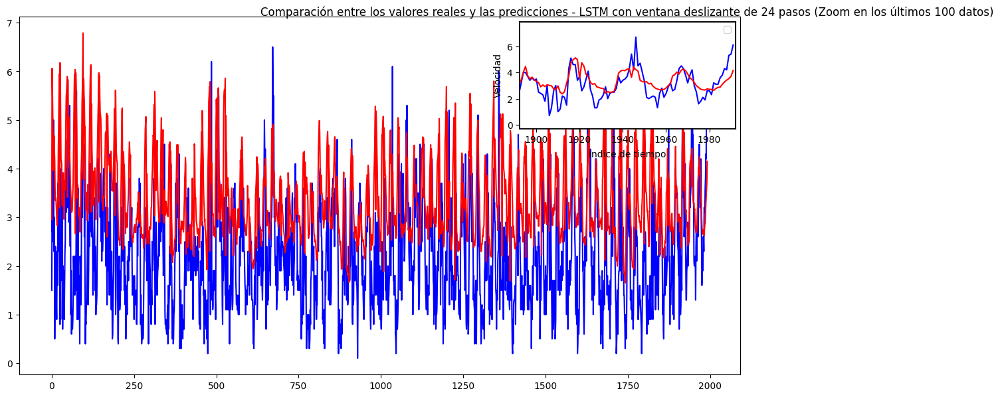

Comenzando la prueba con una ventana de 36 pasos...
MAE promedio para la ventana de 36 pasos: 3.203053933157931


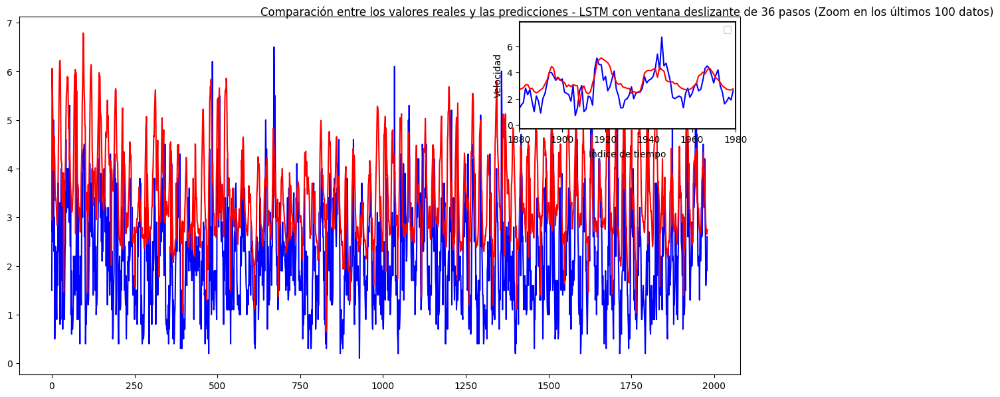

Comenzando la prueba con una ventana de 48 pasos...


MAE promedio para la ventana de 48 pasos: 3.2112744845941243


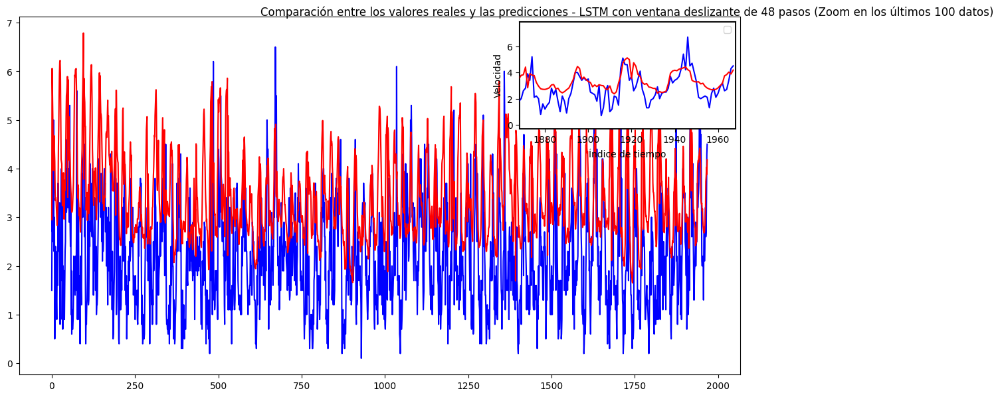


Resultados finales de MAE promedio por tamaño de ventana para LSTM:
Ventana de 3 pasos: MAE promedio = 2.7967496860996524
Ventana de 6 pasos: MAE promedio = 3.01047233382768
Ventana de 12 pasos: MAE promedio = 3.1230330613642496
Ventana de 24 pasos: MAE promedio = 3.1737360437631286
Ventana de 36 pasos: MAE promedio = 3.203053933157931
Ventana de 48 pasos: MAE promedio = 3.2112744845941243


In [ ]:
import numpy as np
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Cargar el modelo LSTM

# Lista de tamaños de ventana a probar
window_sizes = [3, 6, 12, 24, 36, 48]

# Diccionario para almacenar los MAE promedio por tamaño de ventana
mae_results_lstm = {}

# Iterar sobre diferentes tamaños de ventana
for window_size in window_sizes:
    print(f'Comenzando la prueba con una ventana de {window_size} pasos...')

    # Preparar los datos de prueba para la ventana deslizante
    X_test_window = X_test_reshaped.copy()  # Crear una copia de los datos de prueba
    Y_test_window = Y_test.copy()  # Copia de los datos de prueba desescalados

    # Lista para almacenar los MAE de cada ventana
    mae_list = []

    # Lista para almacenar todas las predicciones concatenadas
    all_preds = []

    # Iterar sobre el conjunto de prueba en ventanas de longitud `window_size`
    for start in range(0, len(X_test_window) - window_size, window_size):
        # Ventana actual de `window_size`
        X_window = X_test_window[start:start + window_size]
        Y_actual = Y_test_window[start:start + window_size]

        Y_preds_window = []

        # Realizar predicciones en la ventana de tamaño actual
        for i in range(window_size):
            # Predecir el valor actual
            pred_scaled = model_lstm.predict(X_window[i].reshape(1, 1, X_window.shape[2]), verbose=0)
            pred = scaler_Y.inverse_transform(pred_scaled)

            # Almacenar la predicción desescalada
            Y_preds_window.append(pred[0, 0])

            # Actualizar la entrada para la próxima predicción
            if i < window_size - 1:  # Evitar índice fuera de rango
                # Desplazar todos los lags una posición hacia atrás y añadir la predicción en el primer lag
                X_window[i + 1, 0, 1:] = X_window[i + 1, 0, :-1]  # Desplazar los valores de los lags hacia atrás
                X_window[i + 1, 0, 0] = scaler_Y.transform(pred)[0, 0]  # Reemplazar el primer lag con la predicción actual

        # Guardar las predicciones de la ventana
        all_preds.extend(Y_preds_window)

        # Calcular el MAE de la ventana actual
        mae_window = mean_absolute_error(Y_actual, Y_preds_window)
        mae_list.append(mae_window)

    # Calcular el MAE promedio de todas las ventanas para el tamaño actual
    mae_promedio = np.mean(mae_list)
    mae_results_lstm[window_size] = mae_promedio
    print(f'MAE promedio para la ventana de {window_size} pasos: {mae_promedio}')

    # Graficar Y_test y Y_pred concatenadas para la ventana actual con zoom en los últimos 100 datos
    plt.figure(figsize=(14, 7))
    plt.plot(Y_test_descaled[:len(all_preds)], label='Valores Reales (Y_test)', color='blue')
    plt.plot(all_preds, label=f'Predicciones (Y_pred) - Ventana {window_size}', color='red')

    # Crear el área de zoom para los últimos 100 puntos
    axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")  # Crear un zoom en la esquina superior derecha
    axins.plot(Y_test_descaled[:len(all_preds)], color='blue')
    axins.plot(all_preds, color='red')

    # Limitar la visualización al zoom (últimos 100 datos)
    axins.set_xlim(len(Y_test_descaled[:len(all_preds)]) - 100, len(Y_test_descaled[:len(all_preds)]))  # Últimos 100 datos
    axins.set_ylim(min(Y_test_descaled[-100:].min(), min(all_preds[-100:])) - 1,
                  max(Y_test_descaled[-100:].max(), max(all_preds[-100:])) + 1)

    # Agregar un marco que conecta el zoom con la gráfica principal
    mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

    # Ajustes para la gráfica principal
    plt.title(f'Comparación entre los valores reales y las predicciones - LSTM con ventana deslizante de {window_size} pasos (Zoom en los últimos 100 datos)')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Velocidad')
    plt.legend()

    plt.show()


# Imprimir resultados de todos los tamaños de ventana
print("\nResultados finales de MAE promedio por tamaño de ventana para LSTM:")
for size, mae in mae_results_lstm.items():
    print(f'Ventana de {size} pasos: MAE promedio = {mae}')


Comenzando la prueba con una ventana de 3 pasos...


MAE promedio para la ventana de 3 pasos: 2.7955902242412582


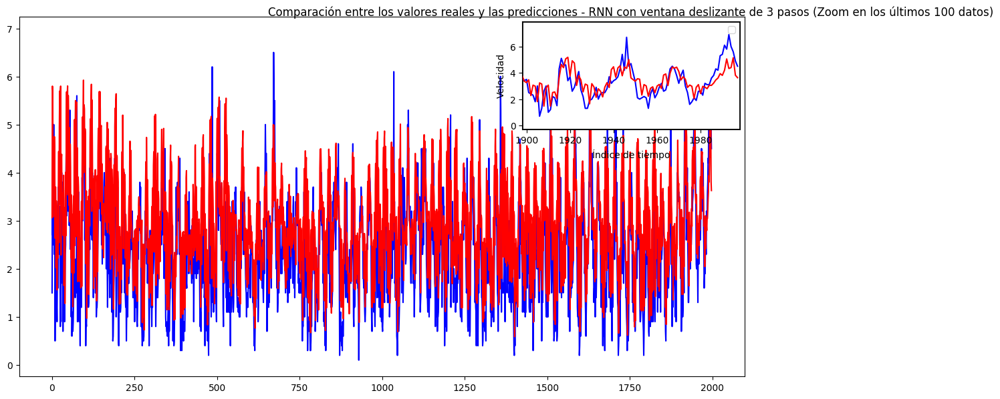

Comenzando la prueba con una ventana de 6 pasos...


MAE promedio para la ventana de 6 pasos: 3.0099836558100246


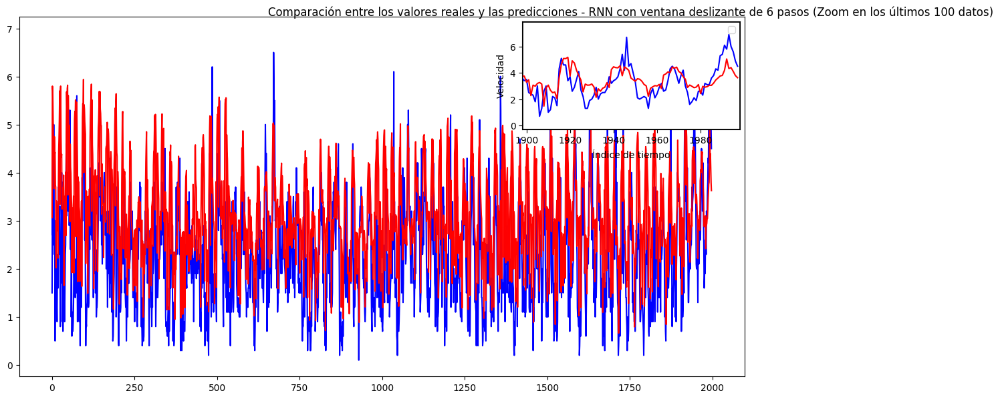

Comenzando la prueba con una ventana de 12 pasos...


MAE promedio para la ventana de 12 pasos: 3.11947056029735


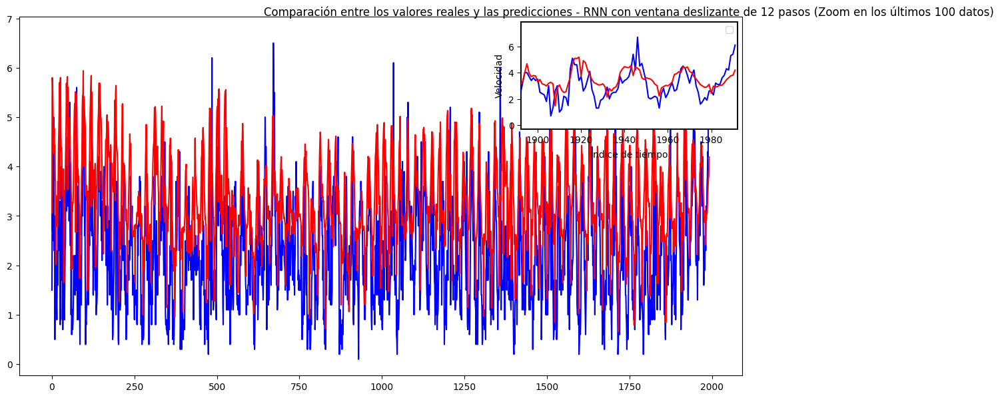

Comenzando la prueba con una ventana de 24 pasos...


MAE promedio para la ventana de 24 pasos: 3.1706837419086353


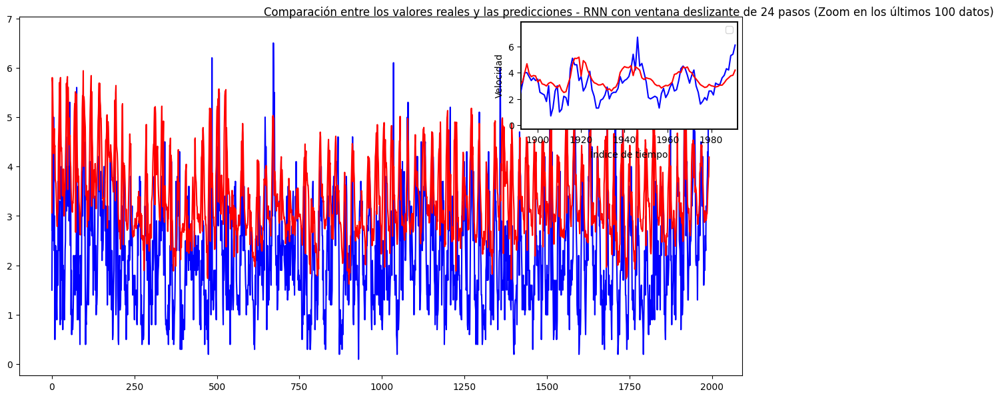

Comenzando la prueba con una ventana de 36 pasos...


MAE promedio para la ventana de 36 pasos: 3.193852597943327


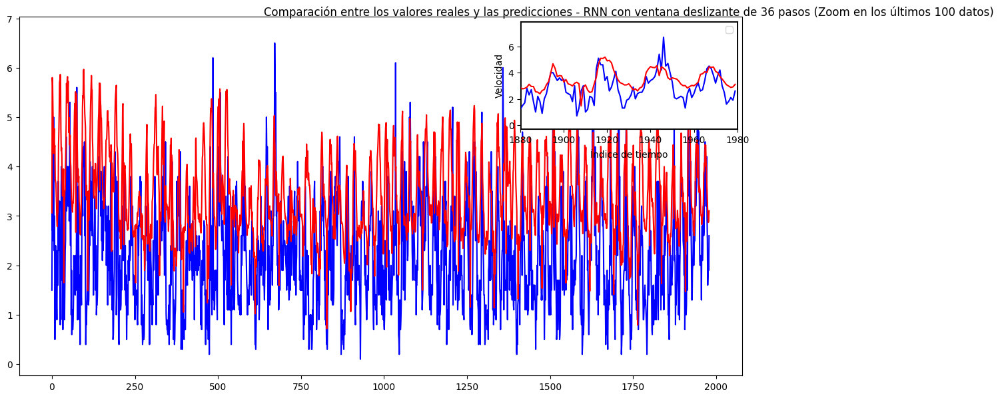

Comenzando la prueba con una ventana de 48 pasos...


MAE promedio para la ventana de 48 pasos: 3.2023195305558185


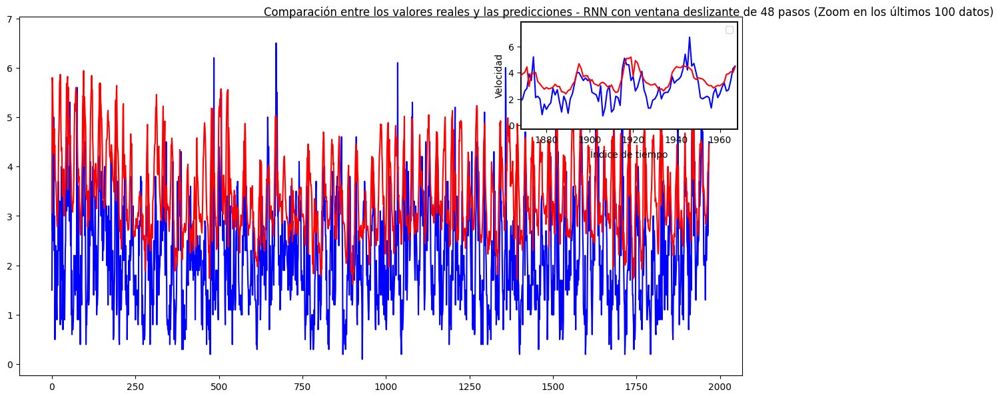


Resultados finales de MAE promedio por tamaño de ventana para RNN:
Ventana de 3 pasos: MAE promedio = 2.7955902242412582
Ventana de 6 pasos: MAE promedio = 3.0099836558100246
Ventana de 12 pasos: MAE promedio = 3.11947056029735
Ventana de 24 pasos: MAE promedio = 3.1706837419086353
Ventana de 36 pasos: MAE promedio = 3.193852597943327
Ventana de 48 pasos: MAE promedio = 3.2023195305558185


In [ ]:
import numpy as np
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Lista de tamaños de ventana a probar
window_sizes = [3, 6, 12, 24, 36, 48]

# Diccionario para almacenar los MAE promedio por tamaño de ventana
mae_results_rnn = {}

# Iterar sobre diferentes tamaños de ventana
for window_size in window_sizes:
    print(f'Comenzando la prueba con una ventana de {window_size} pasos...')

    # Preparar los datos de prueba para la ventana deslizante
    X_test_window = X_test_reshaped.copy()  # Crear una copia de los datos de prueba
    Y_test_window = Y_test.copy()  # Copia de los datos de prueba desescalados

    # Lista para almacenar los MAE de cada ventana
    mae_list = []

    # Lista para almacenar todas las predicciones concatenadas
    all_preds = []

    # Iterar sobre el conjunto de prueba en ventanas de longitud `window_size`
    for start in range(0, len(X_test_window) - window_size, window_size):
        # Ventana actual de `window_size`
        X_window = X_test_window[start:start + window_size]
        Y_actual = Y_test_window[start:start + window_size]

        Y_preds_window = []

        # Realizar predicciones en la ventana de tamaño actual
        for i in range(window_size):
            # Predecir el valor actual
            pred_scaled = model_rnn.predict(X_window[i].reshape(1, 1, X_window.shape[2]), verbose=0)
            pred = scaler_Y.inverse_transform(pred_scaled)

            # Almacenar la predicción desescalada
            Y_preds_window.append(pred[0, 0])

            # Actualizar la entrada para la próxima predicción
            if i < window_size - 1:  # Evitar índice fuera de rango
                # Desplazar todos los lags una posición hacia atrás y añadir la predicción en el primer lag
                X_window[i + 1, 0, 1:] = X_window[i + 1, 0, :-1]  # Desplazar los valores de los lags hacia atrás
                X_window[i + 1, 0, 0] = scaler_Y.transform(pred)[0, 0]  # Reemplazar el primer lag con la predicción actual

        # Guardar las predicciones de la ventana
        all_preds.extend(Y_preds_window)

        # Calcular el MAE de la ventana actual
        mae_window = mean_absolute_error(Y_actual, Y_preds_window)
        mae_list.append(mae_window)

    # Calcular el MAE promedio de todas las ventanas para el tamaño actual
    mae_promedio = np.mean(mae_list)
    mae_results_rnn[window_size] = mae_promedio
    print(f'MAE promedio para la ventana de {window_size} pasos: {mae_promedio}')

    # Graficar Y_test y Y_pred concatenadas para la ventana actual con zoom en los últimos 100 datos
    plt.figure(figsize=(14, 7))
    plt.plot(Y_test_descaled[:len(all_preds)], label='Valores Reales (Y_test)', color='blue')
    plt.plot(all_preds, label=f'Predicciones (Y_pred) - Ventana {window_size}', color='red')

    # Crear el área de zoom para los últimos 100 puntos
    axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")  # Crear un zoom en la esquina superior derecha
    axins.plot(Y_test_descaled[:len(all_preds)], color='blue')
    axins.plot(all_preds, color='red')

    # Limitar la visualización al zoom (últimos 100 datos)
    axins.set_xlim(len(Y_test_descaled[:len(all_preds)]) - 100, len(Y_test_descaled[:len(all_preds)]))  # Últimos 100 datos
    axins.set_ylim(min(Y_test_descaled[-100:].min(), min(all_preds[-100:])) - 1,
                  max(Y_test_descaled[-100:].max(), max(all_preds[-100:])) + 1)

    # Agregar un marco que conecta el zoom con la gráfica principal
    mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

    # Ajustes para la gráfica principal
    plt.title(f'Comparación entre los valores reales y las predicciones - RNN con ventana deslizante de {window_size} pasos (Zoom en los últimos 100 datos)')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Velocidad')
    plt.legend()

    plt.show()


# Imprimir resultados de todos los tamaños de ventana
print("\nResultados finales de MAE promedio por tamaño de ventana para RNN:")
for size, mae in mae_results_rnn.items():
    print(f'Ventana de {size} pasos: MAE promedio = {mae}')


Comenzando la prueba con una ventana de 3 pasos...


MAE promedio para la ventana de 3 pasos: 0.9990195293266613


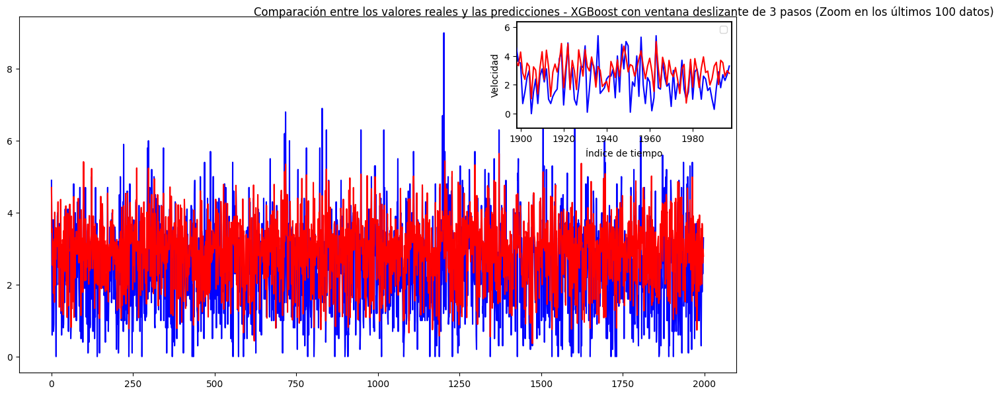

Comenzando la prueba con una ventana de 6 pasos...


MAE promedio para la ventana de 6 pasos: 1.1049996153310733


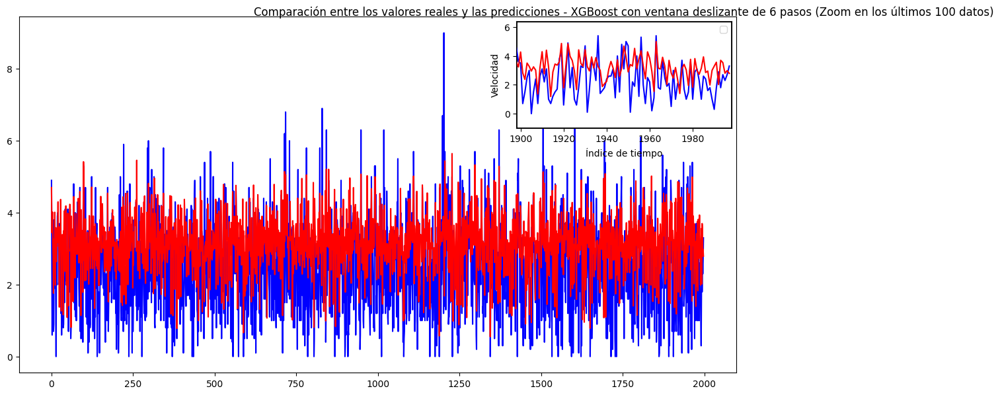

Comenzando la prueba con una ventana de 12 pasos...


MAE promedio para la ventana de 12 pasos: 1.1463892779376612


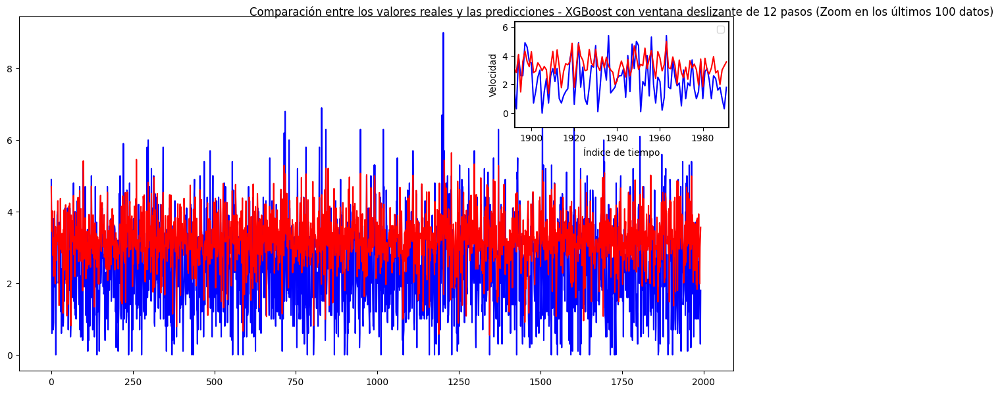

Comenzando la prueba con una ventana de 24 pasos...


MAE promedio para la ventana de 24 pasos: 1.1691943890119652


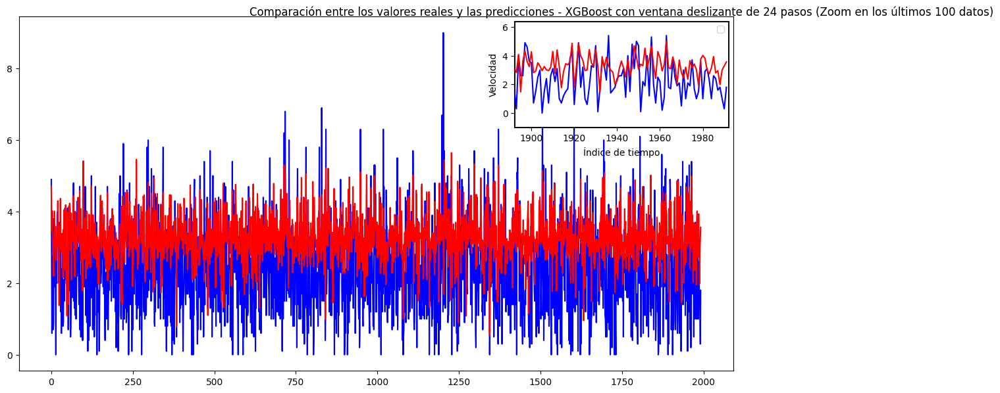

Comenzando la prueba con una ventana de 36 pasos...


MAE promedio para la ventana de 36 pasos: 1.175080706284504


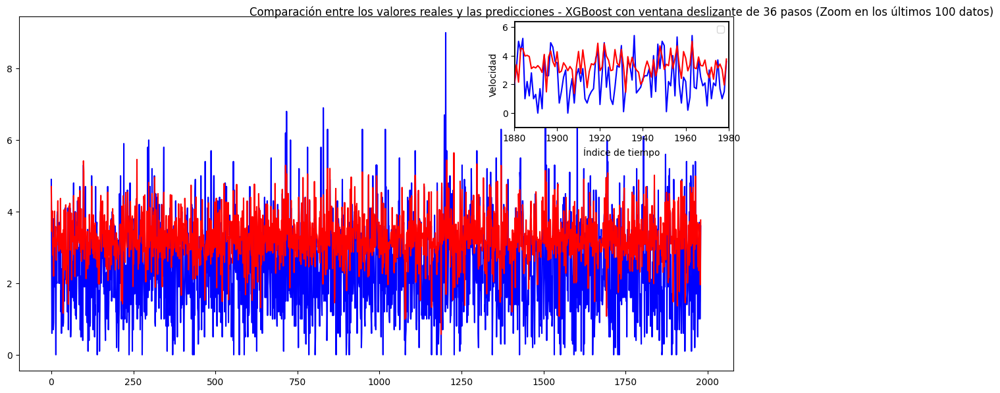

Comenzando la prueba con una ventana de 48 pasos...


MAE promedio para la ventana de 48 pasos: 1.1796828999146214


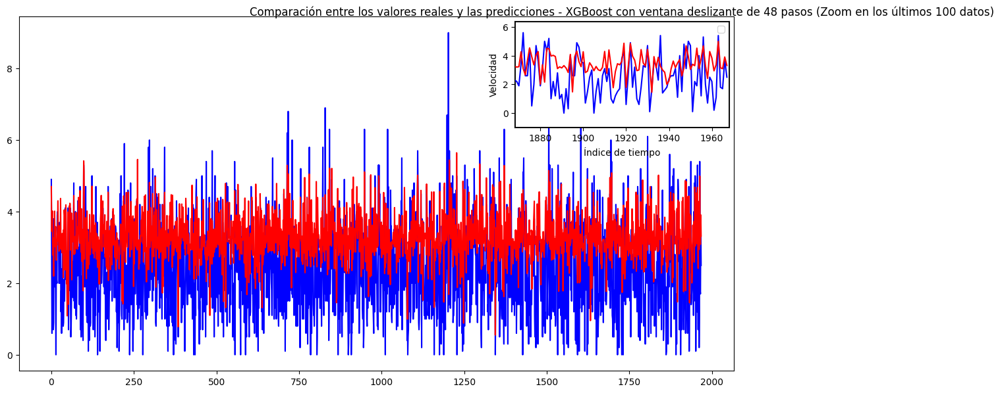


Resultados finales de MAE promedio por tamaño de ventana:
Ventana de 3 pasos: MAE promedio = 0.9990195293266613
Ventana de 6 pasos: MAE promedio = 1.1049996153310733
Ventana de 12 pasos: MAE promedio = 1.1463892779376612
Ventana de 24 pasos: MAE promedio = 1.1691943890119652
Ventana de 36 pasos: MAE promedio = 1.175080706284504
Ventana de 48 pasos: MAE promedio = 1.1796828999146214


In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Lista de tamaños de ventana a probar
window_sizes = [3, 6, 12, 24, 36, 48]

# Diccionario para almacenar los MAE promedio por tamaño de ventana
mae_results = {}

# Iterar sobre diferentes tamaños de ventana
for window_size in window_sizes:
    print(f'Comenzando la prueba con una ventana de {window_size} pasos...')

    # Preparar los datos de prueba para la ventana deslizante
    X_test_window = X_test.copy()  # Crear una copia de los datos de prueba
    Y_test_window = Y_test.copy()  # Copia de los datos de prueba desescalados

    # Lista para almacenar los MAE de cada ventana
    mae_list = []

    # Lista para almacenar todas las predicciones concatenadas
    all_preds = []

    # Iterar sobre el conjunto de prueba en ventanas de longitud `window_size`
    for start in range(0, len(X_test_window) - window_size, window_size):
        # Ventana actual de `window_size`
        X_window = X_test_window[start:start + window_size]
        Y_actual = Y_test_window[start:start + window_size]

        Y_preds_window = []

        # Realizar predicciones en la ventana de tamaño actual
        for i in range(window_size):
            # Predecir el valor actual
            pred_scaled = xgb_model.predict(X_window[i].reshape(1, -1))
            pred = scaler_Y.inverse_transform(pred_scaled.reshape(-1, 1))

            # Almacenar la predicción desescalada
            Y_preds_window.append(pred[0, 0])

            # Actualizar la entrada para la próxima predicción
            if i < window_size - 1:  # Evitar índice fuera de rango
                # Desplazar todos los lags una posición hacia atrás y añadir la predicción en el primer lag
                X_window[i + 1, 1:] = X_window[i + 1, :-1]  # Desplazar los valores de los lags hacia atrás
                X_window[i + 1, 0] = scaler_Y.transform(pred)[0, 0]  # Reemplazar el primer lag con la predicción actual

        # Guardar las predicciones de la ventana
        all_preds.extend(Y_preds_window)

        # Calcular el MAE de la ventana actual
        mae_window = mean_absolute_error(
            scaler_Y.inverse_transform(Y_actual.reshape(-1, 1)).flatten(),
            np.array(Y_preds_window)
        )
        mae_list.append(mae_window)

    # Calcular el MAE promedio de todas las ventanas para el tamaño actual
    mae_promedio = np.mean(mae_list)
    mae_results[window_size] = mae_promedio
    print(f'MAE promedio para la ventana de {window_size} pasos: {mae_promedio}')

    # Graficar Y_test y Y_pred concatenadas para la ventana actual con zoom en los últimos 100 datos
    plt.figure(figsize=(14, 7))
    plt.plot(scaler_Y.inverse_transform(Y_test_window[:len(all_preds)].reshape(-1, 1)), label='Valores Reales (Y_test)', color='blue')
    plt.plot(all_preds, label=f'Predicciones (Y_pred) - Ventana {window_size}', color='red')

    # Crear el área de zoom para los últimos 100 puntos
    axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")  # Crear un zoom en la esquina superior derecha
    axins.plot(scaler_Y.inverse_transform(Y_test_window[:len(all_preds)].reshape(-1, 1)), color='blue')
    axins.plot(all_preds, color='red')

    # Limitar la visualización al zoom (últimos 100 datos)
    axins.set_xlim(len(all_preds) - 100, len(all_preds))  # Últimos 100 datos
    axins.set_ylim(
        min(scaler_Y.inverse_transform(Y_test_window[-100:].reshape(-1, 1)).flatten().min(), min(all_preds[-100:])) - 1,
        max(scaler_Y.inverse_transform(Y_test_window[-100:].reshape(-1, 1)).flatten().max(), max(all_preds[-100:])) + 1
    )

    # Agregar un marco que conecta el zoom con la gráfica principal
    mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

    # Ajustes para la gráfica principal
    plt.title(f'Comparación entre los valores reales y las predicciones - XGBoost con ventana deslizante de {window_size} pasos (Zoom en los últimos 100 datos)')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Velocidad')
    plt.legend()

    plt.show()

# Imprimir resultados de todos los tamaños de ventana
print("\nResultados finales de MAE promedio por tamaño de ventana:")
for size, mae in mae_results.items():
    print(f'Ventana de {size} pasos: MAE promedio = {mae}')


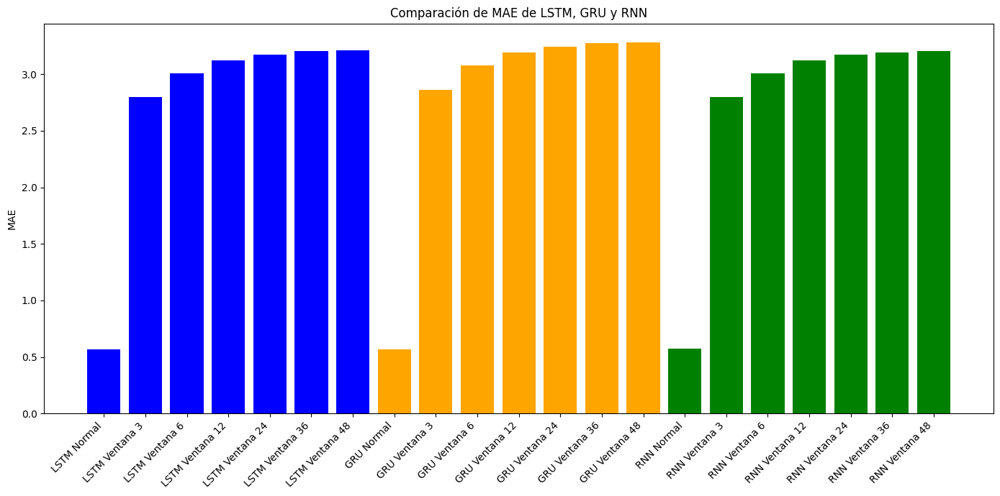

Posiciones ocupadas por cada modelo en todas las métricas:
LSTM: Posiciones = [1, 2, 3, 4, 5, 6, 7]
GRU: Posiciones = [8, 9, 10, 11, 12, 13, 14]
RNN: Posiciones = [15, 16, 17, 18, 19, 20, 21]


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Supongamos que estos son los MAE obtenidos de la prueba normal
mae_lstm_normal = mae_lstm
mae_gru_normal = mae_gru
mae_rnn_normal = mae_rnn

# MAE combinados en un solo diccionario para facilidad de graficar
mae_combined = {
    'LSTM Normal': mae_lstm_normal,
    'GRU Normal': mae_gru_normal,
    'RNN Normal': mae_rnn_normal,
    **{f'LSTM Ventana {k}': v for k, v in mae_results_lstm.items()},
    **{f'GRU Ventana {k}': v for k, v in mae_results.items()},
    **{f'RNN Ventana {k}': v for k, v in mae_results_rnn.items()}
}

# Separar los resultados por modelo (LSTM, GRU, RNN)
mae_lstm = {k: v for k, v in mae_combined.items() if k.startswith('LSTM')}
mae_gru = {k: v for k, v in mae_combined.items() if k.startswith('GRU')}
mae_rnn = {k: v for k, v in mae_combined.items() if k.startswith('RNN')}

# Ordenar las métricas de cada modelo de menor a mayor
mae_lstm_sorted = sorted(mae_lstm.items(), key=lambda x: x[1])
mae_gru_sorted = sorted(mae_gru.items(), key=lambda x: x[1])
mae_rnn_sorted = sorted(mae_rnn.items(), key=lambda x: x[1])

# Asignar colores por modelo
colors = {
    'LSTM': 'blue',
    'GRU': 'orange',
    'RNN': 'green'
}

# Concatenar las barras de los tres modelos (LSTM, GRU, RNN)
all_sorted = mae_lstm_sorted + mae_gru_sorted + mae_rnn_sorted

# Definir las posiciones de las barras agrupadas
bar_positions = np.arange(len(all_sorted))

# Crear los colores de las barras, asignando un color por modelo
bar_colors = [
    colors[label.split()[0]] for label, _ in all_sorted
]

# Crear el gráfico de barras
plt.figure(figsize=(14, 7))
bar_heights = [x[1] for x in all_sorted]
bar_labels = [x[0] for x in all_sorted]

plt.bar(bar_positions, bar_heights, color=bar_colors)

# Mostrar las etiquetas en el eje X, rotadas para que se lean fácilmente
plt.xticks(bar_positions, bar_labels, rotation=45, ha='right')
plt.ylabel('MAE')
plt.title('Comparación de MAE de LSTM, GRU y RNN')
plt.tight_layout()
plt.show()

# Calcular las posiciones de cada métrica para cada modelo
model_positions = {model: [] for model in colors.keys()}
for pos, (label, _) in enumerate(all_sorted):
    model_name = label.split()[0]
    model_positions[model_name].append(pos + 1)

# Imprimir las posiciones de cada modelo
print("Posiciones ocupadas por cada modelo en todas las métricas:")
for model, positions in model_positions.items():
    print(f'{model}: Posiciones = {positions}')


In [ ]:
import pandas as pd

# Crear el DataFrame a partir del diccionario mae_combined
df = pd.DataFrame(list(mae_combined.items()), columns=['Configuración', 'MAE'])

# Guardar el DataFrame en un archivo Excel
df.to_excel('mae_comparacion.xlsx', index=False)


<ipython-input-4-f3ac9446f4c2>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ventana_results['Ventana'] = ventana_results['Configuración'].str.extract(r'(\d+)$').astype(int)
<ipython-input-4-f3ac9446f4c2>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ventana_results['Modelo'] = ventana_results['Configuración'].str.split().str[0]


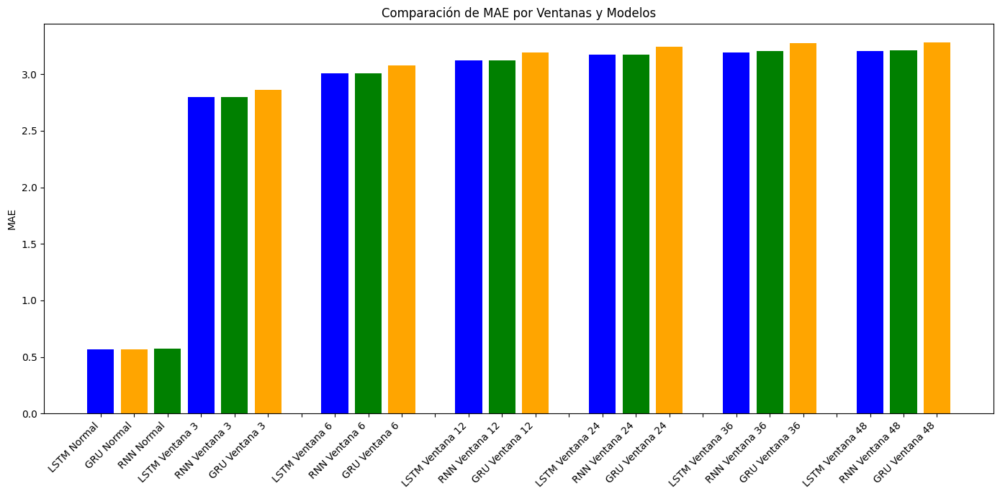

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Leer el archivo Excel
df = pd.read_excel('mae_comparacion.xlsx')

# Separar la prueba "Normal" y los resultados de las ventanas
normal_results = df[df['Configuración'].str.contains('Normal')]
ventana_results = df[~df['Configuración'].str.contains('Normal')]

# Extraer el número de ventana y el modelo de cada configuración en ventana_results
ventana_results['Ventana'] = ventana_results['Configuración'].str.extract(r'(\d+)$').astype(int)
ventana_results['Modelo'] = ventana_results['Configuración'].str.split().str[0]

# Ordenar por ventana y luego por MAE dentro de cada ventana
ventana_sorted = ventana_results.sort_values(by=['Ventana', 'MAE']).reset_index(drop=True)

# Crear el gráfico de barras
plt.figure(figsize=(14, 7))

# Agregar las barras de la prueba "Normal"
normal_labels = normal_results['Configuración'].tolist()
normal_values = normal_results['MAE'].tolist()
normal_colors = ['blue', 'orange', 'green']  # Colores para LSTM, GRU y RNN

plt.bar(range(len(normal_labels)), normal_values, color=normal_colors, label='Prueba Normal')

# Crear etiquetas y valores para las ventanas, con espacios entre cada grupo
bar_positions = len(normal_labels)
xtick_labels = normal_labels  # Iniciar etiquetas con "Normal"
ventana_groups = ventana_sorted.groupby('Ventana')
colors = {'LSTM': 'blue', 'GRU': 'orange', 'RNN': 'green'}

for ventana, group in ventana_groups:
    ventana_labels = group['Configuración'].tolist()
    ventana_values = group['MAE'].tolist()
    ventana_colors = [colors[modelo] for modelo in group['Modelo']]

    # Crear barras para el grupo de ventana actual
    plt.bar(range(bar_positions, bar_positions + len(ventana_labels)), ventana_values, color=ventana_colors)

    # Añadir etiquetas de ventana y un espacio vacío al final del grupo, solo si no es el último grupo
    xtick_labels.extend(ventana_labels)
    bar_positions += len(ventana_labels)

    # Agregar un espacio después de cada grupo, excepto el último
    if ventana != list(ventana_groups.groups.keys())[-1]:
        xtick_labels.append('')  # Agrega '' para crear un espacio
        bar_positions += 1

# Ajustes de etiquetas y estilo
plt.xticks(range(bar_positions), xtick_labels, rotation=45, ha='right')
plt.ylabel('MAE')
plt.title('Comparación de MAE por Ventanas y Modelos')
plt.tight_layout()
plt.show()


# Incertidumbre

## Bayesian

Epoch 1/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.0174 - val_loss: 0.0081
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0111 - val_loss: 0.0078
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0100 - val_loss: 0.0074
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0101 - val_loss: 0.0072
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0095 - val_loss: 0.0074
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0091 - val_loss: 0.0073
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0095 - val_loss: 0.0071
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0090 - val_loss: 0.0070
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0093 - val_loss: 0.0071
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0089 - val_loss: 0.0070
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0093 - val_loss: 0.0070
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━

PINC para el intervalo de confianza del 99%: 60.35%
PINC para el intervalo de confianza del 95%: 50.15%
MAE para la media de las predicciones: 0.5675


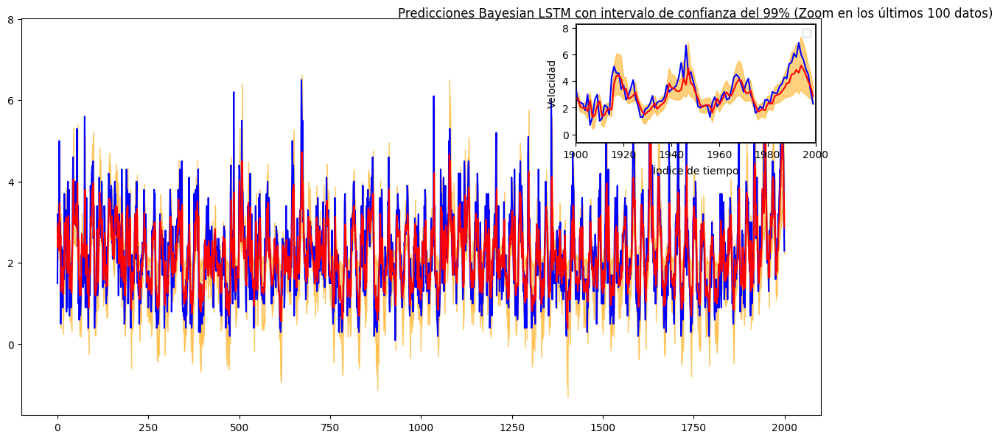

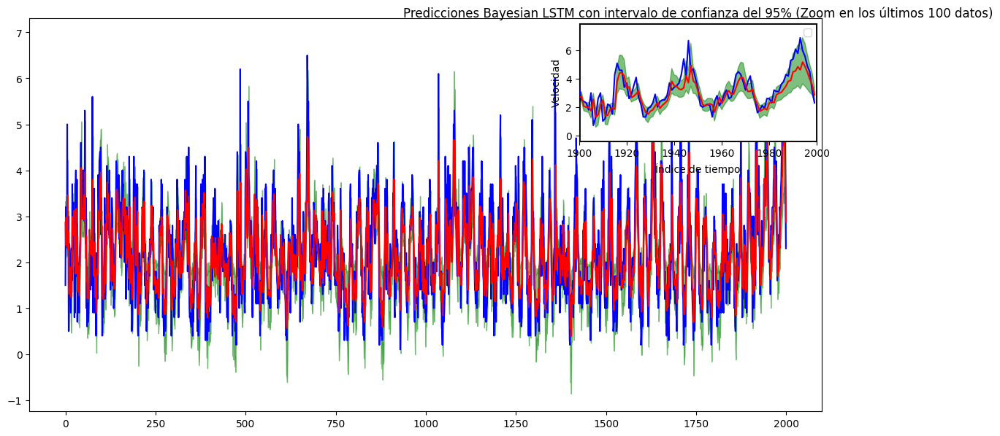

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
import tensorflow_probability as tfp
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout, Input
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Crear lags de la variable objetivo 'Velocidad'
num_lags_y = 36  # Por ejemplo, 36 lags para este caso
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000).dropna()

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para RNN en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Crear el modelo Bayesian LSTM usando Dropout
def create_bayesian_lstm(input_shape, lstm_units=100, dropout_rate=0.7):
    model = Sequential([
        Input(shape=input_shape),
        LSTM(lstm_units, activation='relu', return_sequences=False),
        Dropout(dropout_rate),  # Dropout para simular incertidumbre en la inferencia
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

# Preparar los datos (ajustar según tu conjunto de datos)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo Bayesian LSTM
model_bayesian_lstm = create_bayesian_lstm(input_shape=(1, X_train.shape[1]), lstm_units=100)

# Entrenar el modelo Bayesian LSTM
history = model_bayesian_lstm.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                                  validation_data=(X_test_reshaped, Y_test),
                                  verbose=1)

# Realizar predicciones bayesianas con MC Dropout
def predict_bayesian(model, X, num_samples=100):
    preds = []
    for _ in range(num_samples):
        pred = model(X, training=True).numpy()  # Dropout activado en inferencia
        preds.append(pred)
    return np.array(preds)

# Obtener las predicciones con incertidumbre
num_samples = 1000
bayesian_preds = predict_bayesian(model_bayesian_lstm, X_test_reshaped, num_samples=num_samples)

# Calcular el promedio de las predicciones
mean_preds = bayesian_preds.mean(axis=0)

# Desescalar las predicciones y Y_test
Y_test_descaled = scaler_Y.inverse_transform(Y_test)
mean_preds_descaled = scaler_Y.inverse_transform(mean_preds)

# Calcular intervalos de confianza al 99% y 95%
lower_bound_99 = np.percentile(bayesian_preds, 0.5, axis=0)
upper_bound_99 = np.percentile(bayesian_preds, 99.5, axis=0)
lower_bound_95 = np.percentile(bayesian_preds, 2.5, axis=0)
upper_bound_95 = np.percentile(bayesian_preds, 97.5, axis=0)

# Desescalar los límites de los intervalos
lower_bound_99_descaled = scaler_Y.inverse_transform(lower_bound_99)
upper_bound_99_descaled = scaler_Y.inverse_transform(upper_bound_99)
lower_bound_95_descaled = scaler_Y.inverse_transform(lower_bound_95)
upper_bound_95_descaled = scaler_Y.inverse_transform(upper_bound_95)

# Calcular el PINC para los intervalos de confianza al 99% y 95%
pinc_99 = np.mean((Y_test_descaled >= lower_bound_99_descaled) & (Y_test_descaled <= upper_bound_99_descaled))
pinc_95 = np.mean((Y_test_descaled >= lower_bound_95_descaled) & (Y_test_descaled <= upper_bound_95_descaled))
print(f'PINC para el intervalo de confianza del 99%: {pinc_99 * 100:.2f}%')
print(f'PINC para el intervalo de confianza del 95%: {pinc_95 * 100:.2f}%')

# Calcular el MAE para la media de las predicciones
mae_mean_preds = mean_absolute_error(Y_test_descaled, mean_preds_descaled)
print(f'MAE para la media de las predicciones: {mae_mean_preds:.4f}')

# Graficar los resultados para el intervalo de confianza del 99% con zoom en los últimos 100 datos
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(mean_preds_descaled, label='Predicciones (Media)', color='red')
plt.fill_between(range(len(mean_preds_descaled)), lower_bound_99_descaled.flatten(), upper_bound_99_descaled.flatten(), color='orange', alpha=0.5, label='Intervalo de predicción (99%)')

# Crear el área de zoom
axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")
axins.plot(Y_test_descaled, color='blue')
axins.plot(mean_preds_descaled, color='red')
axins.fill_between(range(len(mean_preds_descaled)), lower_bound_99_descaled.flatten(), upper_bound_99_descaled.flatten(), color='orange', alpha=0.5)

# Limitar el área de zoom a los últimos 100 datos
axins.set_xlim(len(mean_preds_descaled) - 100, len(mean_preds_descaled))
axins.set_ylim(min(Y_test_descaled[-100:].min(), lower_bound_99_descaled[-100:].min()) - 1,
               max(Y_test_descaled[-100:].max(), upper_bound_99_descaled[-100:].max()) + 1)

# Conectar el zoom con la gráfica principal
mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

plt.title('Predicciones Bayesian LSTM con intervalo de confianza del 99% (Zoom en los últimos 100 datos)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()

# Graficar los resultados para el intervalo de confianza del 95% con zoom en los últimos 100 datos
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(mean_preds_descaled, label='Predicciones (Media)', color='red')
plt.fill_between(range(len(mean_preds_descaled)), lower_bound_95_descaled.flatten(), upper_bound_95_descaled.flatten(), color='green', alpha=0.5, label='Intervalo de predicción (95%)')

# Crear el área de zoom
axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")
axins.plot(Y_test_descaled, color='blue')
axins.plot(mean_preds_descaled, color='red')
axins.fill_between(range(len(mean_preds_descaled)), lower_bound_95_descaled.flatten(), upper_bound_95_descaled.flatten(), color='green', alpha=0.5)

# Limitar el área de zoom a los últimos 100 datos
axins.set_xlim(len(mean_preds_descaled) - 100, len(mean_preds_descaled))
axins.set_ylim(min(Y_test_descaled[-100:].min(), lower_bound_95_descaled[-100:].min()) - 1,
               max(Y_test_descaled[-100:].max(), upper_bound_95_descaled[-100:].max()) + 1)

# Conectar el zoom con la gráfica principal
mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

plt.title('Predicciones Bayesian LSTM con intervalo de confianza del 95% (Zoom en los últimos 100 datos)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()




In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
import tensorflow_probability as tfp
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout, Input
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Crear lags de la variable objetivo 'Velocidad'
num_lags_y = 36  # Por ejemplo, 36 lags para este caso
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000).dropna()

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para RNN en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Crear el modelo Bayesian LSTM usando Dropout
def create_bayesian_lstm(input_shape, lstm_units=100, dropout_rate=0.7):
    model = Sequential([
        Input(shape=input_shape),
        LSTM(lstm_units, activation='relu', return_sequences=False),
        Dropout(dropout_rate),  # Dropout para simular incertidumbre en la inferencia
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

# Definir el modelo Bayesian LSTM
model_bayesian_lstm = create_bayesian_lstm(input_shape=(1, X_train.shape[1]), lstm_units=100)

# Entrenar el modelo Bayesian LSTM
history = model_bayesian_lstm.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                                  validation_data=(X_test_reshaped, Y_test),
                                  verbose=1)

# Realizar predicciones bayesianas con MC Dropout
def predict_bayesian(model, X, num_samples=100):
    preds = []
    for _ in range(num_samples):
        pred = model(X, training=True).numpy()  # Dropout activado en inferencia
        preds.append(pred)
    return np.array(preds)

# Obtener las predicciones con incertidumbre
num_samples = 1000
bayesian_preds = predict_bayesian(model_bayesian_lstm, X_test_reshaped, num_samples=num_samples)

# Calcular el promedio de las predicciones
mean_preds = bayesian_preds.mean(axis=0)

# Desescalar las predicciones y Y_test
Y_test_descaled = scaler_Y.inverse_transform(Y_test)
mean_preds_descaled = scaler_Y.inverse_transform(mean_preds)

# Calcular RMSE y NRMSE
rmse_mean_preds = mean_squared_error(Y_test_descaled, mean_preds_descaled, squared=False)
nrmse_mean_preds = rmse_mean_preds / (Y_test_descaled.max() - Y_test_descaled.min())

# Calcular intervalos de confianza al 99% y 95%
lower_bound_99 = np.percentile(bayesian_preds, 0.5, axis=0)
upper_bound_99 = np.percentile(bayesian_preds, 99.5, axis=0)
lower_bound_95 = np.percentile(bayesian_preds, 2.5, axis=0)
upper_bound_95 = np.percentile(bayesian_preds, 97.5, axis=0)

# Desescalar los límites de los intervalos
lower_bound_99_descaled = scaler_Y.inverse_transform(lower_bound_99)
upper_bound_99_descaled = scaler_Y.inverse_transform(upper_bound_99)
lower_bound_95_descaled = scaler_Y.inverse_transform(lower_bound_95)
upper_bound_95_descaled = scaler_Y.inverse_transform(upper_bound_95)

# Calcular el PINC para los intervalos de confianza al 99% y 95%
pinc_99 = np.mean((Y_test_descaled >= lower_bound_99_descaled) & (Y_test_descaled <= upper_bound_99_descaled))
pinc_95 = np.mean((Y_test_descaled >= lower_bound_95_descaled) & (Y_test_descaled <= upper_bound_95_descaled))
print(f'PINC para el intervalo de confianza del 99%: {pinc_99 * 100:.2f}%')
print(f'PINC para el intervalo de confianza del 95%: {pinc_95 * 100:.2f}%')

# Calcular el MAE para la media de las predicciones
mae_mean_preds = mean_absolute_error(Y_test_descaled, mean_preds_descaled)
print(f'MAE para la media de las predicciones: {mae_mean_preds:.4f}')
print(f'RMSE para la media de las predicciones: {rmse_mean_preds:.4f}')
print(f'NRMSE para la media de las predicciones: {nrmse_mean_preds:.4f}')


Epoch 1/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.0221 - val_loss: 0.0088
Epoch 2/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0116 - val_loss: 0.0077
Epoch 3/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0100 - val_loss: 0.0072
Epoch 4/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0097 - val_loss: 0.0071
Epoch 5/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0097 - val_loss: 0.0074
Epoch 6/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0092 - val_loss: 0.0071
Epoch 7/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0095 - val_loss: 0.0073
Epoch 8/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.0088 - val_loss: 0.0071
Epoch 9/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0097 - val_loss: 0.0074
Epoch 10/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0089 - val_loss: 0.0072
Epoch 11/100
800/800 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0090 - val_loss: 0.0070
Epoch 12/100
800/800 ━━━━━━━━━━━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [79]:
# Crear DataFrame para almacenar los resultados
resultados_df = pd.DataFrame({
    "Valores Reales (Y_test)": Y_test_descaled.flatten(),
    "Predicciones (Media)": mean_preds_descaled.flatten(),
    "Limite Inferior (95%)": lower_bound_95_descaled.flatten(),
    "Limite Superior (95%)": upper_bound_95_descaled.flatten(),
    "Limite Inferior (99%)": lower_bound_99_descaled.flatten(),
    "Limite Superior (99%)": upper_bound_99_descaled.flatten()
})

# Guardar el DataFrame en un archivo Excel
resultados_df.to_excel("resultados_bayesian_lstm.xlsx", index=False, sheet_name="Resultados")


In [ ]:
import numpy as np

# Obtener las predicciones para todas las instancias de interés
predictions = model_bayesian_lstm.predict(X_test.reshape(X_test.shape[0], 1, X_test.shape[1]))

# Guardar las predicciones en un archivo
np.save('model_predictions.npy', predictions)



63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


In [ ]:
mean_preds_descaled

array([[2.8857734],
       [2.392577 ],
       [3.0444689],
       ...,
       [4.2086496],
       [3.7464023],
       [3.0139797]], dtype=float32)

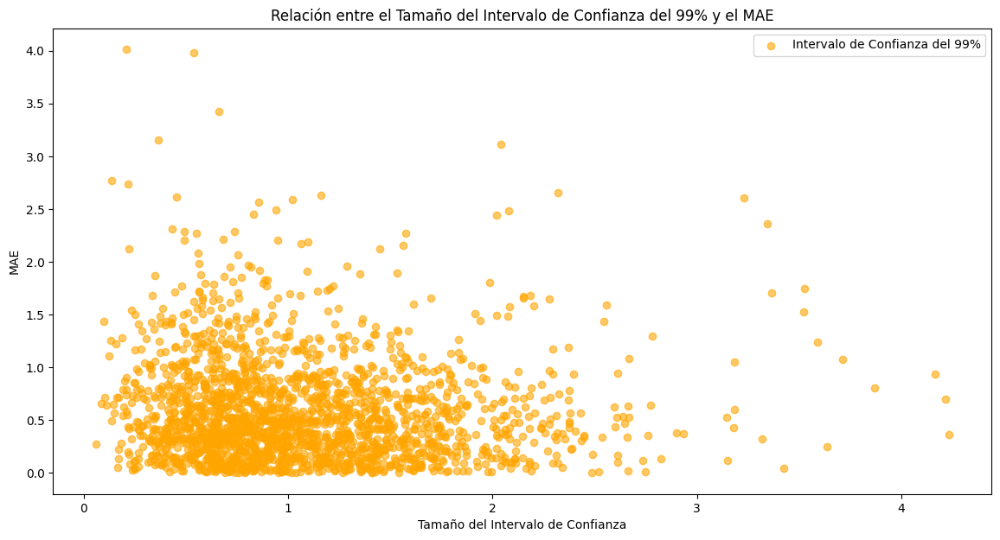

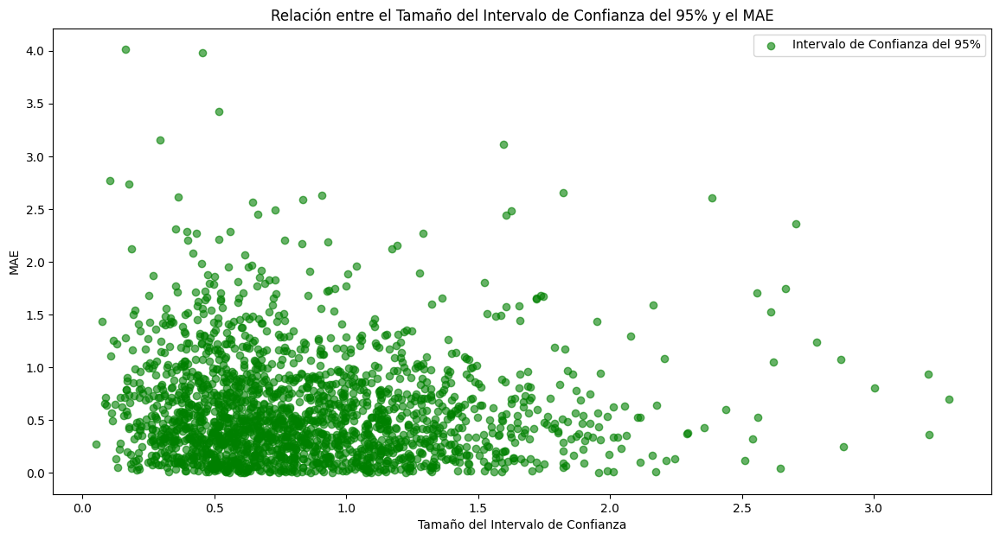

In [ ]:
# Calcular el tamaño del intervalo para cada predicción
interval_size_99 = (upper_bound_99_descaled - lower_bound_99_descaled).flatten()
interval_size_95 = (upper_bound_95_descaled - lower_bound_95_descaled).flatten()

# Calcular el MAE individual para cada predicción
mae_per_point = np.abs(Y_test_descaled.flatten() - mean_preds_descaled.flatten())

# Graficar dispersión entre el tamaño del intervalo al 99% y el MAE
plt.figure(figsize=(14, 7))
plt.scatter(interval_size_99, mae_per_point, color='orange', alpha=0.6, label='Intervalo de Confianza del 99%')
plt.xlabel('Tamaño del Intervalo de Confianza')
plt.ylabel('MAE')
plt.title('Relación entre el Tamaño del Intervalo de Confianza del 99% y el MAE')
plt.legend()
plt.show()

# Graficar dispersión entre el tamaño del intervalo al 95% y el MAE
plt.figure(figsize=(14, 7))
plt.scatter(interval_size_95, mae_per_point, color='green', alpha=0.6, label='Intervalo de Confianza del 95%')
plt.xlabel('Tamaño del Intervalo de Confianza')
plt.ylabel('MAE')
plt.title('Relación entre el Tamaño del Intervalo de Confianza del 95% y el MAE')
plt.legend()
plt.show()


In [ ]:
np.save('bayesian_preds.npy', bayesian_preds)


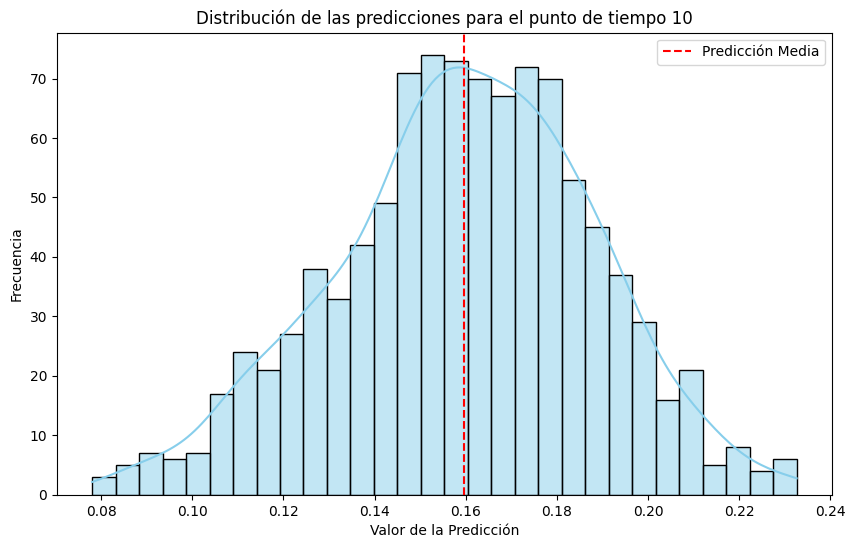

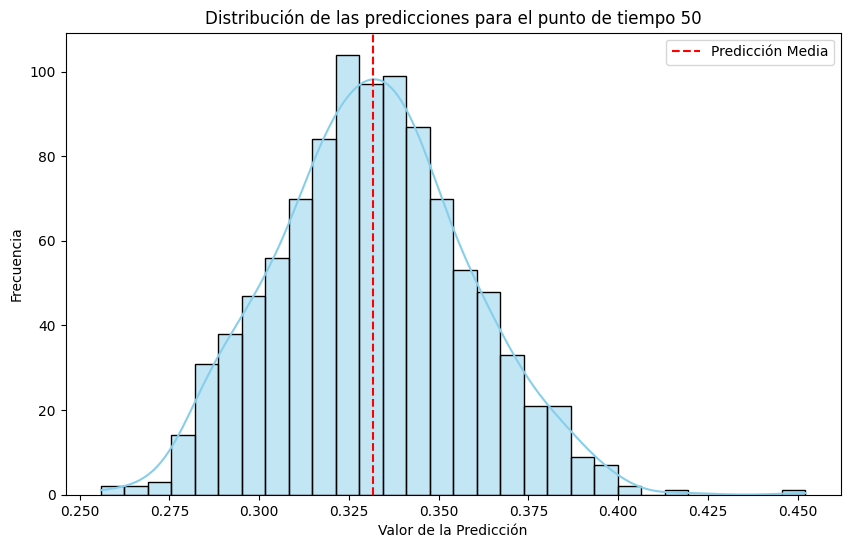

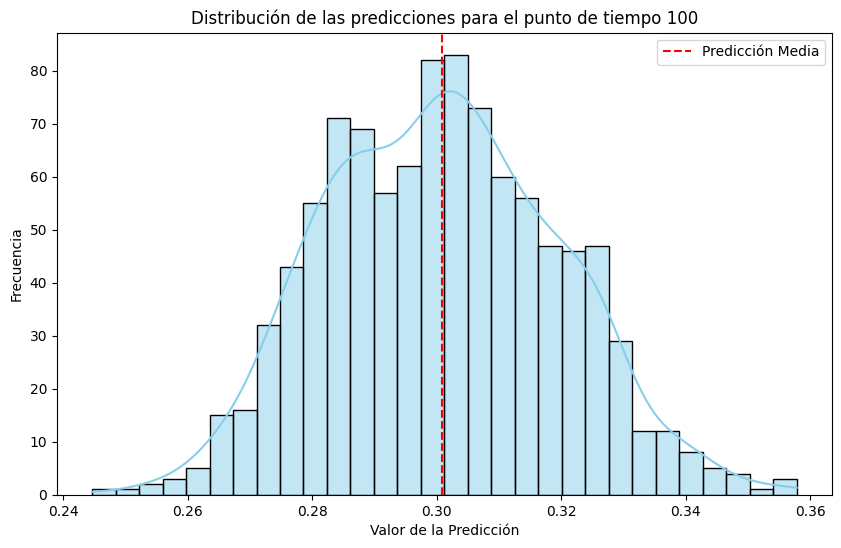

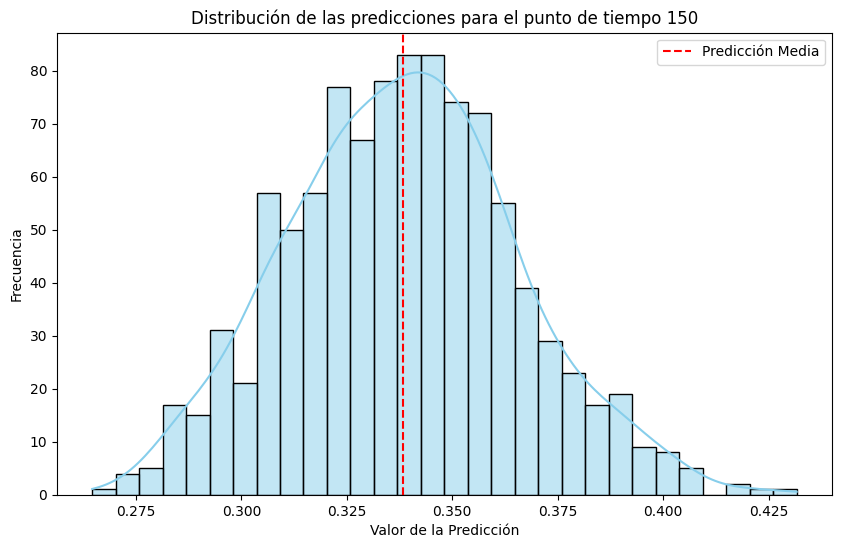

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Cargar las predicciones bayesianas y el promedio de las predicciones
bayesian_preds_load = np.load('bayesian_preds.npy')
mean_preds = bayesian_preds_load.mean(axis=0)  # Asegurarse de que el promedio se calcula si no está guardado

# Definir algunos puntos de tiempo para visualizar la distribución de las predicciones
time_points = [10, 50, 100, 150]  # Cambiar según lo que te interese

# Graficar la distribución de las predicciones para cada punto de tiempo seleccionado
for t in time_points:
    plt.figure(figsize=(10, 6))
    sns.histplot(bayesian_preds_load[:, t, 0], kde=True, color='skyblue', bins=30)
    plt.title(f'Distribución de las predicciones para el punto de tiempo {t}')
    plt.xlabel('Valor de la Predicción')
    plt.ylabel('Frecuencia')
    plt.axvline(mean_preds[t, 0], color='red', linestyle='--', label='Predicción Media')
    plt.legend()
    plt.show()


In [ ]:
# Desescalar las predicciones bayesianas
bayesian_preds_descaled = scaler_Y.inverse_transform(bayesian_preds.reshape(-1, 1)).reshape(bayesian_preds.shape)

# Guardar las predicciones desescaladas en formato .npy
np.save('bayesian_preds_descaled.npy', bayesian_preds_descaled)

print("Predicciones bayesianas desescaladas guardadas en 'bayesian_preds_descaled.npy'.")


Predicciones bayesianas desescaladas guardadas en 'bayesian_preds_descaled.npy'.


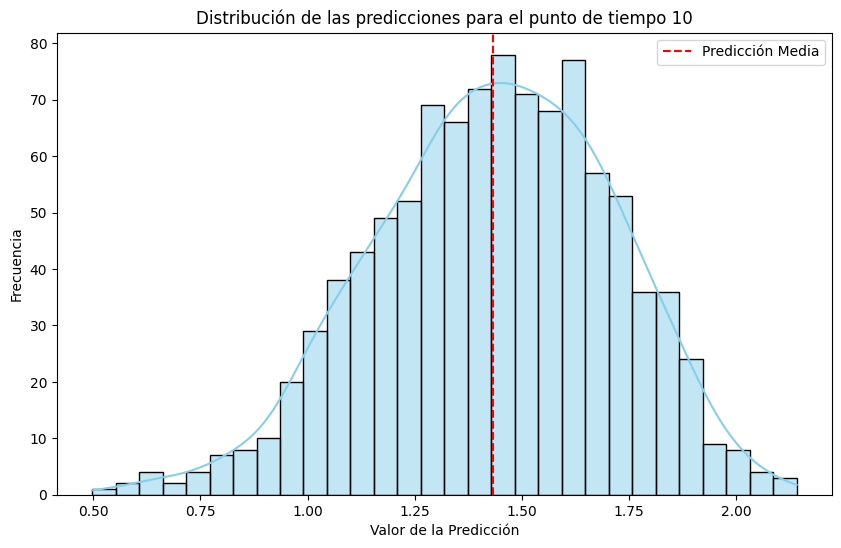

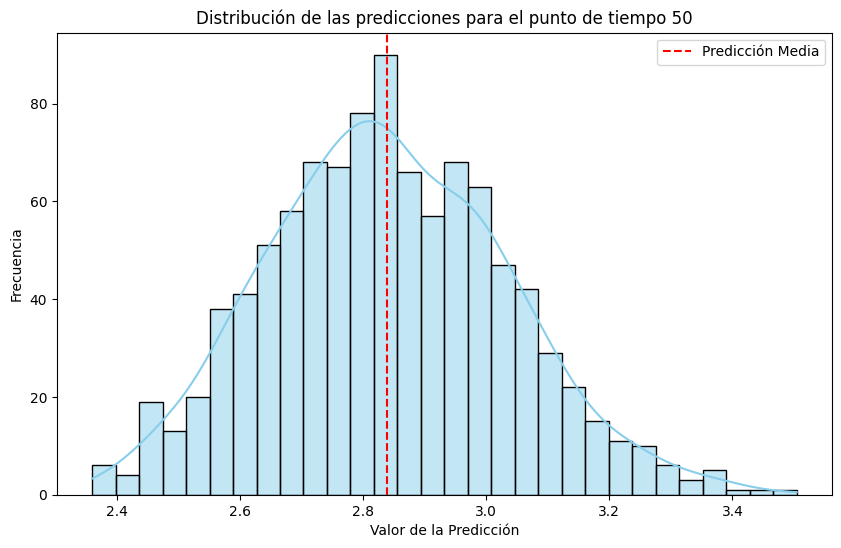

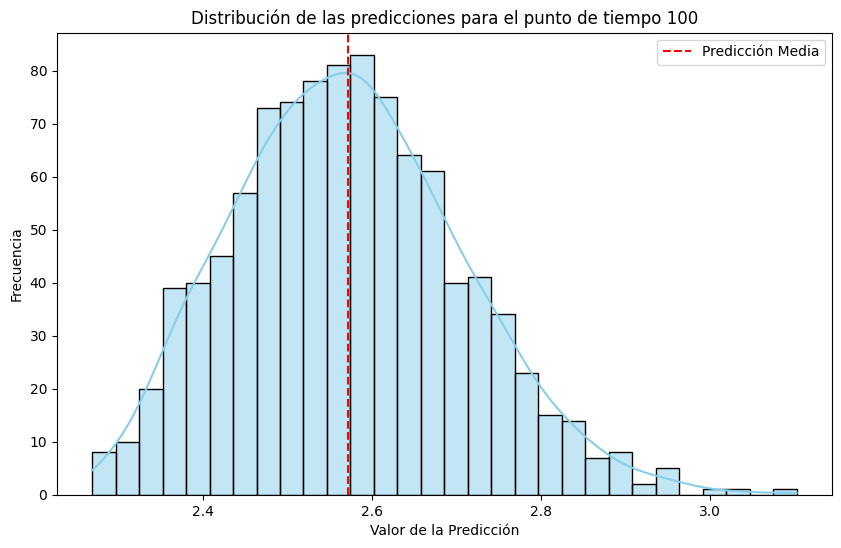

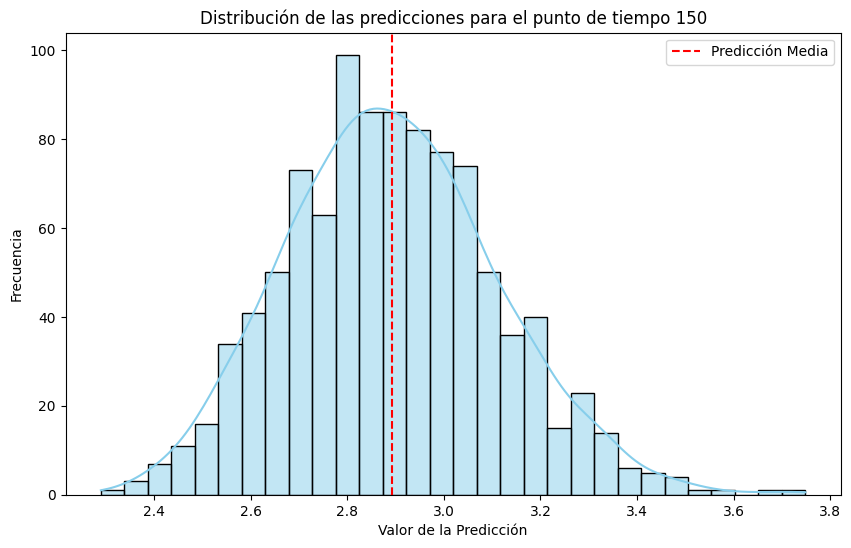

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

mean_preds = bayesian_preds_descaled.mean(axis=0)  # Asegurarse de que el promedio se calcula si no está guardado

# Definir algunos puntos de tiempo para visualizar la distribución de las predicciones
time_points = [10, 50, 100, 150]  # Cambiar según lo que te interese

# Graficar la distribución de las predicciones para cada punto de tiempo seleccionado
for t in time_points:
    plt.figure(figsize=(10, 6))
    sns.histplot(bayesian_preds_descaled[:, t, 0], kde=True, color='skyblue', bins=30)
    plt.title(f'Distribución de las predicciones para el punto de tiempo {t}')
    plt.xlabel('Valor de la Predicción')
    plt.ylabel('Frecuencia')
    plt.axvline(mean_preds[t, 0], color='red', linestyle='--', label='Predicción Media')
    plt.legend()
    plt.show()


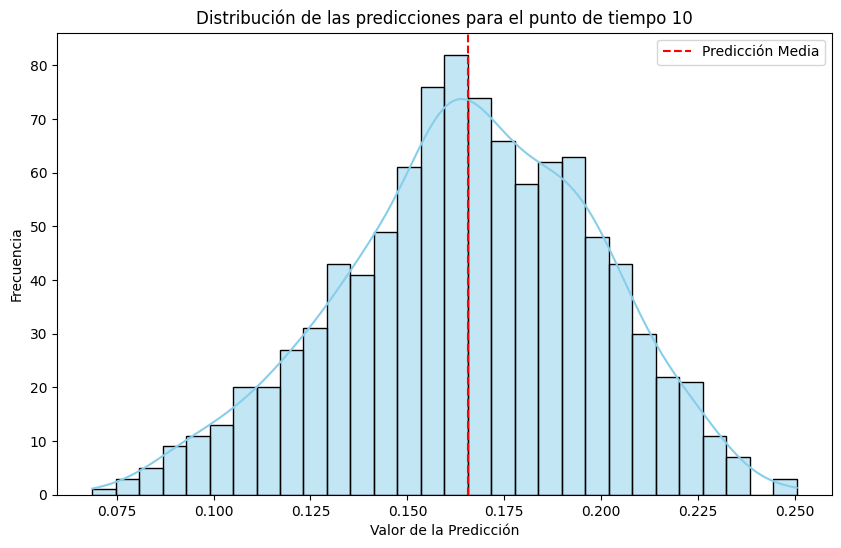

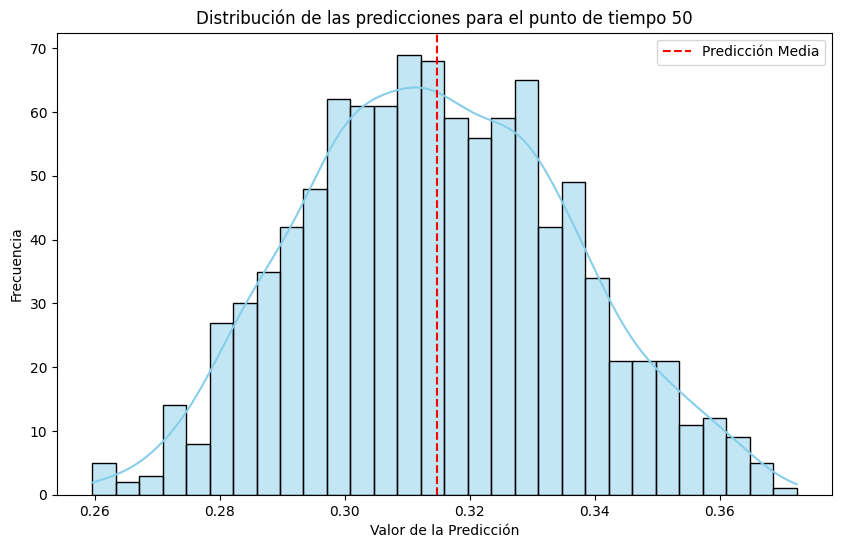

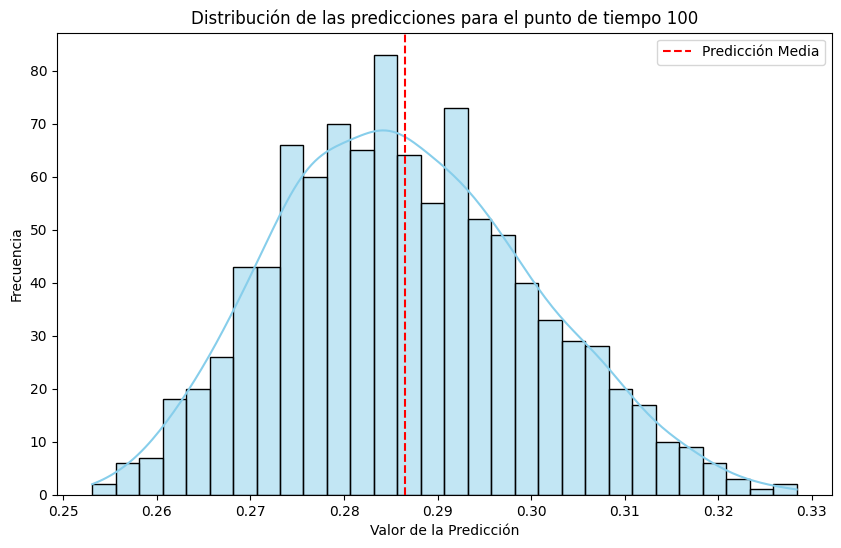

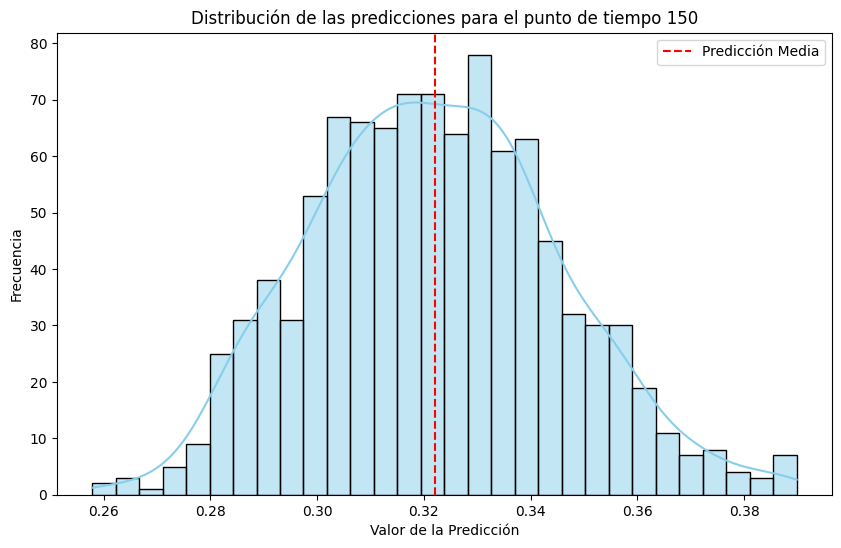

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Definir algunos puntos de tiempo para visualizar la distribución de las predicciones
time_points = [10, 50, 100, 150]  # Puedes cambiar estos valores según lo que te interese

# Graficar la distribución de las predicciones para cada punto de tiempo seleccionado
for t in time_points:
    plt.figure(figsize=(10, 6))
    sns.histplot(bayesian_preds[:, t, 0], kde=True, color='skyblue', bins=30)
    plt.title(f'Distribución de las predicciones para el punto de tiempo {t}')
    plt.xlabel('Valor de la Predicción')
    plt.ylabel('Frecuencia')
    plt.axvline(mean_preds[t, 0], color='red', linestyle='--', label='Predicción Media')
    plt.legend()
    plt.show()

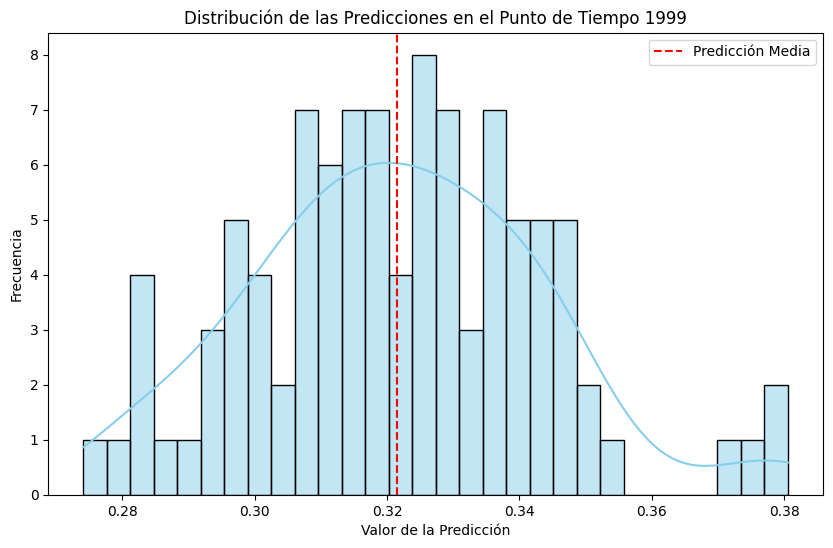

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter

# Configurar la figura para la animación
fig, ax = plt.subplots(figsize=(10, 6))
plt.xlabel('Valor de la Predicción')
plt.ylabel('Frecuencia')
plt.title('Distribución de las Predicciones en el Tiempo')

# Función de actualización para cada frame de la animación
def update(t):
    ax.clear()
    sns.histplot(bayesian_preds[:, t, 0], kde=True, color='skyblue', bins=30, ax=ax)
    ax.axvline(mean_preds[t, 0], color='red', linestyle='--', label='Predicción Media')
    ax.legend()
    ax.set_title(f'Distribución de las Predicciones en el Punto de Tiempo {t}')
    ax.set_xlabel('Valor de la Predicción')
    ax.set_ylabel('Frecuencia')

# Crear la animación
anim = FuncAnimation(fig, update, frames=range(len(Y_test_descaled)), interval=100)

# Guardar la animación como un GIF
anim.save("distribucion_predicciones.gif", writer=PillowWriter(fps=10))
plt.show()


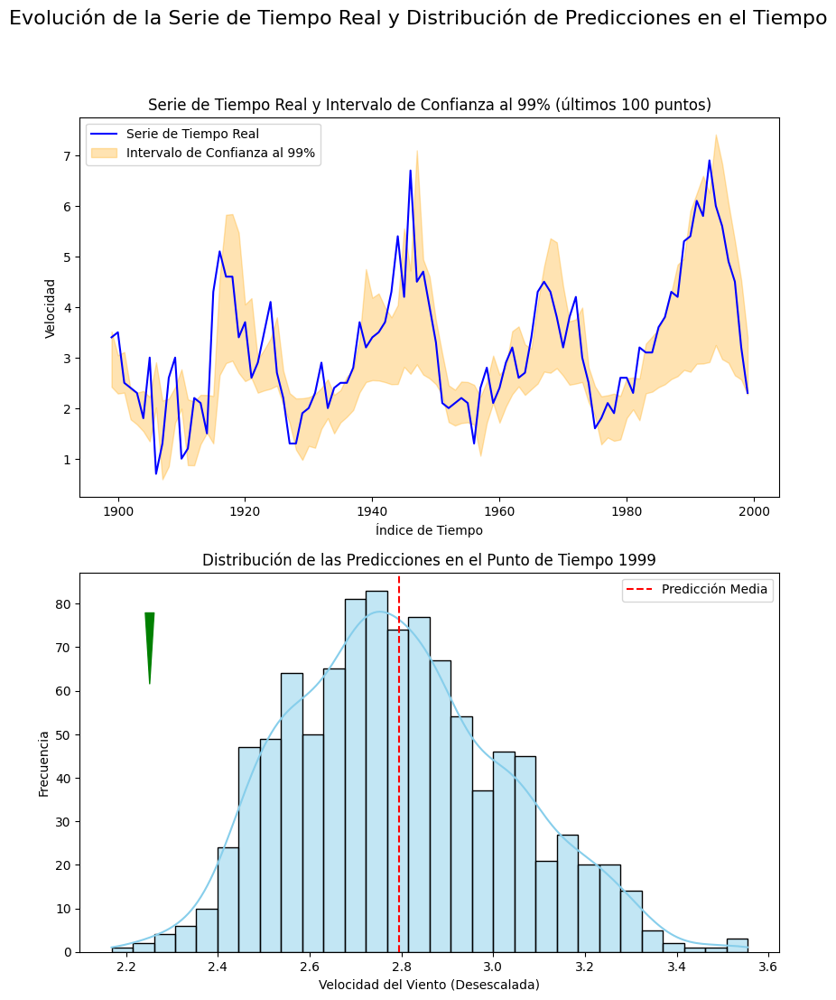

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter

# Configurar la figura para la animación
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 12))
fig.suptitle("Evolución de la Serie de Tiempo Real y Distribución de Predicciones en el Tiempo", fontsize=16)

# Desescalar las predicciones de cada muestra en bayesian_preds para obtener bayesian_preds_descaled
bayesian_preds_descaled = scaler_Y.inverse_transform(bayesian_preds.reshape(-1, 1)).reshape(bayesian_preds.shape)

# Función de actualización para cada frame de la animación
def update(t):
    # Si t > 100, se ralentiza la animación duplicando cada cuadro
    if t > 100:
        frame_index = 100 + (t - 100) // 3  # Reducción de velocidad a un tercio después de 100
        if frame_index >= len(Y_test_descaled):
            return  # Detiene la animación si excede la longitud de los datos
    else:
        frame_index = t

    ax1.clear()
    ax2.clear()

    # Limitar la gráfica de serie de tiempo a los últimos 100 puntos
    start = max(0, frame_index - 100)

    # Graficar la serie de tiempo real para los últimos 100 puntos
    ax1.plot(range(start, frame_index+1), Y_test_descaled[start:frame_index+1], label="Serie de Tiempo Real", color="blue")

    # Graficar el intervalo de confianza al 99%
    ax1.fill_between(
        range(start, frame_index+1),
        lower_bound_99_descaled[start:frame_index+1].flatten(),
        upper_bound_99_descaled[start:frame_index+1].flatten(),
        color='orange', alpha=0.3, label="Intervalo de Confianza al 99%"
    )

    ax1.set_title("Serie de Tiempo Real y Intervalo de Confianza al 99% (últimos 100 puntos)")
    ax1.set_xlabel("Índice de Tiempo")
    ax1.set_ylabel("Velocidad")
    ax1.legend()

    # Gráfica de la distribución de las predicciones desescaladas en el punto de tiempo actual t
    sns.histplot(bayesian_preds_descaled[:, frame_index, 0], kde=True, color='skyblue', bins=30, ax=ax2)
    ax2.axvline(mean_preds_descaled[frame_index, 0], color='red', linestyle='--', label='Predicción Media')
    ax2.set_title(f'Distribución de las Predicciones en el Punto de Tiempo {frame_index}')
    ax2.set_xlabel("Velocidad del Viento (Desescalada)")
    ax2.set_ylabel("Frecuencia")
    ax2.legend()

    # Agregar la flecha de cambio en la predicción
    if frame_index > 0:
        # Cambio en la predicción y en la serie real
        delta_pred = mean_preds[frame_index, 0] - mean_preds[frame_index - 1, 0]
        delta_real = Y_test_descaled[frame_index, 0] - Y_test_descaled[frame_index - 1, 0]

        # Definir dirección y color de la flecha
        direction = 'up' if delta_pred > 0 else 'down'
        color = 'green' if (delta_pred > 0 and delta_real > 0) or (delta_pred < 0 and delta_real < 0) else 'red'

        # Dibujar la flecha en la esquina superior izquierda
        if direction == 'up':
            ax2.annotate('', xy=(0.1, 0.9), xytext=(0.1, 0.7),
                         arrowprops=dict(facecolor=color, edgecolor=color, arrowstyle="wedge,tail_width=0.7"),
                         xycoords='axes fraction')
        else:
            ax2.annotate('', xy=(0.1, 0.7), xytext=(0.1, 0.9),
                         arrowprops=dict(facecolor=color, edgecolor=color, arrowstyle="wedge,tail_width=0.7"),
                         xycoords='axes fraction')

# Crear la animación
# Aumenta el número total de frames para simular la ralentización después de 100
total_frames = 100 + 3 * (len(Y_test_descaled) - 100)
anim = FuncAnimation(fig, update, frames=range(total_frames), interval=100)

# Guardar la animación como un GIF
anim.save("evolucion_serie_tiempo_intervalo_99_distribucion_predicciones.gif", writer=PillowWriter(fps=10))
plt.show()


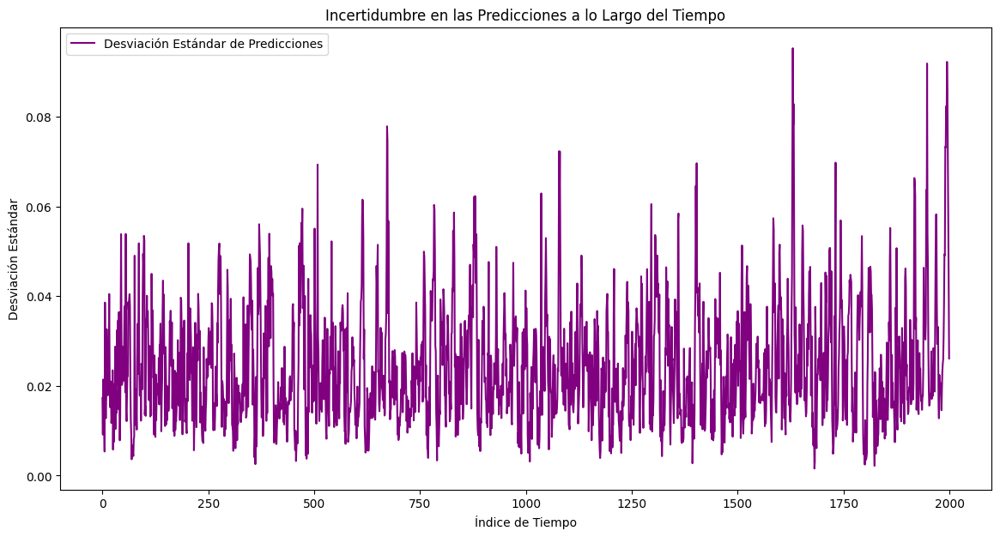

In [ ]:
# Calcular la desviación estándar de las predicciones en cada punto de tiempo
std_preds = bayesian_preds.std(axis=0).flatten()

# Graficar la desviación estándar a lo largo del tiempo
plt.figure(figsize=(14, 7))
plt.plot(std_preds, label='Desviación Estándar de Predicciones', color='purple')
plt.xlabel('Índice de Tiempo')
plt.ylabel('Desviación Estándar')
plt.title('Incertidumbre en las Predicciones a lo Largo del Tiempo')
plt.legend()
plt.show()


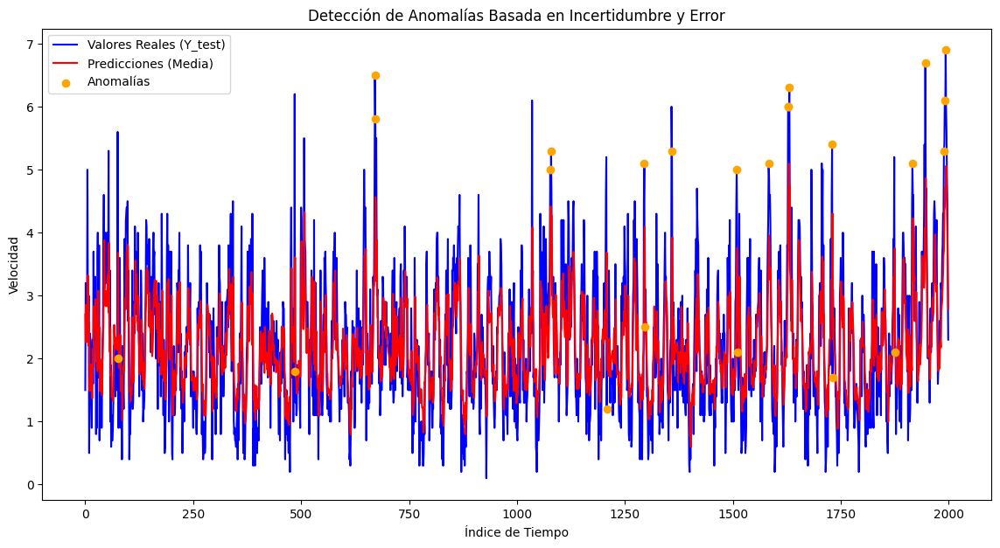

In [ ]:
# Calcular el error absoluto en cada punto
absolute_errors = np.abs(Y_test_descaled.flatten() - mean_preds_descaled.flatten())

# Establecer umbrales de incertidumbre y error para detectar anomalías
uncertainty_threshold = np.percentile(std_preds, 90)  # Ejemplo: percentil 90 de incertidumbre
error_threshold = np.percentile(absolute_errors, 90)  # Ejemplo: percentil 90 de error

# Detectar puntos de anomalía
anomalies = (std_preds > uncertainty_threshold) & (absolute_errors > error_threshold)

# Graficar la serie de tiempo y marcar las anomalías
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(mean_preds_descaled, label='Predicciones (Media)', color='red')
plt.scatter(np.arange(len(Y_test_descaled))[anomalies], Y_test_descaled[anomalies], color='orange', label='Anomalías', zorder=5)
plt.xlabel('Índice de Tiempo')
plt.ylabel('Velocidad')
plt.title('Detección de Anomalías Basada en Incertidumbre y Error')
plt.legend()
plt.show()


In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
import tensorflow_probability as tfp
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout, Input
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Crear lags de la variable objetivo 'Velocidad'
num_lags_y = 36  # Por ejemplo, 36 lags para este caso
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000).dropna()

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values  # Variables X actuales + lags de Y
Y = data_lagged['Velocidad'].values  # Variable objetivo

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para RNN en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Crear el modelo Bayesian LSTM usando Dropout
def create_bayesian_lstm(input_shape, lstm_units=100, dropout_rate=0.7):
    model = Sequential([
        Input(shape=input_shape),
        LSTM(lstm_units, activation='relu', return_sequences=False),
        Dropout(dropout_rate),  # Dropout para simular incertidumbre en la inferencia
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

# Preparar los datos (ajustar según tu conjunto de datos)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Definir el modelo Bayesian LSTM
model_bayesian_lstm = create_bayesian_lstm(input_shape=(1, X_train.shape[1]), lstm_units=100)

# Entrenar el modelo Bayesian LSTM
history = model_bayesian_lstm.fit(X_train_reshaped, Y_train, epochs=100, batch_size=10,
                                  validation_data=(X_test_reshaped, Y_test),
                                  verbose=1)

# Realizar predicciones bayesianas con MC Dropout
def predict_bayesian(model, X, num_samples=100):
    preds = []
    for _ in range(num_samples):
        pred = model(X, training=True).numpy()  # Dropout activado en inferencia
        preds.append(pred)
    return np.array(preds)

# Obtener las predicciones con incertidumbre
num_samples = 1000
bayesian_preds = predict_bayesian(model_bayesian_lstm, X_test_reshaped, num_samples=num_samples)

# Calcular el promedio de las predicciones
mean_preds = bayesian_preds.mean(axis=0)

# Desescalar las predicciones y Y_test
Y_test_descaled = scaler_Y.inverse_transform(Y_test)
mean_preds_descaled = scaler_Y.inverse_transform(mean_preds)

# Calcular intervalos de confianza al 99% y 95%
lower_bound_99 = np.percentile(bayesian_preds, 0.5, axis=0)
upper_bound_99 = np.percentile(bayesian_preds, 99.5, axis=0)
lower_bound_95 = np.percentile(bayesian_preds, 2.5, axis=0)
upper_bound_95 = np.percentile(bayesian_preds, 97.5, axis=0)

# Desescalar los límites de los intervalos
lower_bound_99_descaled = scaler_Y.inverse_transform(lower_bound_99)
upper_bound_99_descaled = scaler_Y.inverse_transform(upper_bound_99)
lower_bound_95_descaled = scaler_Y.inverse_transform(lower_bound_95)
upper_bound_95_descaled = scaler_Y.inverse_transform(upper_bound_95)

# Calcular el PINC para los intervalos de confianza al 99% y 95%
pinc_99 = np.mean((Y_test_descaled >= lower_bound_99_descaled) & (Y_test_descaled <= upper_bound_99_descaled))
pinc_95 = np.mean((Y_test_descaled >= lower_bound_95_descaled) & (Y_test_descaled <= upper_bound_95_descaled))
print(f'PINC para el intervalo de confianza del 99%: {pinc_99 * 100:.2f}%')
print(f'PINC para el intervalo de confianza del 95%: {pinc_95 * 100:.2f}%')

# Calcular el MAE para la media de las predicciones
mae_mean_preds = mean_absolute_error(Y_test_descaled, mean_preds_descaled)
print(f'MAE para la media de las predicciones: {mae_mean_preds:.4f}')

# Graficar los resultados para el intervalo de confianza del 99% con zoom en los últimos 100 datos
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(mean_preds_descaled, label='Predicciones (Media)', color='red')
plt.fill_between(range(len(mean_preds_descaled)), lower_bound_99_descaled.flatten(), upper_bound_99_descaled.flatten(), color='orange', alpha=0.5, label='Intervalo de predicción (99%)')

# Crear el área de zoom
axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")
axins.plot(Y_test_descaled, color='blue')
axins.plot(mean_preds_descaled, color='red')
axins.fill_between(range(len(mean_preds_descaled)), lower_bound_99_descaled.flatten(), upper_bound_99_descaled.flatten(), color='orange', alpha=0.5)

# Limitar el área de zoom a los últimos 100 datos
axins.set_xlim(len(mean_preds_descaled) - 100, len(mean_preds_descaled))
axins.set_ylim(min(Y_test_descaled[-100:].min(), lower_bound_99_descaled[-100:].min()) - 1,
               max(Y_test_descaled[-100:].max(), upper_bound_99_descaled[-100:].max()) + 1)

# Conectar el zoom con la gráfica principal
mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

plt.title('Predicciones Bayesian LSTM con intervalo de confianza del 99% (Zoom en los últimos 100 datos)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()

# Graficar los resultados para el intervalo de confianza del 95% con zoom en los últimos 100 datos
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(mean_preds_descaled, label='Predicciones (Media)', color='red')
plt.fill_between(range(len(mean_preds_descaled)), lower_bound_95_descaled.flatten(), upper_bound_95_descaled.flatten(), color='green', alpha=0.5, label='Intervalo de predicción (95%)')

# Crear el área de zoom
axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")
axins.plot(Y_test_descaled, color='blue')
axins.plot(mean_preds_descaled, color='red')
axins.fill_between(range(len(mean_preds_descaled)), lower_bound_95_descaled.flatten(), upper_bound_95_descaled.flatten(), color='green', alpha=0.5)

# Limitar el área de zoom a los últimos 100 datos
axins.set_xlim(len(mean_preds_descaled) - 100, len(mean_preds_descaled))
axins.set_ylim(min(Y_test_descaled[-100:].min(), lower_bound_95_descaled[-100:].min()) - 1,
               max(Y_test_descaled[-100:].max(), upper_bound_95_descaled[-100:].max()) + 1)

# Conectar el zoom con la gráfica principal
mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

plt.title('Predicciones Bayesian LSTM con intervalo de confianza del 95% (Zoom en los últimos 100 datos)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()




In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Lista de tamaños de ventana a probar
window_sizes = [6, 12, 24, 36, 48]

# Diccionario para almacenar los MAE promedio y PINC por tamaño de ventana
mae_results_bayesian = {}
pinc_results_bayesian = {}

# Número de muestras para MC Dropout
num_samples = 1000

# Función para hacer predicciones bayesianas con MC Dropout
def predict_bayesian(model, X, num_samples=100):
    preds = []
    for _ in range(num_samples):
        pred = model(X, training=True).numpy()  # Dropout activado en inferencia
        preds.append(pred)
    return np.array(preds)

# Iterar sobre diferentes tamaños de ventana
for window_size in window_sizes:
    print(f'Comenzando la prueba con una ventana de {window_size} pasos...')

    # Preparar los datos de prueba para la ventana deslizante
    X_test_window = X_test_reshaped.copy()
    Y_test_window = Y_test.copy()

    # Listas para almacenar los MAE y PINC de cada ventana
    mae_list = []
    pinc_list = []

    # Lista para almacenar todas las predicciones concatenadas
    all_preds = []
    lower_bounds = []
    upper_bounds = []

    # Iterar sobre el conjunto de prueba en ventanas de longitud `window_size`
    for start in range(0, len(X_test_window) - window_size, window_size):
        # Ventana actual de `window_size`
        X_window = X_test_window[start:start + window_size]
        Y_actual = Y_test_window[start:start + window_size]

        Y_preds_window = []

        # Realizar predicciones en la ventana de tamaño actual usando el modelo bayesiano
        for i in range(window_size):
            # Obtener predicciones bayesianas para el paso actual
            bayesian_preds = predict_bayesian(model_bayesian_lstm, X_window[i].reshape(1, 1, X_window.shape[2]), num_samples)
            mean_pred = bayesian_preds.mean(axis=0)[0, 0]
            lower_bound = bayesian_preds.min(axis=0)[0, 0]
            upper_bound = bayesian_preds.max(axis=0)[0, 0]

            Y_preds_window.append(mean_pred)
            lower_bounds.append(lower_bound)
            upper_bounds.append(upper_bound)

            # Actualizar la entrada para la próxima predicción
            if i < window_size - 1:
                X_window[i + 1, 0, 1:] = X_window[i + 1, 0, :-1]  # Desplazar los valores de los lags hacia atrás
                X_window[i + 1, 0, 0] = scaler_Y.transform([[mean_pred]])[0, 0]  # Reemplazar el primer lag con la predicción actual

        # Guardar las predicciones de la ventana
        all_preds.extend(Y_preds_window)

        # Calcular el MAE de la ventana actual
        mae_window = mean_absolute_error(scaler_Y.inverse_transform(Y_actual), scaler_Y.inverse_transform(np.array(Y_preds_window).reshape(-1, 1)))
        mae_list.append(mae_window)

        # Calcular PINC para la ventana actual
        pinc_window = np.mean((Y_actual >= scaler_Y.transform(np.array(lower_bounds[start:start + window_size]).reshape(-1, 1))) &
                              (Y_actual <= scaler_Y.transform(np.array(upper_bounds[start:start + window_size]).reshape(-1, 1))))
        pinc_list.append(pinc_window)

    # Calcular el MAE y PINC promedio de todas las ventanas para el tamaño actual
    mae_promedio = np.mean(mae_list)
    pinc_promedio = np.mean(pinc_list) * 100  # Expresado en porcentaje
    mae_results_bayesian[window_size] = mae_promedio
    pinc_results_bayesian[window_size] = pinc_promedio
    print(f'MAE promedio para la ventana de {window_size} pasos: {mae_promedio}')
    print(f'PINC promedio para la ventana de {window_size} pasos: {pinc_promedio:.2f}%')

    # Graficar Y_test y Y_pred concatenadas para la ventana actual con intervalos de predicción
    plt.figure(figsize=(14, 7))
    plt.plot(scaler_Y.inverse_transform(Y_test[:len(all_preds)]), label='Valores Reales (Y_test)', color='blue')
    plt.plot(all_preds, label=f'Predicciones (Media) - Ventana {window_size}', color='red')
    plt.fill_between(range(len(all_preds)), lower_bounds, upper_bounds, color='orange', alpha=0.3, label='Intervalo de Predicción (máx-mín)')
    plt.title(f'Comparación entre los valores reales y las predicciones - Bayesian LSTM con ventana deslizante de {window_size} pasos')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Velocidad')
    plt.legend()
    plt.show()

# Imprimir resultados de todos los tamaños de ventana
print("\nResultados finales de MAE promedio y PINC por tamaño de ventana para el Bayesian LSTM:")
for size in window_sizes:
    print(f'Ventana de {size} pasos: MAE promedio = {mae_results_bayesian[size]}, PINC promedio = {pinc_results_bayesian[size]:.2f}%')


Comenzando la prueba con una ventana de 6 pasos...
MAE promedio para la ventana de 6 pasos: 1.2962992366071457
PINC promedio para la ventana de 6 pasos: 0.50%


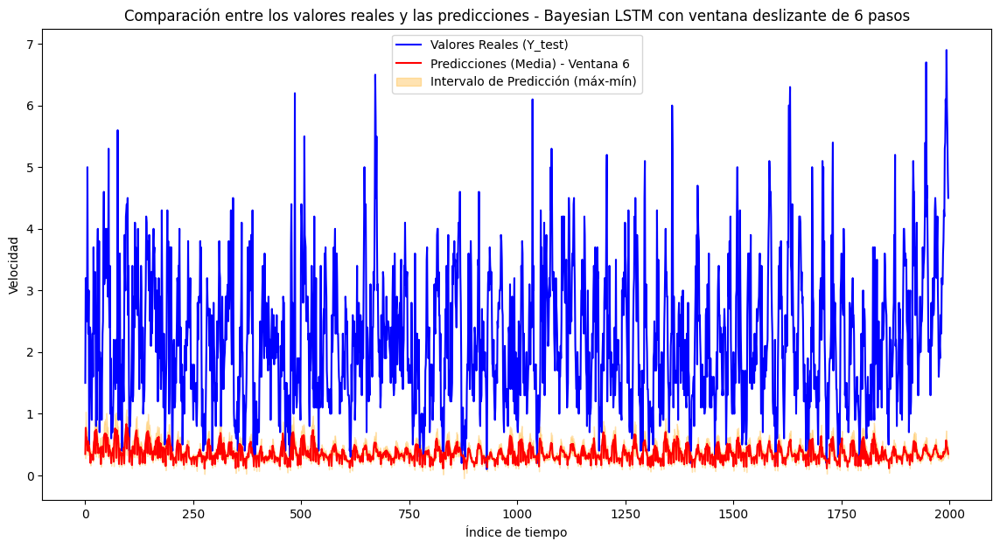

Comenzando la prueba con una ventana de 12 pasos...
MAE promedio para la ventana de 12 pasos: 1.3703484102126107
PINC promedio para la ventana de 12 pasos: 0.70%


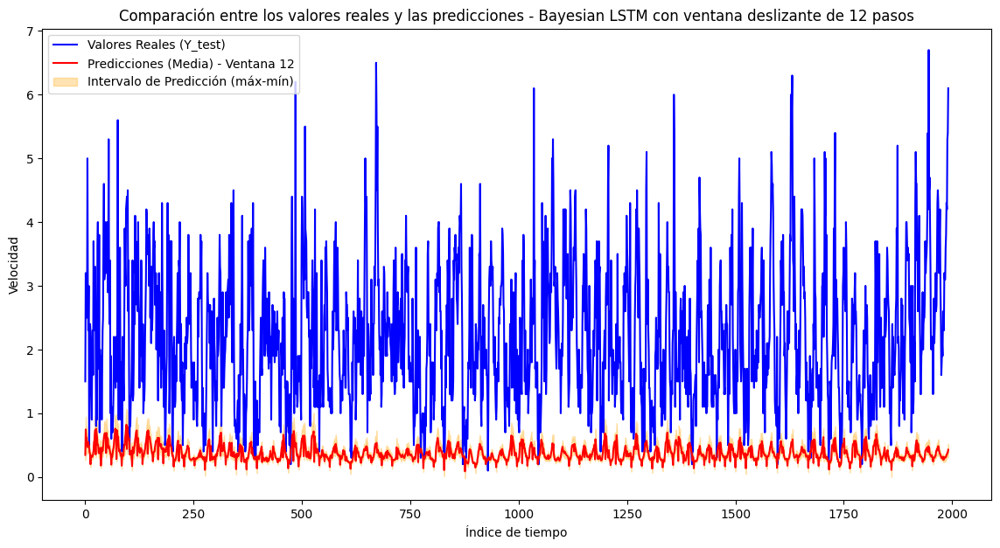

Comenzando la prueba con una ventana de 24 pasos...
MAE promedio para la ventana de 24 pasos: 1.4020614414090613
PINC promedio para la ventana de 24 pasos: 0.70%


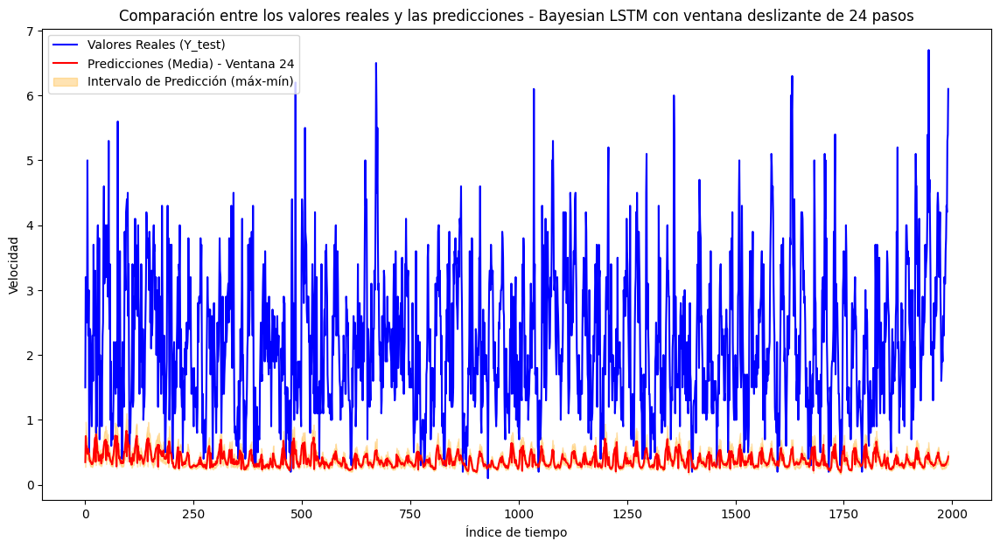

Comenzando la prueba con una ventana de 36 pasos...
MAE promedio para la ventana de 36 pasos: 1.4306685341729057
PINC promedio para la ventana de 36 pasos: 0.76%


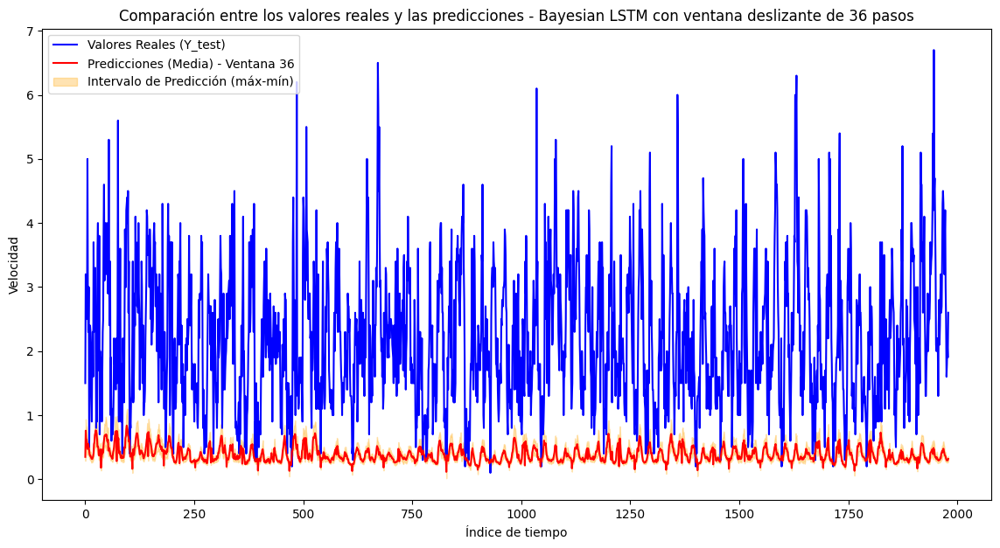

Comenzando la prueba con una ventana de 48 pasos...
MAE promedio para la ventana de 48 pasos: 1.4399726421973569
PINC promedio para la ventana de 48 pasos: 0.61%


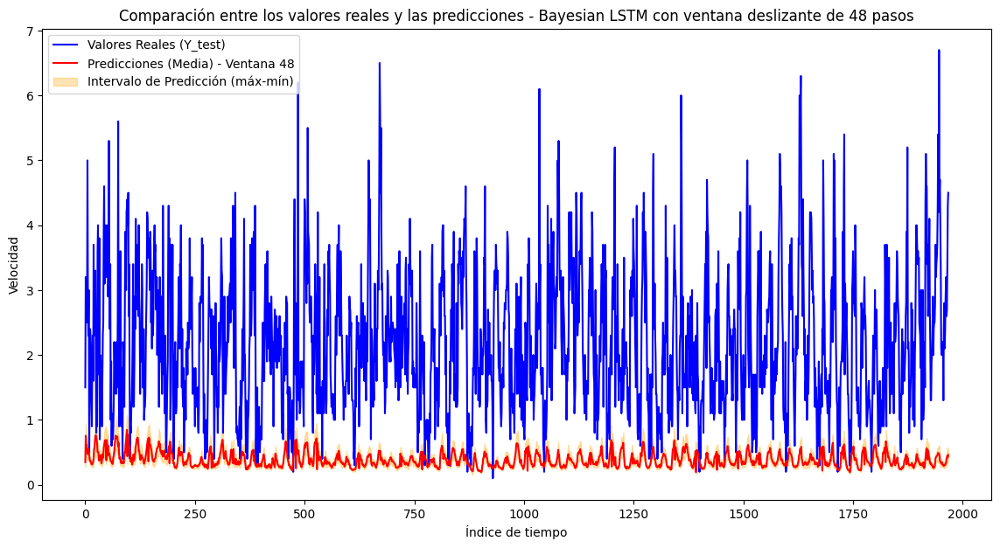


Resultados finales de MAE promedio y PINC por tamaño de ventana para el Bayesian LSTM:
Ventana de 6 pasos: MAE promedio = 1.2962992366071457, PINC promedio = 0.50%
Ventana de 12 pasos: MAE promedio = 1.3703484102126107, PINC promedio = 0.70%
Ventana de 24 pasos: MAE promedio = 1.4020614414090613, PINC promedio = 0.70%
Ventana de 36 pasos: MAE promedio = 1.4306685341729057, PINC promedio = 0.76%
Ventana de 48 pasos: MAE promedio = 1.4399726421973569, PINC promedio = 0.61%


In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Lista de tamaños de ventana a probar
window_sizes = [6, 12, 24, 36, 48]

# Diccionario para almacenar los MAE promedio y PINC por tamaño de ventana
mae_results_bayesian = {}
pinc_results_bayesian = {}

# Número de muestras para MC Dropout
num_samples = 1000

# Función para hacer predicciones bayesianas con MC Dropout
def predict_bayesian(model, X, num_samples=100):
    preds = []
    for _ in range(num_samples):
        pred = model(X, training=True).numpy()  # Dropout activado en inferencia
        preds.append(pred)
    return np.array(preds)

# Iterar sobre diferentes tamaños de ventana
for window_size in window_sizes:
    print(f'Comenzando la prueba con una ventana de {window_size} pasos...')

    # Preparar los datos de prueba para la ventana deslizante
    X_test_window = X_test_reshaped.copy()
    Y_test_window = Y_test.copy()

    # Listas para almacenar los MAE y PINC de cada ventana
    mae_list = []
    pinc_list = []

    # Lista para almacenar todas las predicciones concatenadas
    all_preds = []
    lower_bounds = []
    upper_bounds = []

    # Iterar sobre el conjunto de prueba en ventanas de longitud `window_size`
    for start in range(0, len(X_test_window) - window_size, window_size):
        # Ventana actual de `window_size`
        X_window = X_test_window[start:start + window_size]
        Y_actual = Y_test_window[start:start + window_size]

        Y_preds_window = []

        # Realizar predicciones en la ventana de tamaño actual usando el modelo bayesiano
        for i in range(window_size):
            # Obtener predicciones bayesianas para el paso actual
            bayesian_preds = predict_bayesian(model_bayesian_lstm, X_window[i].reshape(1, 1, X_window.shape[2]), num_samples)
            mean_pred = bayesian_preds.mean(axis=0)[0, 0]
            lower_bound = bayesian_preds.min(axis=0)[0, 0]
            upper_bound = bayesian_preds.max(axis=0)[0, 0]

            Y_preds_window.append(mean_pred)
            lower_bounds.append(lower_bound)
            upper_bounds.append(upper_bound)

            # Actualizar la entrada para la próxima predicción
            if i < window_size - 1:
                X_window[i + 1, 0, 1:] = X_window[i + 1, 0, :-1]  # Desplazar los valores de los lags hacia atrás
                X_window[i + 1, 0, 0] = scaler_Y.transform([[mean_pred]])[0, 0]  # Reemplazar el primer lag con la predicción actual

        # Guardar las predicciones de la ventana
        all_preds.extend(Y_preds_window)

        # Calcular el MAE de la ventana actual
        mae_window = mean_absolute_error(scaler_Y.inverse_transform(Y_actual), scaler_Y.inverse_transform(np.array(Y_preds_window).reshape(-1, 1)))
        mae_list.append(mae_window)

        # Calcular PINC para la ventana actual
        pinc_window = np.mean((Y_actual >= scaler_Y.transform(np.array(lower_bounds[start:start + window_size]).reshape(-1, 1))) &
                              (Y_actual <= scaler_Y.transform(np.array(upper_bounds[start:start + window_size]).reshape(-1, 1))))
        pinc_list.append(pinc_window)

    # Calcular el MAE y PINC promedio de todas las ventanas para el tamaño actual
    mae_promedio = np.mean(mae_list)
    pinc_promedio = np.mean(pinc_list) * 100  # Expresado en porcentaje
    mae_results_bayesian[window_size] = mae_promedio
    pinc_results_bayesian[window_size] = pinc_promedio
    print(f'MAE promedio para la ventana de {window_size} pasos: {mae_promedio}')
    print(f'PINC promedio para la ventana de {window_size} pasos: {pinc_promedio:.2f}%')

    # Graficar Y_test y Y_pred concatenadas para la ventana actual con intervalos de predicción
    plt.figure(figsize=(14, 7))
    plt.plot(scaler_Y.inverse_transform(Y_test[:len(all_preds)]), label='Valores Reales (Y_test)', color='blue')
    plt.plot(all_preds, label=f'Predicciones (Media) - Ventana {window_size}', color='red')
    plt.fill_between(range(len(all_preds)), lower_bounds, upper_bounds, color='orange', alpha=0.3, label='Intervalo de Predicción (máx-mín)')
    plt.title(f'Comparación entre los valores reales y las predicciones - Bayesian LSTM con ventana deslizante de {window_size} pasos')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Velocidad')
    plt.legend()
    plt.show()

# Imprimir resultados de todos los tamaños de ventana
print("\nResultados finales de MAE promedio y PINC por tamaño de ventana para el Bayesian LSTM:")
for size in window_sizes:
    print(f'Ventana de {size} pasos: MAE promedio = {mae_results_bayesian[size]}, PINC promedio = {pinc_results_bayesian[size]:.2f}%')


In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Lista de tamaños de ventana a probar
window_sizes = [6, 12, 24, 36, 48]

# Diccionario para almacenar los MAE promedio y PINC por tamaño de ventana
mae_results_bayesian = {}
pinc_results_bayesian = {}

# Número de muestras para MC Dropout
num_samples = 1000

# Función para hacer predicciones bayesianas con MC Dropout
def predict_bayesian(model, X, num_samples=100):
    preds = []
    for _ in range(num_samples):
        pred = model(X, training=True).numpy()  # Dropout activado en inferencia
        preds.append(pred)
    return np.array(preds)

# Iterar sobre diferentes tamaños de ventana
for window_size in window_sizes:
    print(f'Comenzando la prueba con una ventana de {window_size} pasos...')

    # Preparar los datos de prueba para la ventana deslizante
    X_test_window = X_test_reshaped.copy()
    Y_test_window = Y_test.copy()

    # Listas para almacenar los MAE y PINC de cada ventana
    mae_list = []
    pinc_list = []

    # Lista para almacenar todas las predicciones concatenadas
    all_preds = []
    lower_bounds = []
    upper_bounds = []

    # Iterar sobre el conjunto de prueba en ventanas de longitud `window_size`
    for start in range(0, len(X_test_window) - window_size, window_size):
        # Ventana actual de `window_size`
        X_window = X_test_window[start:start + window_size]
        Y_actual = Y_test_window[start:start + window_size]

        Y_preds_window = []

        # Realizar predicciones en la ventana de tamaño actual usando el modelo bayesiano
        for i in range(window_size):
            # Obtener predicciones bayesianas para el paso actual
            bayesian_preds = predict_bayesian(model_bayesian_lstm, X_window[i].reshape(1, 1, X_window.shape[2]), num_samples)
            mean_pred = bayesian_preds.mean(axis=0)[0, 0]
            lower_bound = bayesian_preds.min(axis=0)[0, 0]
            upper_bound = bayesian_preds.max(axis=0)[0, 0]

            Y_preds_window.append(mean_pred)
            lower_bounds.append(lower_bound)
            upper_bounds.append(upper_bound)

            # Actualizar la entrada para la próxima predicción
            if i < window_size - 1:
                X_window[i + 1, 0, 1:] = X_window[i + 1, 0, :-1]  # Desplazar los valores de los lags hacia atrás
                X_window[i + 1, 0, 0] = scaler_Y.transform([[mean_pred]])[0, 0]  # Reemplazar el primer lag con la predicción actual

        # Guardar las predicciones de la ventana
        all_preds.extend(Y_preds_window)

        # Calcular el MAE de la ventana actual
        mae_window = mean_absolute_error(scaler_Y.inverse_transform(Y_actual), scaler_Y.inverse_transform(np.array(Y_preds_window).reshape(-1, 1)))
        mae_list.append(mae_window)

        # Calcular PINC para la ventana actual
        pinc_window = np.mean((Y_actual >= scaler_Y.transform(np.array(lower_bounds[start:start + window_size]).reshape(-1, 1))) &
                              (Y_actual <= scaler_Y.transform(np.array(upper_bounds[start:start + window_size]).reshape(-1, 1))))
        pinc_list.append(pinc_window)

    # Calcular el MAE y PINC promedio de todas las ventanas para el tamaño actual
    mae_promedio = np.mean(mae_list)
    pinc_promedio = np.mean(pinc_list) * 100  # Expresado en porcentaje
    mae_results_bayesian[window_size] = mae_promedio
    pinc_results_bayesian[window_size] = pinc_promedio
    print(f'MAE promedio para la ventana de {window_size} pasos: {mae_promedio}')
    print(f'PINC promedio para la ventana de {window_size} pasos: {pinc_promedio:.2f}%')

    # Graficar Y_test y Y_pred concatenadas para la ventana actual con intervalos de predicción
    plt.figure(figsize=(14, 7))
    plt.plot(scaler_Y.inverse_transform(Y_test[:len(all_preds)]), label='Valores Reales (Y_test)', color='blue')
    plt.plot(all_preds, label=f'Predicciones (Media) - Ventana {window_size}', color='red')
    plt.fill_between(range(len(all_preds)), lower_bounds, upper_bounds, color='orange', alpha=0.3, label='Intervalo de Predicción (máx-mín)')
    plt.title(f'Comparación entre los valores reales y las predicciones - Bayesian LSTM con ventana deslizante de {window_size} pasos')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Velocidad')
    plt.legend()
    plt.show()

# Imprimir resultados de todos los tamaños de ventana
print("\nResultados finales de MAE promedio y PINC por tamaño de ventana para el Bayesian LSTM:")
for size in window_sizes:
    print(f'Ventana de {size} pasos: MAE promedio = {mae_results_bayesian[size]}, PINC promedio = {pinc_results_bayesian[size]:.2f}%')


Comenzando la prueba con una ventana de 6 pasos...


KeyboardInterrupt: 

In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Lista de tamaños de ventana a probar
window_sizes = [1000]

# Diccionario para almacenar los MAE promedio y PINC por tamaño de ventana
mae_results_bayesian = {}
pinc_results_bayesian = {}

# Número de muestras para MC Dropout
num_samples = 1000

# Función para hacer predicciones bayesianas con MC Dropout
def predict_bayesian(model, X, num_samples=100):
    preds = []
    for _ in range(num_samples):
        pred = model(X, training=True).numpy()  # Dropout activado en inferencia
        preds.append(pred)
    return np.array(preds)

# Iterar sobre diferentes tamaños de ventana
for window_size in window_sizes:
    print(f'Comenzando la prueba con una ventana de {window_size} pasos...')

    # Preparar los datos de prueba para la ventana deslizante
    X_test_window = X_test_reshaped.copy()
    Y_test_window = Y_test.copy()

    # Listas para almacenar los MAE y PINC de cada ventana
    mae_list = []
    pinc_list_99 = []
    pinc_list_95 = []

    # Listas para almacenar todas las predicciones y límites concatenados
    all_preds = []
    lower_bounds_99 = []
    upper_bounds_99 = []
    lower_bounds_95 = []
    upper_bounds_95 = []

    # Iterar sobre el conjunto de prueba en ventanas de longitud `window_size`
    for start in range(0, len(X_test_window) - window_size, window_size):
        print(f"Ventana {start // window_size + 1}/{len(X_test_window) // window_size}")

        # Ventana actual de `window_size`
        X_window = X_test_window[start:start + window_size]
        Y_actual = Y_test_window[start:start + window_size]

        Y_preds_window = []

        # Realizar predicciones en la ventana de tamaño actual usando el modelo bayesiano
        for i in range(window_size):
            # Obtener predicciones bayesianas para el paso actual
            bayesian_preds = predict_bayesian(model_bayesian_lstm, X_window[i].reshape(1, 1, X_window.shape[2]), num_samples)
            mean_pred = bayesian_preds.mean(axis=0)[0, 0]
            lower_bound_99 = np.percentile(bayesian_preds, 0.5, axis=0)[0, 0]
            upper_bound_99 = np.percentile(bayesian_preds, 99.5, axis=0)[0, 0]
            lower_bound_95 = np.percentile(bayesian_preds, 2.5, axis=0)[0, 0]
            upper_bound_95 = np.percentile(bayesian_preds, 97.5, axis=0)[0, 0]

            # Guardar las predicciones y los límites
            Y_preds_window.append(mean_pred)
            lower_bounds_99.append(lower_bound_99)
            upper_bounds_99.append(upper_bound_99)
            lower_bounds_95.append(lower_bound_95)
            upper_bounds_95.append(upper_bound_95)

            # Actualizar la entrada para la próxima predicción
            if i < window_size - 1:
                X_window[i + 1, 0, 1:] = X_window[i + 1, 0, :-1]  # Desplazar los valores de los lags hacia atrás
                X_window[i + 1, 0, 0] = scaler_Y.transform([[mean_pred]])[0, 0]  # Reemplazar el primer lag con la predicción actual

        # Guardar las predicciones de la ventana
        all_preds.extend(Y_preds_window)

        # Calcular el MAE de la ventana actual
        mae_window = mean_absolute_error(scaler_Y.inverse_transform(Y_actual), scaler_Y.inverse_transform(np.array(Y_preds_window).reshape(-1, 1)))
        mae_list.append(mae_window)

        # Calcular PINC para los intervalos al 99% y 95%
        pinc_window_99 = np.mean((Y_actual >= scaler_Y.transform(np.array(lower_bounds_99[start:start + window_size]).reshape(-1, 1))) &
                                 (Y_actual <= scaler_Y.transform(np.array(upper_bounds_99[start:start + window_size]).reshape(-1, 1))))
        pinc_list_99.append(pinc_window_99)

        pinc_window_95 = np.mean((Y_actual >= scaler_Y.transform(np.array(lower_bounds_95[start:start + window_size]).reshape(-1, 1))) &
                                 (Y_actual <= scaler_Y.transform(np.array(upper_bounds_95[start:start + window_size]).reshape(-1, 1))))
        pinc_list_95.append(pinc_window_95)

    # Calcular el MAE promedio y PINC promedio de todas las ventanas para el tamaño actual
    mae_promedio = np.mean(mae_list)
    pinc_promedio_99 = np.mean(pinc_list_99) * 100  # Expresado en porcentaje
    pinc_promedio_95 = np.mean(pinc_list_95) * 100  # Expresado en porcentaje
    mae_results_bayesian[window_size] = mae_promedio
    pinc_results_bayesian[window_size] = (pinc_promedio_99, pinc_promedio_95)

    print(f'MAE promedio para la ventana de {window_size} pasos: {mae_promedio}')
    print(f'PINC promedio para la ventana de {window_size} pasos (99%): {pinc_promedio_99:.2f}%')
    print(f'PINC promedio para la ventana de {window_size} pasos (95%): {pinc_promedio_95:.2f}%')

    # Graficar Y_test y Y_pred concatenadas para la ventana actual con intervalos de predicción
    plt.figure(figsize=(14, 7))
    plt.plot(scaler_Y.inverse_transform(Y_test[:len(all_preds)]), label='Valores Reales (Y_test)', color='blue')
    plt.plot(all_preds, label=f'Predicciones (Media) - Ventana {window_size}', color='red')
    plt.fill_between(range(len(all_preds)), lower_bounds_99, upper_bounds_99, color='orange', alpha=0.3, label='Intervalo de Predicción al 99%')
    plt.fill_between(range(len(all_preds)), lower_bounds_95, upper_bounds_95, color='green', alpha=0.3, label='Intervalo de Predicción al 95%')
    plt.title(f'Comparación entre los valores reales y las predicciones - Bayesian LSTM con ventana deslizante de {window_size} pasos')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Velocidad')
    plt.legend()
    plt.show()

# Imprimir resultados de todos los tamaños de ventana
print("\nResultados finales de MAE promedio y PINC por tamaño de ventana para el Bayesian LSTM:")
for size in window_sizes:
    print(f'Ventana de {size} pasos: MAE promedio = {mae_results_bayesian[size]}, PINC promedio (99%) = {pinc_results_bayesian[size][0]:.2f}%, PINC promedio (95%) = {pinc_results_bayesian[size][1]:.2f}%')


Comenzando la prueba con una ventana de 1000 pasos...
Ventana 1/2


KeyboardInterrupt: 

## Ensembled

Comenzando la prueba con una ventana de 6 pasos...
MAE promedio para la ventana de 6 pasos: 2.841301721707028
PINC promedio para la ventana de 6 pasos: 0.03%


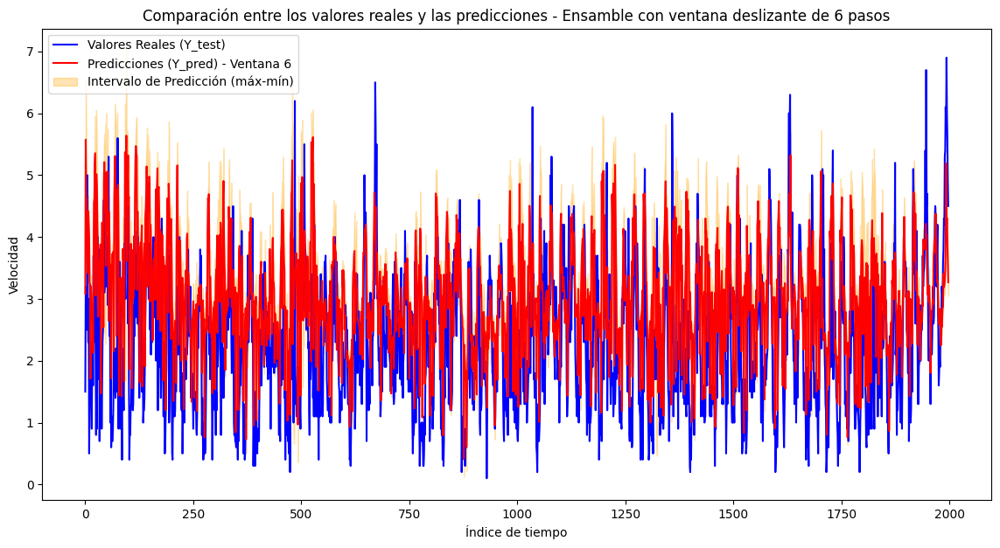

Comenzando la prueba con una ventana de 12 pasos...
MAE promedio para la ventana de 12 pasos: 2.9477615216809263
PINC promedio para la ventana de 12 pasos: 0.05%


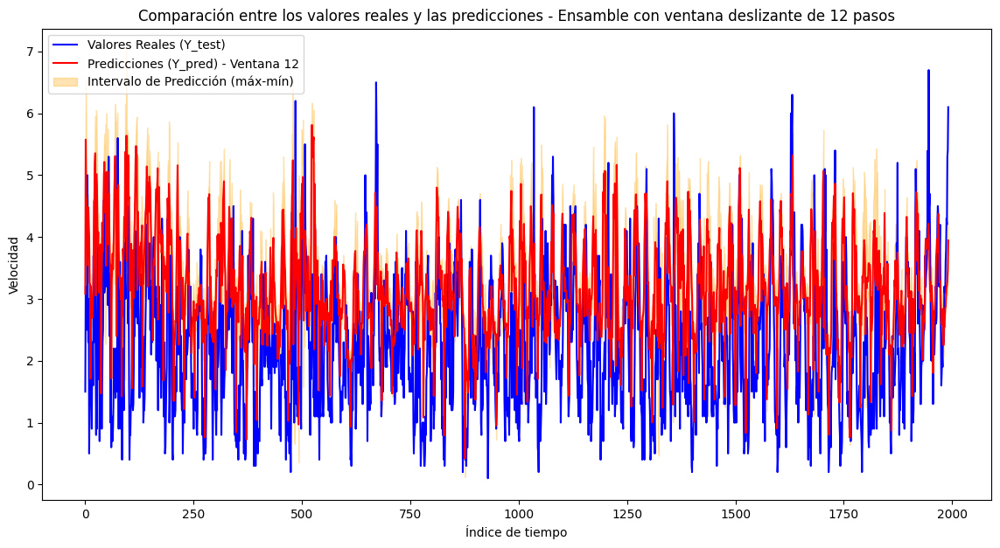

Comenzando la prueba con una ventana de 24 pasos...
MAE promedio para la ventana de 24 pasos: 3.0026728937345015
PINC promedio para la ventana de 24 pasos: 0.00%


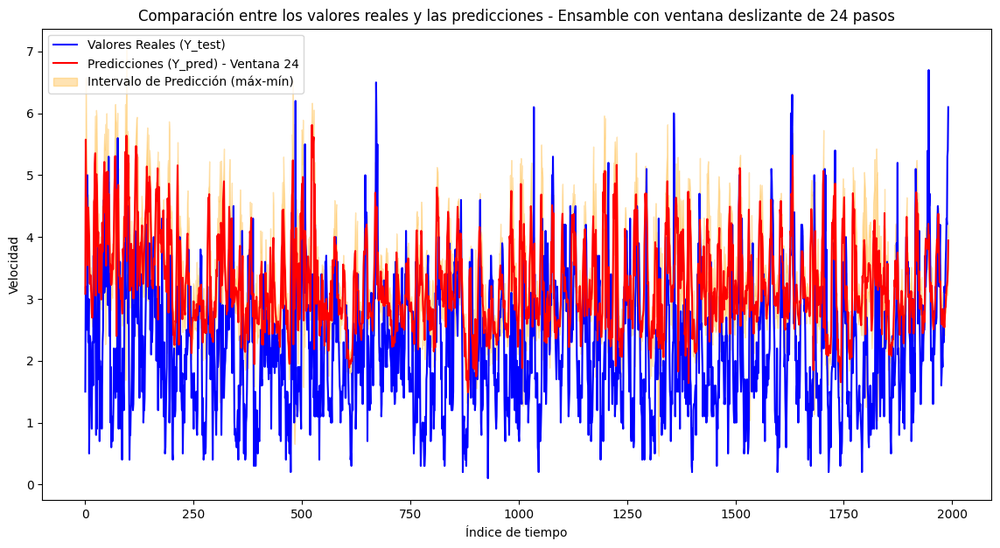

Comenzando la prueba con una ventana de 36 pasos...
MAE promedio para la ventana de 36 pasos: 3.0142882297904667
PINC promedio para la ventana de 36 pasos: 0.00%


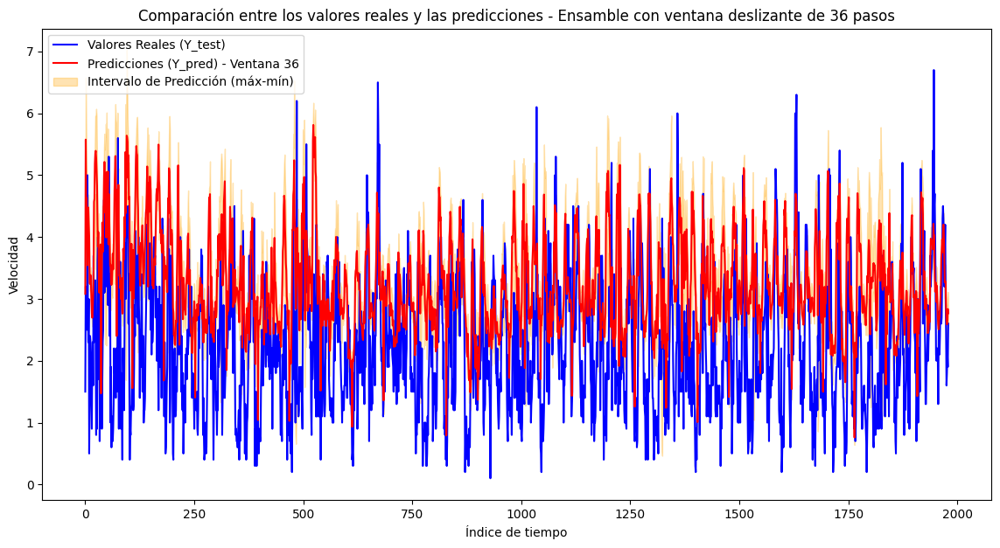

Comenzando la prueba con una ventana de 48 pasos...
MAE promedio para la ventana de 48 pasos: 3.0294831485834983
PINC promedio para la ventana de 48 pasos: 0.00%


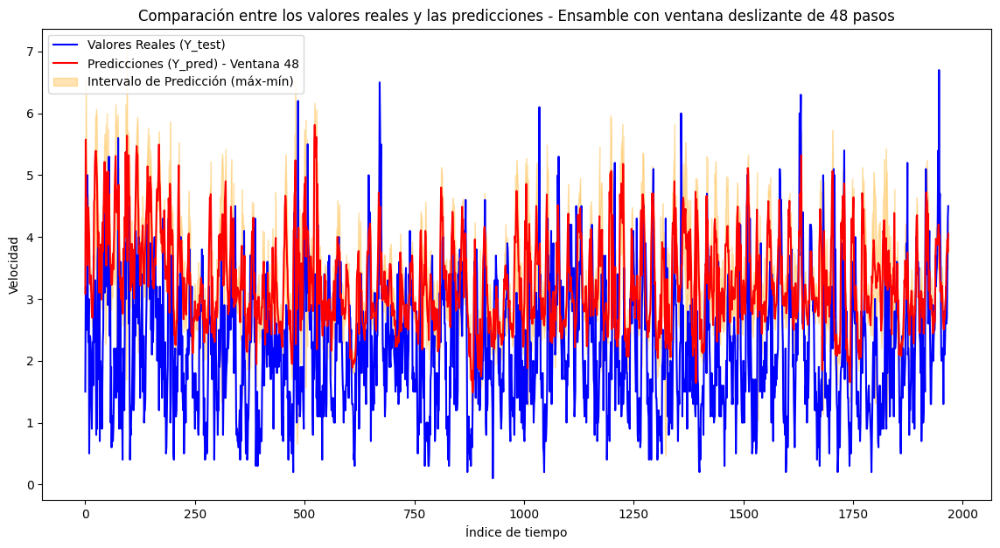


Resultados finales de MAE promedio y PINC por tamaño de ventana para el ensamble de LSTM:
Ventana de 6 pasos: MAE promedio = 2.841301721707028, PINC promedio = 0.03%
Ventana de 12 pasos: MAE promedio = 2.9477615216809263, PINC promedio = 0.05%
Ventana de 24 pasos: MAE promedio = 3.0026728937345015, PINC promedio = 0.00%
Ventana de 36 pasos: MAE promedio = 3.0142882297904667, PINC promedio = 0.00%
Ventana de 48 pasos: MAE promedio = 3.0294831485834983, PINC promedio = 0.00%


In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Lista de tamaños de ventana a probar
window_sizes = [6, 12, 24, 36, 48]

# Diccionario para almacenar los MAE promedio y PINC por tamaño de ventana
mae_results_ensemble = {}
pinc_results_ensemble = {}

# Iterar sobre diferentes tamaños de ventana
for window_size in window_sizes:
    print(f'Comenzando la prueba con una ventana de {window_size} pasos...')

    # Preparar los datos de prueba para la ventana deslizante
    X_test_window = X_test_reshaped.copy()  # Crear una copia de los datos de prueba
    Y_test_window = Y_test.copy()  # Copia de los datos de prueba desescalados

    # Lista para almacenar los MAE y PINC de cada ventana
    mae_list = []
    pinc_list = []

    # Lista para almacenar todas las predicciones concatenadas
    all_preds = []
    lower_bounds = []
    upper_bounds = []

    # Iterar sobre el conjunto de prueba en ventanas de longitud `window_size`
    for start in range(0, len(X_test_window) - window_size, window_size):
        # Ventana actual de `window_size`
        X_window = X_test_window[start:start + window_size]
        Y_actual = Y_test_window[start:start + window_size]

        Y_preds_window = []

        # Realizar predicciones en la ventana de tamaño actual usando el ensamble
        for i in range(window_size):
            # Realizar predicciones de cada modelo en el ensamble y calcular la media
            ensemble_preds = []
            for model in ensemble_models:
                pred_scaled = model.predict(X_window[i].reshape(1, 1, X_window.shape[2]), verbose=0)
                pred = scaler_Y.inverse_transform(pred_scaled)
                ensemble_preds.append(pred[0, 0])

            # Tomar el promedio de las predicciones del ensamble y calcular los límites
            mean_pred = np.mean(ensemble_preds)
            lower_bound = np.min(ensemble_preds)
            upper_bound = np.max(ensemble_preds)

            Y_preds_window.append(mean_pred)
            lower_bounds.append(lower_bound)
            upper_bounds.append(upper_bound)

            # Actualizar la entrada para la próxima predicción
            if i < window_size - 1:  # Evitar índice fuera de rango
                # Desplazar todos los lags una posición hacia atrás y añadir la predicción en el primer lag
                X_window[i + 1, 0, 1:] = X_window[i + 1, 0, :-1]  # Desplazar los valores de los lags hacia atrás
                X_window[i + 1, 0, 0] = scaler_Y.transform([[mean_pred]])[0, 0]  # Reemplazar el primer lag con la predicción actual

        # Guardar las predicciones de la ventana
        all_preds.extend(Y_preds_window)

        # Calcular el MAE de la ventana actual
        mae_window = mean_absolute_error(Y_actual, Y_preds_window)
        mae_list.append(mae_window)

        # Calcular PINC para la ventana actual
        pinc_window = np.mean((Y_actual >= lower_bounds[start:start + window_size]) & (Y_actual <= upper_bounds[start:start + window_size]))
        pinc_list.append(pinc_window)

    # Calcular el MAE y PINC promedio de todas las ventanas para el tamaño actual
    mae_promedio = np.mean(mae_list)
    pinc_promedio = np.mean(pinc_list) * 100  # Expresado en porcentaje
    mae_results_ensemble[window_size] = mae_promedio
    pinc_results_ensemble[window_size] = pinc_promedio
    print(f'MAE promedio para la ventana de {window_size} pasos: {mae_promedio}')
    print(f'PINC promedio para la ventana de {window_size} pasos: {pinc_promedio:.2f}%')

    # Graficar Y_test y Y_pred concatenadas para la ventana actual con intervalos de predicción
    plt.figure(figsize=(14, 7))
    plt.plot(Y_test_descaled[:len(all_preds)], label='Valores Reales (Y_test)', color='blue')
    plt.plot(all_preds, label=f'Predicciones (Y_pred) - Ventana {window_size}', color='red')
    plt.fill_between(range(len(all_preds)), lower_bounds, upper_bounds, color='orange', alpha=0.3, label='Intervalo de Predicción (máx-mín)')
    plt.title(f'Comparación entre los valores reales y las predicciones - Ensamble con ventana deslizante de {window_size} pasos')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Velocidad')
    plt.legend()
    plt.show()

# Imprimir resultados de todos los tamaños de ventana
print("\nResultados finales de MAE promedio y PINC por tamaño de ventana para el ensamble de LSTM:")
for size in window_sizes:
    print(f'Ventana de {size} pasos: MAE promedio = {mae_results_ensemble[size]}, PINC promedio = {pinc_results_ensemble[size]:.2f}%')



Entrenando el modelo 1 de 5...
Entrenando el modelo 2 de 5...
Entrenando el modelo 3 de 5...
Entrenando el modelo 4 de 5...
Entrenando el modelo 5 de 5...
Métrica PINC (intervalo de cobertura de predicción): 19.70%
MAE para la media de las predicciones del ensamble: 0.5769


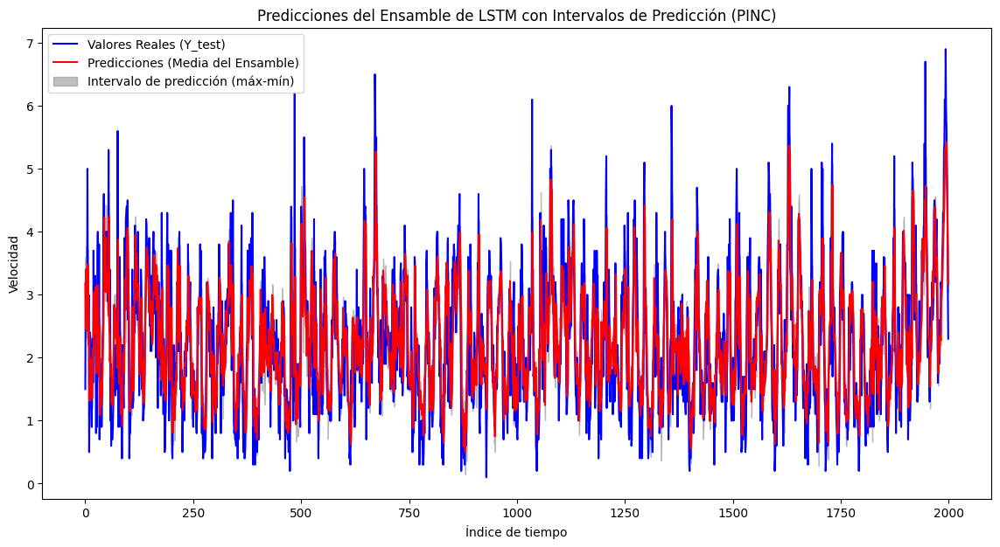

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, LSTM, Input
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

# Preprocesamiento de datos
# Crear lags de la variable objetivo 'Velocidad'
num_lags_y = 36
data_lagged = datos_pf2.copy()
for lag in range(1, num_lags_y + 1):
    data_lagged[f'Y_lag_{lag}'] = data_lagged['Velocidad'].shift(lag)

# Eliminar las filas con valores NaN después de crear los lags de Y
data_lagged = data_lagged.tail(10000).dropna()

# Separar las características (X actuales y lags de Y) y la variable objetivo (Y)
X = data_lagged.drop(columns=['Velocidad']).values
Y = data_lagged['Velocidad'].values

# Escalar los datos
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

X_scaled = scaler_X.fit_transform(X)
Y_scaled = scaler_Y.fit_transform(Y.reshape(-1, 1))

# Dividir los datos en conjuntos de entrenamiento y prueba
split_index = int(0.8 * len(X_scaled))
X_train, X_test = X_scaled[:split_index], X_scaled[split_index:]
Y_train, Y_test = Y_scaled[:split_index], Y_scaled[split_index:]

# Preparar los datos para LSTM en formato 3D: (n_samples, timesteps=1, n_features)
X_train_reshaped = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_reshaped = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Función para crear un modelo LSTM simple con inicialización aleatoria
def create_lstm(input_shape, lstm_units=100):
    model = Sequential([
        Input(shape=input_shape),
        LSTM(lstm_units, activation='relu', return_sequences=False),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

# Entrenar múltiples modelos LSTM con diferentes inicializaciones de pesos
num_models = 5  # Número de modelos en el ensamble
lstm_units = 100
input_shape = (1, X_train.shape[1])
ensemble_models = []

# Entrenar los modelos con la misma secuencia de datos pero diferentes pesos iniciales
for i in range(num_models):
    print(f'Entrenando el modelo {i+1} de {num_models}...')
    model = create_lstm(input_shape, lstm_units)
    model.fit(X_train_reshaped, Y_train, epochs=50, batch_size=10, verbose=0)
    ensemble_models.append(model)

# Obtener las predicciones de cada modelo en el conjunto de prueba
ensemble_preds = []
for model in ensemble_models:
    pred = model.predict(X_test_reshaped, verbose=0)
    ensemble_preds.append(pred)

# Convertir a un array para obtener los intervalos de predicción
ensemble_preds = np.array(ensemble_preds)
mean_preds_ensemble = ensemble_preds.mean(axis=0)

# Desescalar las predicciones y Y_test
mean_preds_ensemble_descaled = scaler_Y.inverse_transform(mean_preds_ensemble)
Y_test_descaled = scaler_Y.inverse_transform(Y_test)

# Calcular los límites inferior y superior basados en el máximo y mínimo de las predicciones
lower_bound = scaler_Y.inverse_transform(ensemble_preds.min(axis=0))
upper_bound = scaler_Y.inverse_transform(ensemble_preds.max(axis=0))

# Calcular la métrica PINC: porcentaje de valores reales que caen dentro de los límites
pinc = np.mean((Y_test_descaled >= lower_bound) & (Y_test_descaled <= upper_bound))
print(f'Métrica PINC (intervalo de cobertura de predicción): {pinc * 100:.2f}%')

# Calcular el MAE para la media de las predicciones del ensamble
mae_ensemble = mean_absolute_error(Y_test_descaled, mean_preds_ensemble_descaled)
print(f'MAE para la media de las predicciones del ensamble: {mae_ensemble:.4f}')

# Graficar los resultados
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(mean_preds_ensemble_descaled, label='Predicciones (Media del Ensamble)', color='red')
plt.fill_between(range(len(mean_preds_ensemble_descaled)), lower_bound.flatten(), upper_bound.flatten(), color='gray', alpha=0.5, label='Intervalo de predicción (máx-mín)')
plt.title('Predicciones del Ensamble de LSTM con Intervalos de Predicción (PINC)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


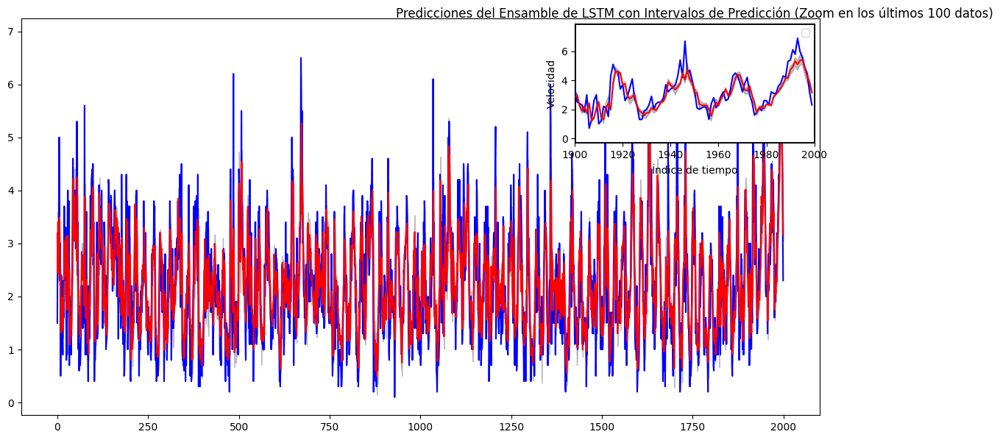

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset

# Graficar los resultados con zoom
plt.figure(figsize=(14, 7))
plt.plot(Y_test_descaled, label='Valores Reales (Y_test)', color='blue')
plt.plot(mean_preds_ensemble_descaled, label='Predicciones (Media del Ensamble)', color='red')
plt.fill_between(range(len(mean_preds_ensemble_descaled)), lower_bound.flatten(), upper_bound.flatten(),
                 color='gray', alpha=0.5, label='Intervalo de predicción (máx-mín)')

# Crear el área de zoom
axins = inset_axes(plt.gca(), width="30%", height="30%", loc="upper right")
axins.plot(Y_test_descaled, color='blue')
axins.plot(mean_preds_ensemble_descaled, color='red')
axins.fill_between(range(len(mean_preds_ensemble_descaled)), lower_bound.flatten(), upper_bound.flatten(),
                   color='gray', alpha=0.5)

# Limitar el área de zoom a los últimos 100 datos
axins.set_xlim(len(mean_preds_ensemble_descaled) - 100, len(mean_preds_ensemble_descaled))
axins.set_ylim(min(Y_test_descaled[-100:].min(), lower_bound[-100:].min()) - 1,
               max(Y_test_descaled[-100:].max(), upper_bound[-100:].max()) + 1)

# Conectar el zoom con la gráfica principal
mark_inset(plt.gca(), axins, loc1=2, loc2=4, fc="none", ec="black", lw=2)

plt.title('Predicciones del Ensamble de LSTM con Intervalos de Predicción (Zoom en los últimos 100 datos)')
plt.xlabel('Índice de tiempo')
plt.ylabel('Velocidad')
plt.legend()
plt.show()


# Explicabilidad

## Shap

7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 169ms/step


  0%|          | 0/200 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 14s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 14s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 14s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 14s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 13s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 14s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 13s 998us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 13s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 14s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 13s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 13s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
13325/13325 ━━━━━━━━━━━━━━━━━━━━ 13

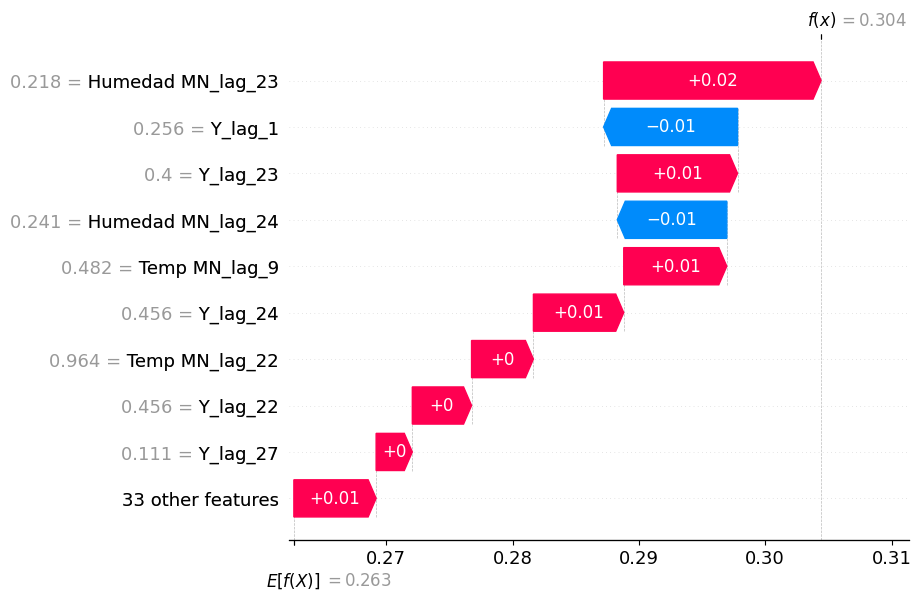

In [ ]:
import shap

# Seleccionar un subconjunto de los datos originales para acelerar el cálculo
X_test_sample = X_test[:200]  # Ajusta según lo necesario

# Crear el explainer SHAP con KernelExplainer usando X_test_sample en 2D
# Reconvertimos cada muestra a 3D antes de pasarla al modelo
explainer = shap.KernelExplainer(lambda x: model_bayesian_lstm.predict(x.reshape(-1, 1, X_test_sample.shape[1])), X_test_sample)

# Obtener los valores SHAP para cada lag en la muestra seleccionada
shap_values = explainer.shap_values(X_test_sample)

# Verificar la dimensión de los shap_values
print("Dimensión de shap_values:", np.array(shap_values).shape)

# Visualizar los valores SHAP con waterfall_plot para una instancia individual
instance_index = 0  # Cambia el índice si quieres ver otra instancia
shap_value_single_instance = shap_values[instance_index, :, 0]

# Asignar nombres de las características (lags de la variable objetivo)
feature_names = data_lagged.drop(columns=['Velocidad']).columns

# Visualizar el impacto de cada característica en la predicción con waterfall_plot
shap.waterfall_plot(shap.Explanation(values=shap_value_single_instance,
                                     base_values=explainer.expected_value[0],
                                     data=X_test_sample[instance_index],
                                     feature_names=feature_names))


In [ ]:
# Guardar los valores SHAP en un archivo .npy
np.save('shap_values.npy', shap_values)

# Guardar el valor esperado del modelo (base value)
np.save('expected_value.npy', explainer.expected_value)


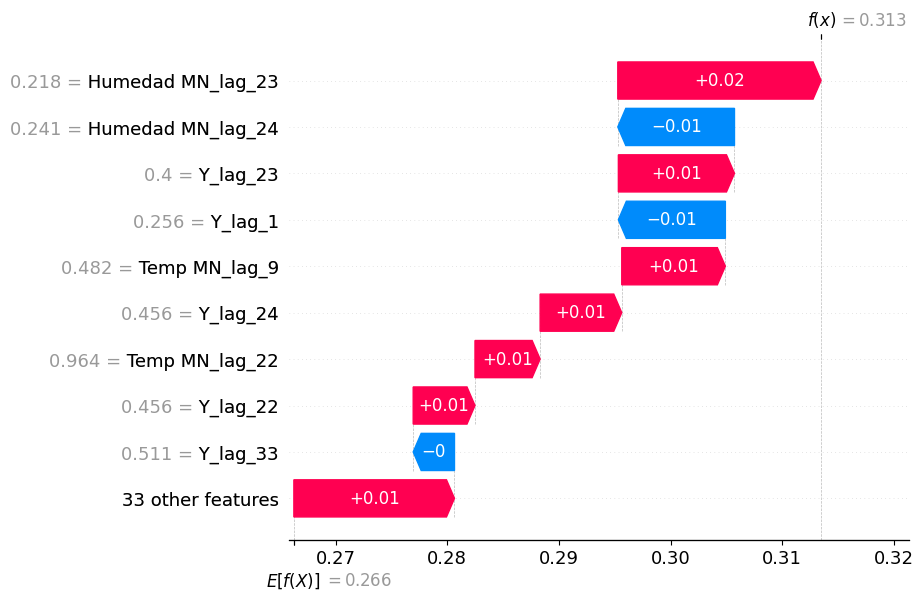

In [ ]:
import numpy as np
import shap
import matplotlib.pyplot as plt

# Cargar los valores SHAP y el valor esperado
X_test_sample = X_test[:200]
shap_values_loaded = np.load('shap_values.npy', allow_pickle=True)
expected_value_loaded = np.load('expected_value.npy', allow_pickle=True)

# Seleccionar una instancia específica
instance_index = 0  # Cambia según la instancia que quieras analizar
shap_value_single_instance = shap_values_loaded[instance_index, :, 0]

# Asignar nombres de las características
feature_names = data_lagged.drop(columns=['Velocidad']).columns

# Visualizar con waterfall_plot
shap.waterfall_plot(
    shap.Explanation(
        values=shap_value_single_instance,
        base_values=expected_value_loaded[0],
        data=X_test_sample[instance_index],
        feature_names=feature_names
    )
)

In [ ]:
# Inicializar la visualización interactiva en Jupyter Notebook
shap.initjs()

shap.force_plot(
    expected_value_loaded[0],
    shap_values_loaded[0, :, 0],
    features=X_test_sample[0],
    feature_names=feature_names
)


In [ ]:
# Desescalar todos los valores SHAP
shap_values_descaled = shap_values * (scaler_Y.data_max_ - scaler_Y.data_min_)

# Ahora `shap_values_descaled` contiene los SHAP values desescalados para todas las instancias y características

In [ ]:
feature_names

Index(['Direccion_lag_2', 'Direccion_lag_3', 'Humedad MN_lag_24',
       'Humedad MN_lag_23', 'Temp MN_lag_9', 'Temp MN_lag_22', 'Y_lag_1',
       'Y_lag_2', 'Y_lag_3', 'Y_lag_4', 'Y_lag_5', 'Y_lag_6', 'Y_lag_7',
       'Y_lag_8', 'Y_lag_9', 'Y_lag_10', 'Y_lag_11', 'Y_lag_12', 'Y_lag_13',
       'Y_lag_14', 'Y_lag_15', 'Y_lag_16', 'Y_lag_17', 'Y_lag_18', 'Y_lag_19',
       'Y_lag_20', 'Y_lag_21', 'Y_lag_22', 'Y_lag_23', 'Y_lag_24', 'Y_lag_25',
       'Y_lag_26', 'Y_lag_27', 'Y_lag_28', 'Y_lag_29', 'Y_lag_30', 'Y_lag_31',
       'Y_lag_32', 'Y_lag_33', 'Y_lag_34', 'Y_lag_35', 'Y_lag_36'],
      dtype='object')

In [76]:
# Guardar el conjunto X_test_sample
np.save('X_test_sample.npy', X_test_sample)

In [ ]:
# Guardar los valores SHAP en un archivo .npy
np.save('shap_values_descaled_1.npy', shap_values_descaled)

# Guardar el valor esperado del modelo (base value)
np.save('expected_value_descaled_1.npy', expected_value_descaled)

In [ ]:
import shap
import numpy as np

# Cargar los valores SHAP desescalados
shap_values_descaled_loaded = np.load('shap_values_descaled_1.npy')

# Cargar el valor esperado desescalado (base value)
expected_value_descaled_loaded = np.load('expected_value_descaled_1.npy')

X_test_sample_loaded = np.load('X_test_sample.npy')

# Visualizar con SHAP force plot para una instancia específica
instance_index = 0
shap_value_single_instance_descaled = shap_values_descaled_loaded[instance_index, :, 0]

# Inicializar la visualización interactiva en Jupyter Notebook
shap.initjs()

# Asegurarte de que expected_value_descaled_loaded sea un iterable
# Convertir el escalar en un arreglo numpy con un solo valor
shap.force_plot(
    np.array([expected_value_descaled_loaded]),
    shap_value_single_instance_descaled,
    features=X_test_sample_loaded[instance_index],
    feature_names=feature_names
)




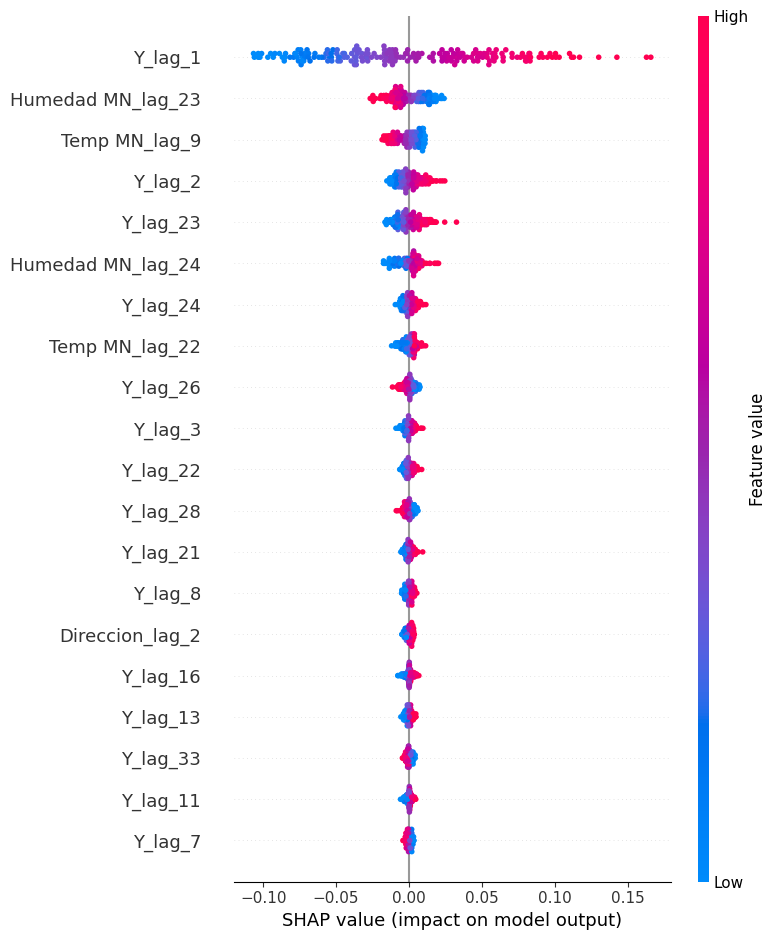

In [ ]:
shap.summary_plot(shap_values_loaded[:, :, 0], X_test_sample, feature_names=feature_names)


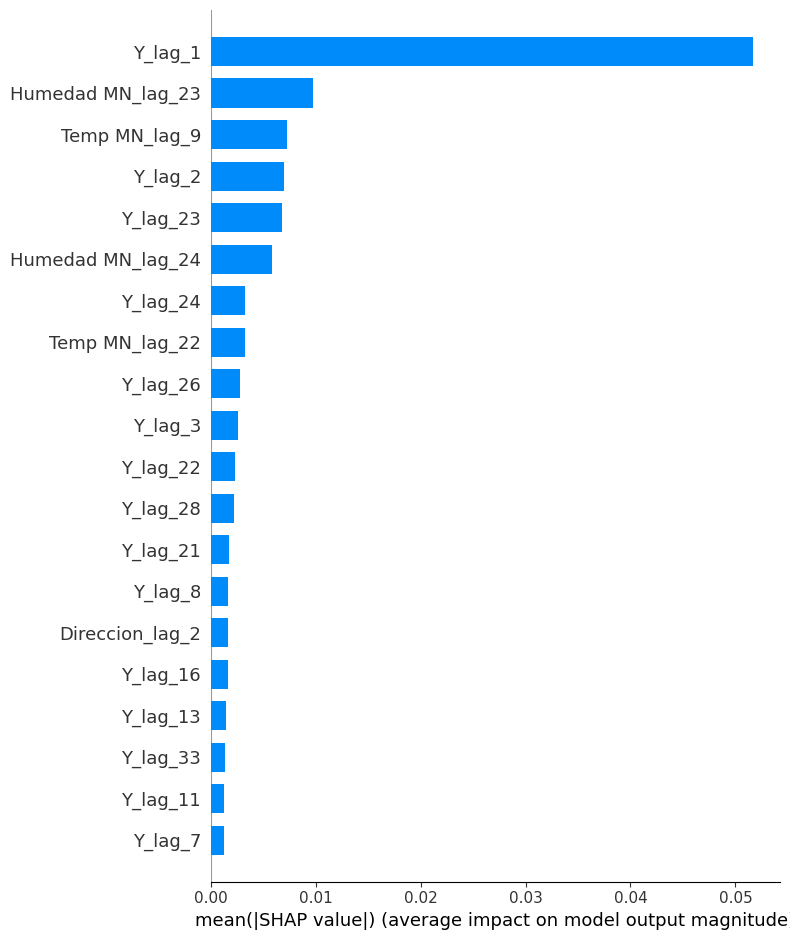

In [ ]:
shap.summary_plot(shap_values_loaded[:, :, 0], X_test_sample, feature_names=feature_names, plot_type="bar")


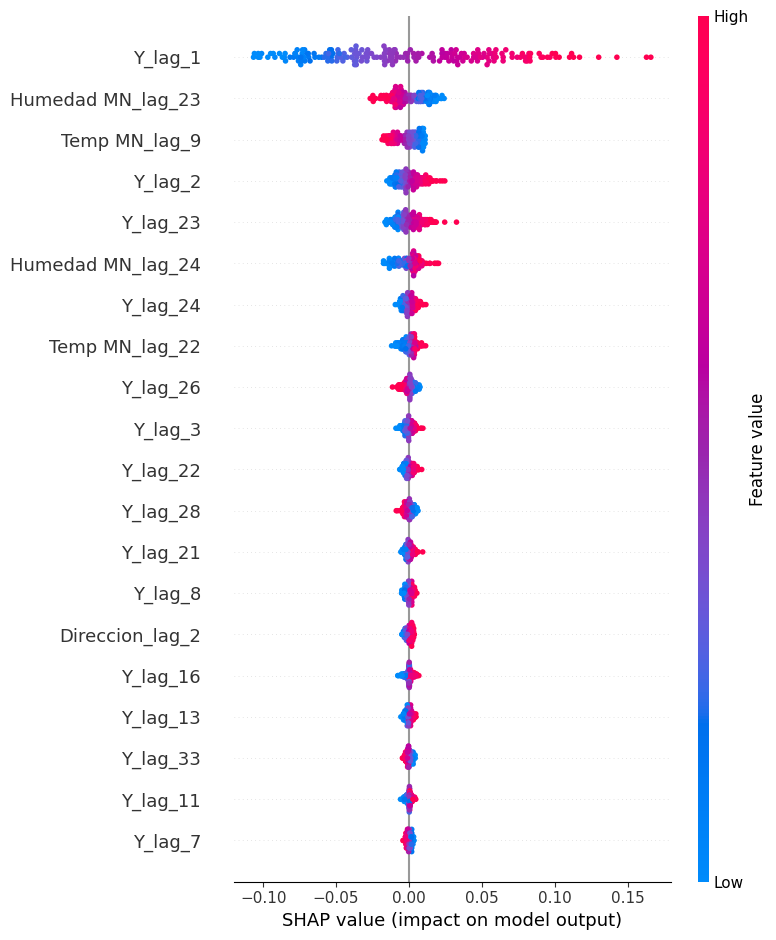

In [ ]:
shap.summary_plot(shap_values_loaded[:,:,0], X_test_sample, feature_names=feature_names)

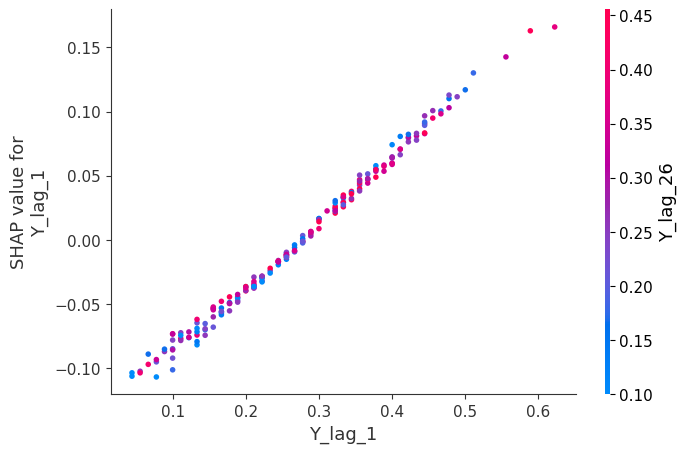

In [ ]:
shap.dependence_plot(
    "Y_lag_1",  # Nombre de la característica
    shap_values_loaded[:,:,0],
    X_test_sample,
    feature_names=feature_names
)


## LIME

In [ ]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=a39703d5b23884145c4481d9570d70e7832432c725c8304688644d8e6084d621
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from lime import lime_tabular

# Utilizamos X_train y X_test originales en 2D para LIME
# Obtener nombres de características de las columnas de X_train
feature_names = data_lagged.drop(columns=['Velocidad']).columns

# Crear el explainer LIME usando X_train con nombres de variables originales
explainer = lime_tabular.LimeTabularExplainer(
    X_train,  # Conjunto de entrenamiento en 2D
    mode='regression',
    feature_names=feature_names,
    discretize_continuous=True
)

# Seleccionar una instancia de prueba para explicar (también en 2D)
instance = X_test[0]  # Selecciona la primera instancia de prueba

# Crear una función lambda que ajusta la instancia a 3D para la predicción
exp = explainer.explain_instance(
    instance,
    lambda x: model_bayesian_lstm.predict(x.reshape(x.shape[0], 1, x.shape[1])).flatten(),
    num_features=10
)

# Visualizar la explicación en el notebook
exp.show_in_notebook()


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


In [ ]:
exp = explainer.explain_instance(
    instance,
    lambda x: model_bayesian_lstm.predict(x.reshape(x.shape[0], 1, x.shape[1])).flatten(),
    num_features=5,   # Muestra solo las 5 características principales
    num_samples=5000  # Incrementa el número de permutaciones para mayor precisión
)
exp.show_in_notebook()


157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


In [54]:
from lime import lime_tabular
import numpy as np

# Obtener nombres de características
feature_names = data_lagged.drop(columns=['Velocidad']).columns

# Crear el explainer LIME
explainer = lime_tabular.LimeTabularExplainer(
    X_train,  # Conjunto de entrenamiento en 2D
    mode='regression',
    feature_names=feature_names,
    discretize_continuous=True
)

# Seleccionar una instancia de prueba para explicar
instance = X_test[0]  # Selecciona la primera instancia de prueba

# Función para desescalar las predicciones
def predict_descaled(x):
    # Realizar predicciones con el modelo en 3D
    preds_scaled = model_bayesian_lstm.predict(x.reshape(x.shape[0], 1, x.shape[1])).flatten()
    # Desescalar las predicciones
    preds_descaled = scaler_Y.inverse_transform(preds_scaled.reshape(-1, 1)).flatten()
    return preds_descaled

# Generar la explicación de LIME con predicciones desescaladas
exp = explainer.explain_instance(
    instance,
    predict_descaled,  # Usar la función desescalada para las predicciones
    num_features=10
)

# Visualizar la explicación
exp.show_in_notebook()


157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


In [65]:
# Guardar solo los pesos
model_bayesian_lstm.save_weights('model_bayesian_lstm.weights.h5')
print("Pesos del modelo guardados exitosamente.")

Pesos del modelo guardados exitosamente.


In [66]:
# Reconstruir el modelo
model_bayesian_lstm_loaded = create_bayesian_lstm(input_shape=(1, X_train.shape[1]))

# Cargar los pesos
model_bayesian_lstm_loaded.load_weights('model_bayesian_lstm.weights.h5')
print("Pesos cargados exitosamente.")


Pesos cargados exitosamente.


/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 12 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [72]:
import pickle

# Guardar el escalador Y
with open('scaler_Y.pkl', 'wb') as file:
    pickle.dump(scaler_Y, file)
print("Escalador guardado exitosamente.")


Escalador guardado exitosamente.


In [73]:
# Cargar el escalador Y
with open('scaler_Y.pkl', 'rb') as file:
    scaler_Y_loaded = pickle.load(file)
print("Escalador cargado exitosamente.")

Escalador cargado exitosamente.


In [78]:
# Guardar el conjunto X_test_sample
np.save('X_train.npy', X_train)

In [74]:
def predict_descaled(x):
    """
    Realiza predicciones con el modelo cargado y las desescala usando el escalador cargado.
    """
    # Realizar predicciones con el modelo
    preds_scaled = model_bayesian_lstm_loaded.predict(x.reshape(x.shape[0], 1, x.shape[1])).flatten()
    # Desescalar las predicciones
    preds_descaled = scaler_Y_loaded.inverse_transform(preds_scaled.reshape(-1, 1)).flatten()
    return preds_descaled


In [77]:
# Crear el explainer
explainer = lime_tabular.LimeTabularExplainer(
    X_train,  # Conjunto de entrenamiento
    mode='regression',
    feature_names=feature_names,
    discretize_continuous=True
)

# Seleccionar una instancia para explicar
instance = X_test_sample[0]

# Generar la explicación utilizando predicciones desescaladas
exp = explainer.explain_instance(
    instance,
    predict_descaled,  # Usar la función que desescala las predicciones
    num_features=10
)

# Visualizar la explicación
exp.show_in_notebook()


157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


In [ ]:
import pickle
import numpy as np

# Guardar los datos necesarios
np.save('X_train_lime.npy', X_train)
np.save('X_test_sample_lime.npy', X_test_sample)
np.save('feature_names_lime.npy', feature_names)

# Simular y guardar las predicciones del modelo (predictions_scaled)
predictions_scaled = model_bayesian_lstm.predict(X_test_sample.reshape(X_test_sample.shape[0], 1, X_test_sample.shape[1])).flatten()
predictions_scaled = scaler_Y.inverse_transform(predictions_scaled.reshape(-1, 1)).flatten()
np.save('predictions_scaled_lime.npy', predictions_scaled)

# Guardar la configuración del explainer
explainer_config = {
    'mode': 'regression',
    'discretize_continuous': True
}
with open('lime_explainer_config.pkl', 'wb') as file:
    pickle.dump(explainer_config, file)

# Guardar una explicación generada
exp = explainer.explain_instance(
    X_test_sample[0],  # Primera instancia del conjunto de prueba
    lambda x: model_bayesian_lstm.predict(x.reshape(x.shape[0], 1, x.shape[1])).flatten(),
    num_features=10
)
with open('lime_explanation_instance.pkl', 'wb') as file:
    pickle.dump(exp, file)

print("Todos los elementos necesarios han sido guardados.")


7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Todos los elementos necesarios han sido guardados.


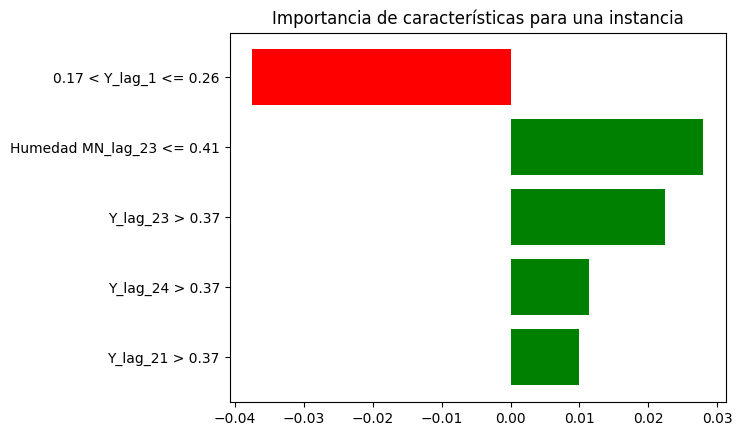

In [ ]:
import matplotlib.pyplot as plt

# Crear el gráfico de la explicación como una figura de matplotlib
fig = exp.as_pyplot_figure()
plt.title("Importancia de características para una instancia")
plt.show()


157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


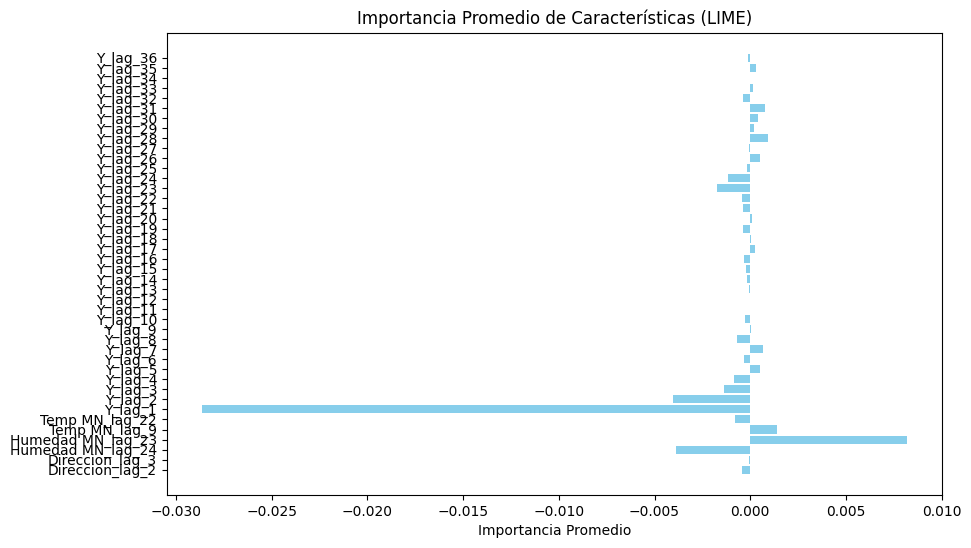

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Explicar múltiples instancias y acumular la importancia de las características
num_instances = 20  # Puedes ajustar este número según el análisis que desees hacer
feature_importances = np.zeros(len(feature_names))

for i in range(num_instances):
    exp = explainer.explain_instance(
        X_test[i],
        lambda x: model_bayesian_lstm.predict(x.reshape(x.shape[0], 1, x.shape[1])).flatten(),
        num_features=len(feature_names)
    )
    # Sumar las importancias de características para cada instancia
    for feature, importance in exp.as_list():
        # Separar el nombre de la característica, quitando el intervalo
        feature_base_name = feature.split(" <")[0]  # Extrae solo el nombre de la característica antes del delimitador "<"
        matching_features = [i for i, fname in enumerate(feature_names) if feature_base_name == fname]
        if matching_features:
            feature_index = matching_features[0]
            feature_importances[feature_index] += importance

# Calcular la importancia promedio de cada característica
average_importance = feature_importances / num_instances

# Visualizar la importancia promedio
plt.figure(figsize=(10, 6))
plt.barh(feature_names, average_importance, color="skyblue")
plt.xlabel("Importancia Promedio")
plt.title("Importancia Promedio de Características (LIME)")
plt.show()


157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


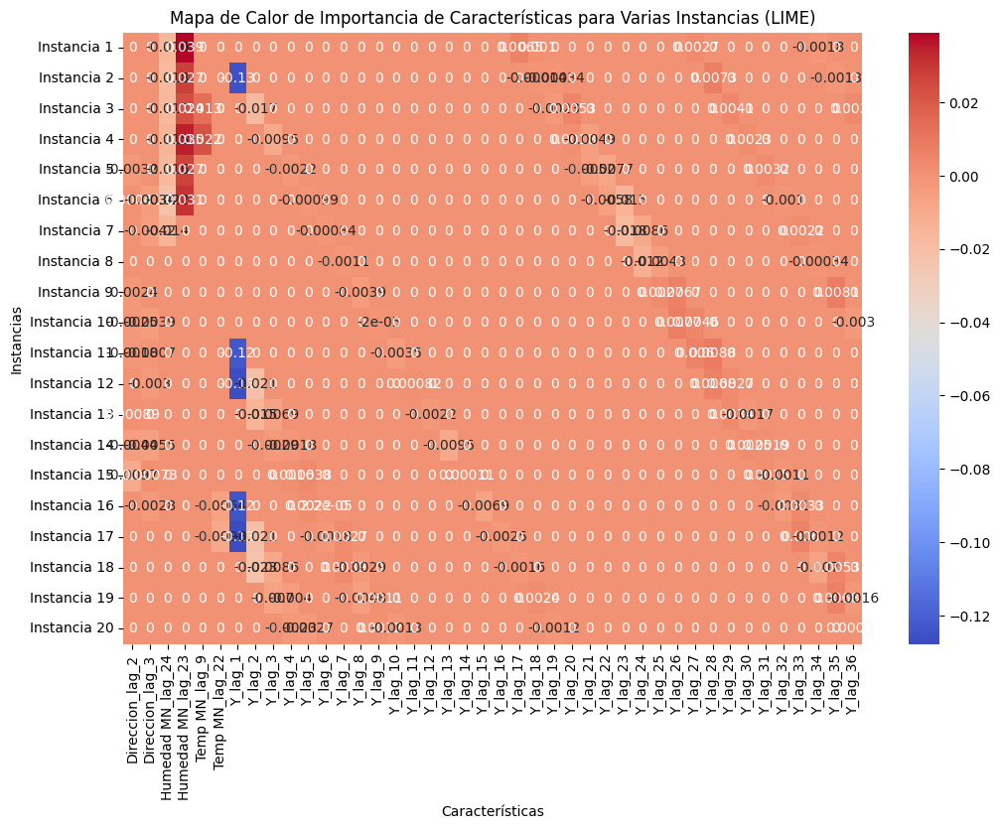

In [ ]:
import seaborn as sns

# Matriz de importancia: filas = instancias, columnas = características
num_instances = 20
feature_importance_matrix = np.zeros((num_instances, len(feature_names)))

for i in range(num_instances):
    exp = explainer.explain_instance(
        X_test[i],
        lambda x: model_bayesian_lstm.predict(x.reshape(x.shape[0], 1, x.shape[1])).flatten(),
        num_features=len(feature_names)
    )
    for feature, importance in exp.as_list():
        feature_base_name = feature.split(" <")[0]  # Extrae el nombre base
        matching_features = [j for j, fname in enumerate(feature_names) if feature_base_name == fname]
        if matching_features:
            feature_index = matching_features[0]
            feature_importance_matrix[i, feature_index] = importance

# Crear un mapa de calor
plt.figure(figsize=(12, 8))
sns.heatmap(feature_importance_matrix, annot=True, cmap="coolwarm", xticklabels=feature_names, yticklabels=[f"Instancia {i+1}" for i in range(num_instances)])
plt.xlabel("Características")
plt.ylabel("Instancias")
plt.title("Mapa de Calor de Importancia de Características para Varias Instancias (LIME)")
plt.show()


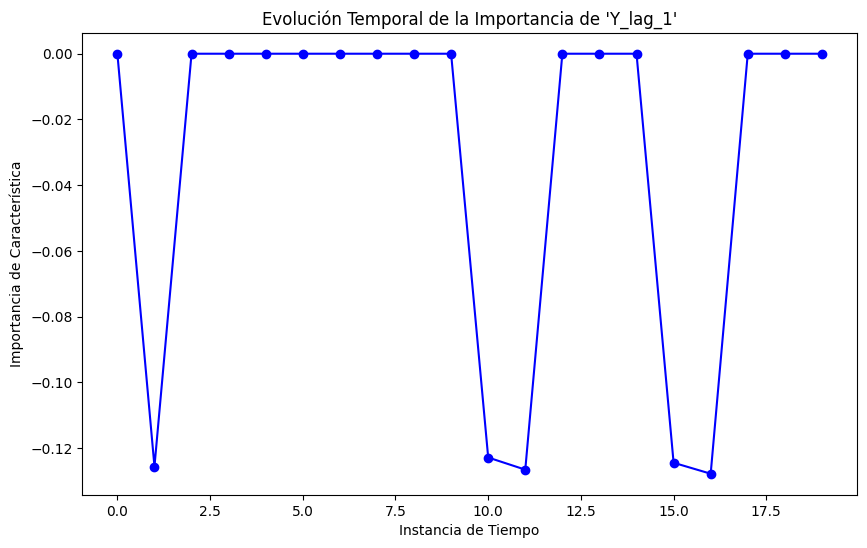

In [ ]:
# Asegurarte de convertir feature_names a una lista
feature_names_list = feature_names.tolist()

# Obtener el índice de la característica que deseas rastrear
feature_index_to_track = feature_names_list.index("Y_lag_1")  # Elige una característica específica

# Obtener la importancia de la característica en varias instancias
importance_over_time = feature_importance_matrix[:, feature_index_to_track]

# Graficar la importancia de la característica en el tiempo
plt.figure(figsize=(10, 6))
plt.plot(range(num_instances), importance_over_time, marker="o", color="b")
plt.xlabel("Instancia de Tiempo")
plt.ylabel("Importancia de Característica")
plt.title(f"Evolución Temporal de la Importancia de '{feature_names_list[feature_index_to_track]}'")
plt.show()


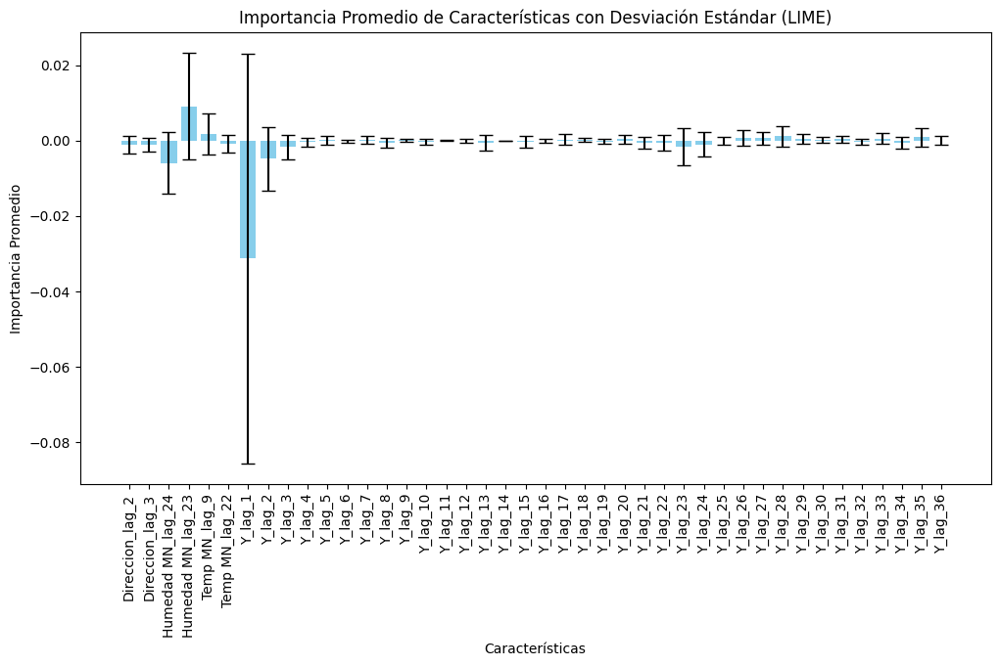

In [ ]:
# Calcular importancia promedio y desviación estándar
avg_importance = feature_importance_matrix.mean(axis=0)
std_importance = feature_importance_matrix.std(axis=0)

# Crear un gráfico de barras con error
plt.figure(figsize=(12, 6))
plt.bar(feature_names, avg_importance, yerr=std_importance, capsize=5, color="skyblue")
plt.xlabel("Características")
plt.ylabel("Importancia Promedio")
plt.title("Importancia Promedio de Características con Desviación Estándar (LIME)")
plt.xticks(rotation=90)
plt.show()


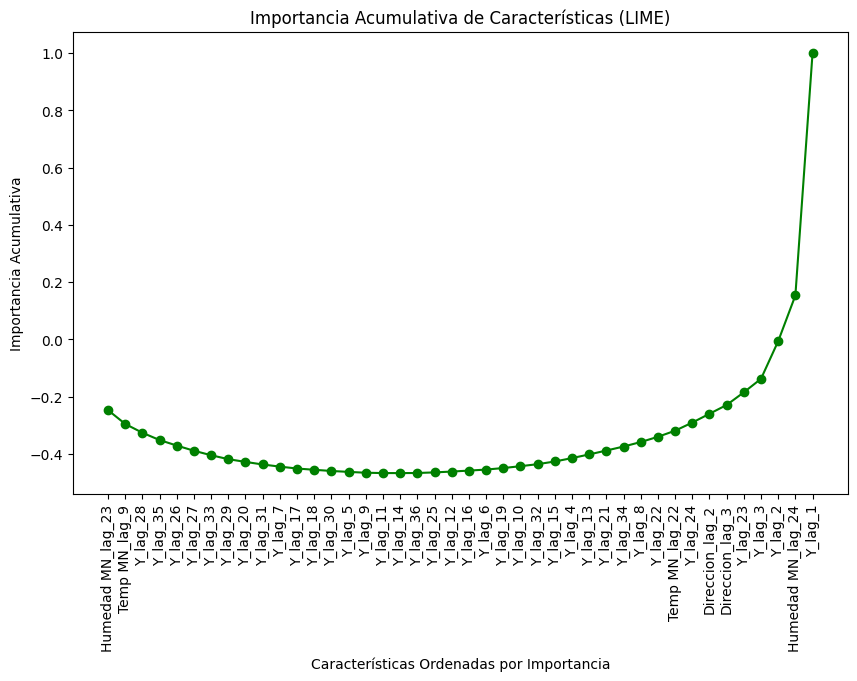

In [ ]:
# Ordenar las características por importancia promedio
sorted_indices = np.argsort(avg_importance)[::-1]
sorted_importance = avg_importance[sorted_indices]
sorted_feature_names = [feature_names[i] for i in sorted_indices]

# Calcular la importancia acumulativa
cumulative_importance = np.cumsum(sorted_importance) / np.sum(sorted_importance)

# Graficar la importancia acumulativa
plt.figure(figsize=(10, 6))
plt.plot(sorted_feature_names, cumulative_importance, marker="o", color="g")
plt.xlabel("Características Ordenadas por Importancia")
plt.ylabel("Importancia Acumulativa")
plt.title("Importancia Acumulativa de Características (LIME)")
plt.xticks(rotation=90)
plt.show()
